In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import gym
import pygame
from algorithms.rl import RL
from algorithms.planner import Planner
from examples.test_env import TestEnv
from examples.grid_search import GridSearch
from examples.blackjack import Blackjack
from examples.plots import Plots
import seaborn as sns
import itertools
import time
import random
import warnings
warnings.filterwarnings("ignore")

## Model-based learning: Value Iteration and Policy Iteration

In [2]:
def rl_train(mdp_problem, algorithm='Value Iteration', params={'n_iters': 1000}):
    if algorithm == 'Value Iteration':
        random.seed(200)
        V, V_track, pi = Planner(mdp_problem.P).value_iteration(**params)
        return V, V_track, pi
    elif algorithm == 'Policy Iteration':
        random.seed(200)
        V, V_track, pi = Planner(mdp_problem.P).policy_iteration(**params)
        return V, V_track, pi
    return None


def get_reward_simulation(mdp_problem, pi, simulations=50):
    test_scores = TestEnv.test_env(env=mdp_problem.env, render=False, user_input=False, pi=pi, n_iters=simulations, 
                                   convert_state_obs=mdp_problem.convert_state_obs)
    total_reward = np.sum(test_scores)
    performance_score = total_reward/simulations
#     TestEnv.test_env(env=blackjack.env, render=False, pi=pi, user_input=False,
#                                    convert_state_obs=blackjack.convert_state_obs, n_iters=simulations)
    return test_scores, total_reward, performance_score


def iterate_rl_train(mdp_problem, algorithm, train_iterations=1000, simulations=50, params=None):
    results = pd.DataFrame(columns=['iteration', 'simulations', 'total_reward', 'performance_score'])
    for n in range(1, train_iterations):
        result = {}
        result['iteration'] = n
        result['simulations'] = simulations
        if params==None:
            params = {'n_iters': n}
        else:
            params['n_iters'] = n
        # Train algorithm
        V, V_track, pi = rl_train(mdp_problem, algorithm, params)
        # Get reward over simulations
        if sum(V) == 0:  # Case when model has not converged yet
            result['total_reward'] = 0
            result['performance_score'] = 0
        else:
            result['total_reward'] = get_reward_simulation(mdp_problem, pi)
            result['performance_score'] = result['total_reward'] / simulations
        results = results._append(result, ignore_index=True)
    return results


def get_convergence_plot(V_track, V, problem_name, algorithm):
    V_track_avg = []
    trained_iterations = V_track.shape[0]
    for i in range(V_track.shape[0]):
        V_track_avg.append(np.average(V_track[i]))
    for i in range(V.shape[0]):
        comparison = V_track[i] == V
        equal_arrays = comparison.all()
        if equal_arrays:
            break
    print('Converged after %d episodes' % i)
    plt.plot(range(1, i+1, 1), V_track_avg[:i])
    plt.title(
        '%s - Convergence of V(s) using %s' % (problem_name, algorithm))
    plt.xlabel('episodes')
    plt.ylabel('V(s)')
    plt.show()


def get_policy_visual(pi):
    player_hands = []
    for i in range(4, 22, 1):
        player_hands.append('H'+str(i))
    for i in range(12, 22, 1):
        player_hands.append('S'+str(i))
    player_hands.append('BJ')
    action_dict = {0: 'stick', 1: 'hit'}
    action_digit_list = [[] for _ in range(29)]
    action_desc_list = [[] for _ in range(29)]

    for x in range(10):
        for y in range(29):
            i = x + y * 10
            action_digit_list[y].append(pi(i))
            action_desc_list[y].append(action_dict[pi(i)])
    df = pd.DataFrame(action_desc_list)
    df.columns = [2, 3, 4, 5, 6, 7, 8, 9, 'T', 'A']
    df.index = player_hands
    return df


def grid_values_heat_map(V, label):
    player_hands = []
    for i in range(4, 22, 1):
        player_hands.append('H'+str(i))
    for i in range(12, 22, 1):
        player_hands.append('S'+str(i))
    player_hands.append('BJ')

    x = 29
    y = 10
    data = np.around(np.array(V).reshape((x, y)), 2)
    df = pd.DataFrame(data=data)
    df.columns = [2, 3, 4, 5, 6, 7, 8, 9, 'T', 'A']
    df.index = player_hands
    sns.heatmap(df, annot=True, annot_kws={'fontsize': 6}).set_title(label)
    plt.show()
    


def get_result_rl_algo(problem_name, algorithm='Value Iteration', train_iterations=1000, simulations=50):
    print('\n%s - Algorithm: %s' % (problem_name, algorithm))
    # Define MDP problem
    blackjack = Blackjack()

    # # Not sure if I'm going to use  this section...
    # result = iterate_rl_train(mdp_problem,
    #                           algorithm,
    #                           train_iterations=train_iterations,
    #                           simulations=simulations)
    # plt.plot(result['iteration'], result['total_reward'])

    # Train algorithm
    params = {'n_iters': train_iterations}
    V, V_track, pi = rl_train(blackjack, algorithm, params)
    # Get reward over simulations
    test_scores, total_reward, performance_score = get_reward_simulation(blackjack, pi, simulations)
    # Get convergence plot
    get_convergence_plot(V_track, V, problem_name, algorithm)
    # Get state values
    grid_values_heat_map(V, "State Values")
    df = get_policy_visual(pi)
    print(df)
    print('Total rewards over %d simulations: %d (%.0f%%)' % (simulations, total_reward, performance_score*100))
    print(test_scores)
    return V, V_track, pi, total_reward, performance_score, test_scores


Blackjack-v1 - Algorithm: Value Iteration
Converged after 12 episodes


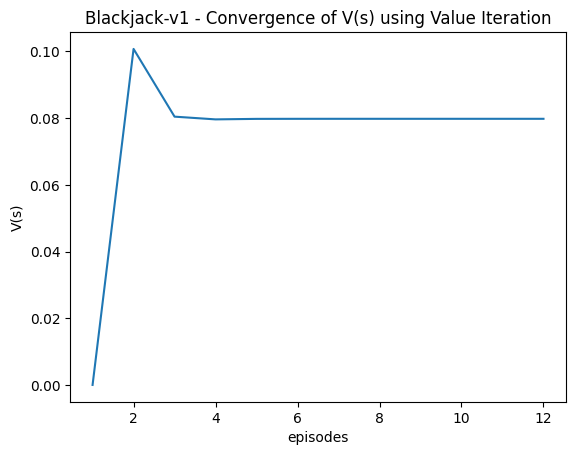

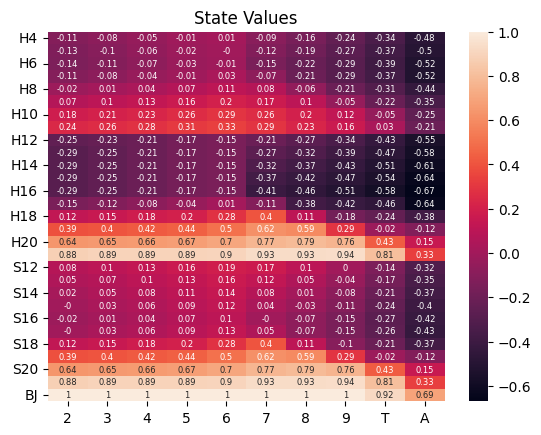

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H13  stick  stick  stick  stick  stick    hit    hit    hit    hit    hit
H14  stick  stick  stick  stick  stick    hit    hit    hit    hit    hit
H15  stick  stick  stick  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick  stick  stick  stick

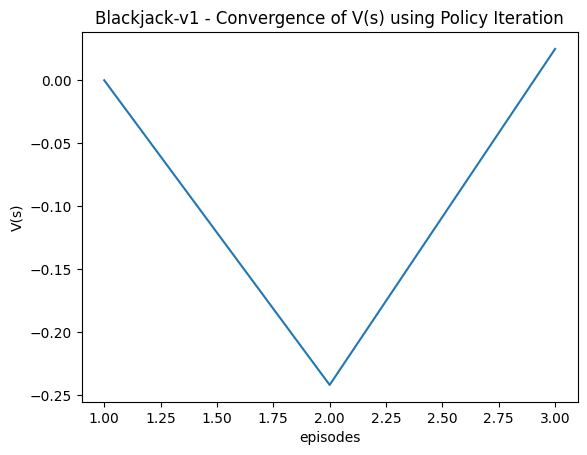

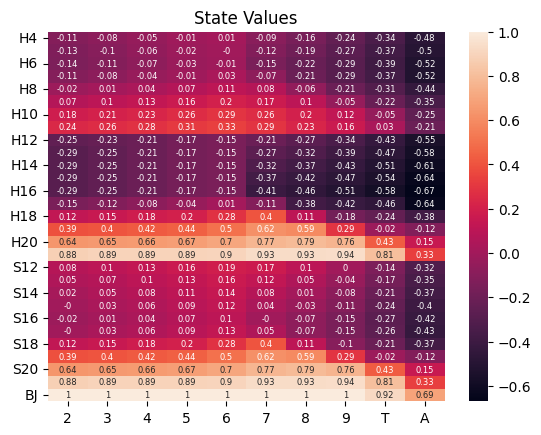

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H13  stick  stick  stick  stick  stick    hit    hit    hit    hit    hit
H14  stick  stick  stick  stick  stick    hit    hit    hit    hit    hit
H15  stick  stick  stick  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick  stick  stick  stick

In [3]:
# Declare variables unique to MDP problem
PROBLEM_NAME = 'Blackjack-v1'
ALGORITHMS = ['Value Iteration', 'Policy Iteration']
TRAIN_ITERATIONS = 1000
SIMULATIONS = 200

for algorithm in ALGORITHMS:
    get_result_rl_algo(problem_name=PROBLEM_NAME, 
                       algorithm=algorithm, 
                       train_iterations=TRAIN_ITERATIONS, 
                       simulations=SIMULATIONS)

## Model-free learner: Q-learning

In [4]:
EPSILON_DECAY = [.4, .7, .9]
ITERS = [500, 1000, 2000, 3000, 4000, 5000, 6000, 7000]

In [5]:
def get_convergence_plot_qlearn(Q_track, problem_name, algorithm):
    Q_track_avg = []
    trained_iterations = Q_track.shape[0]
    for i in range(Q_track.shape[0]):
        Q_track_avg.append(np.average(Q_track[i]))
    plt.plot(range(trained_iterations), Q_track_avg[:trained_iterations])
    plt.title(
        '%s - Convergence of Q(s) using %s' % (problem_name, algorithm))
    plt.xlabel('episodes')
    plt.ylabel('Q(s)')
    plt.show()

def get_result_q_learning_algo(problem_name, epsilon, n_episode, simulations, algorithm='Q-Learning'):
    print('\n%s - Algorithm: %s' % (problem_name, algorithm))
    print("running -- with epsilon decay: ", epsilon, " episodes: ", n_episode)
    # Define MDP problem
    blackjack = Blackjack()
    
    start = time.time()
    # Train Q-learner
    np.random.seed(200)
    Q, V, pi, Q_track, pi_track = RL(blackjack.env).q_learning(blackjack.n_states, blackjack.n_actions, 
                                                               blackjack.convert_state_obs,
                                                               epsilon_decay_ratio=epsilon, n_episodes=n_episode)
    end = time.time()
    if np.sum(V) > 0:
        # Get reward over simulations
        test_scores, total_reward, performance_score = get_reward_simulation(blackjack, pi, simulations)
    else:
        test_scores, total_reward, performance_score = [], 0, 0
#         test_scores = []
#         total_reward = 0
#         performance_score = 0
    # Get convergence plot
    get_convergence_plot_qlearn(Q_track, problem_name, algorithm)
    # Get state values
    grid_values_heat_map(V, "State Values")
    df = get_policy_visual(pi)
    print(df)
    print('Total rewards over %d simulations: %d (%.0f%%)' % (simulations, total_reward, performance_score*100))
    run_time = end - start
    result = {}
    result['epsilon'] = epsilon
    result['n_episodes'] = n_episode
    result['total_reward'] = total_reward
    result['simulations'] = simulations
    result['performance_score'] = performance_score
    result['run_time'] = run_time
    return Q, V, pi, Q_track, pi_track, result

def grid_search_q_learn(problem_name, epsilons, n_episodes, simulations, algorithm='Q-Learning'):
    result_df = pd.DataFrame(columns=['epsilon', 'n_episodes', 'total_reward', 'simulations', 'performance_score', 'run_time'])
    for grid in itertools.product(epsilons, n_episodes):
        epsilon = grid[0]
        n_episode = grid[1]
        _, _, _, _, _, result = get_result_q_learning_algo(problem_name, 
                                                           epsilon,  
                                                           n_episode,  
                                                           simulations,  
                                                           algorithm='Q-Learning')
        result_df = result_df._append(result, ignore_index=True)
    return result_df


Blackjack-v1 - Algorithm: Q-Learning
running -- with epsilon decay:  0.4  episodes:  500


runtime = 0.09 seconds


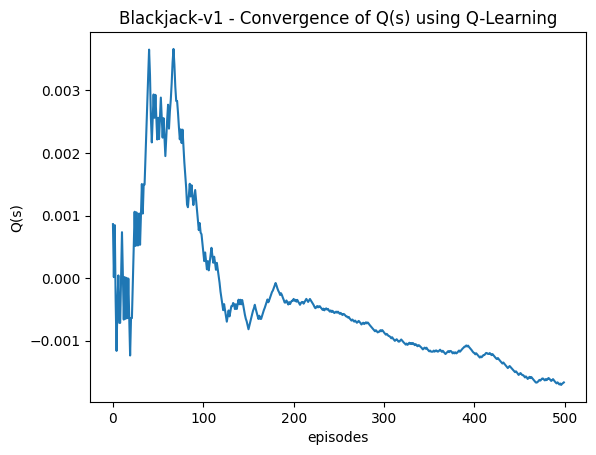

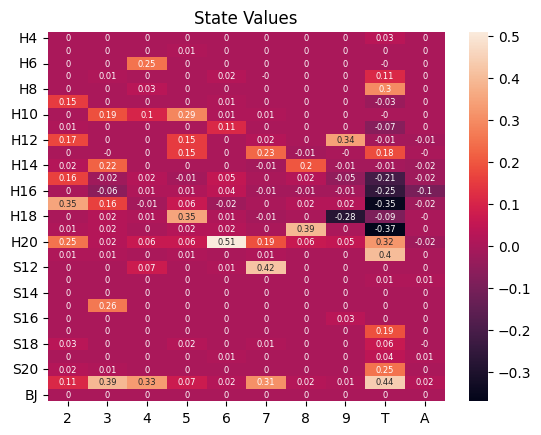

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick  stick  stick  stick  stick
H5   stick  stick  stick    hit    hit  stick  stick  stick    hit    hit
H6   stick  stick  stick  stick    hit  stick  stick  stick    hit  stick
H7     hit  stick  stick  stick  stick    hit  stick  stick  stick    hit
H8   stick    hit  stick    hit  stick  stick  stick    hit  stick    hit
H9   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10  stick  stick  stick  stick  stick  stick  stick    hit    hit    hit
H11    hit  stick  stick    hit  stick    hit  stick    hit    hit    hit
H12  stick    hit    hit  stick  stick  stick  stick  stick    hit    hit
H13    hit    hit    hit  stick    hit  stick    hit    hit  stick    hit
H14  stick  stick  stick    hit    hit    hit  stick    hit    hit    hit
H15  stick    hit  stick    hit  stick    hit  stick    hit    hit    hit
H16    hit    hit  stick  stick  stick

runtime = 0.22 seconds


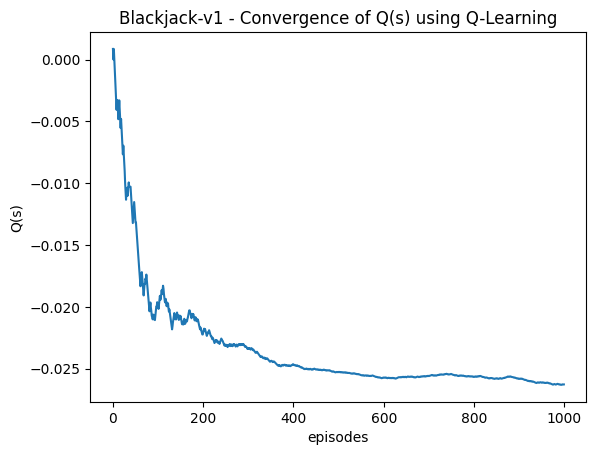

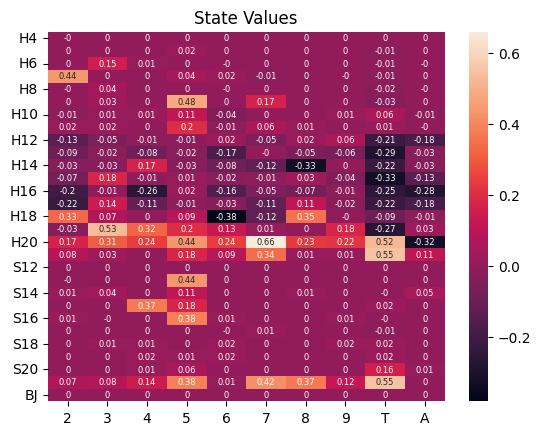

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit  stick    hit  stick  stick  stick  stick
H5     hit    hit  stick    hit  stick  stick  stick  stick    hit  stick
H6     hit  stick  stick  stick    hit  stick  stick    hit    hit    hit
H7   stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H8     hit  stick    hit    hit    hit  stick    hit    hit    hit    hit
H9     hit    hit    hit  stick  stick  stick    hit    hit    hit    hit
H10    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H11  stick  stick    hit  stick    hit  stick    hit    hit    hit    hit
H12    hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit  stick  stick    hit
H14  stick    hit  stick    hit  stick    hit    hit    hit  stick    hit
H15    hit  stick  stick  stick    hit    hit  stick    hit    hit    hit
H16    hit    hit    hit  stick    hit

runtime = 0.37 seconds


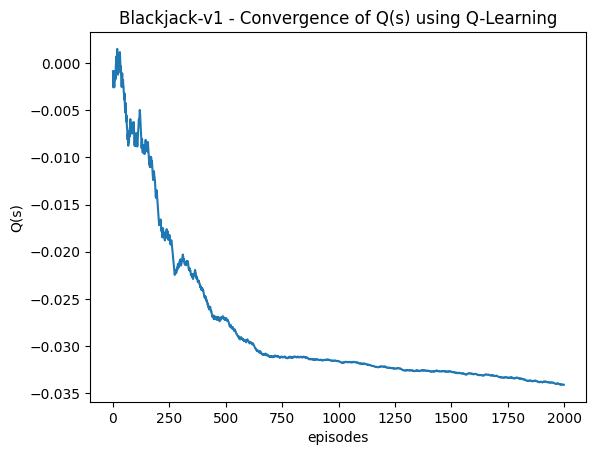

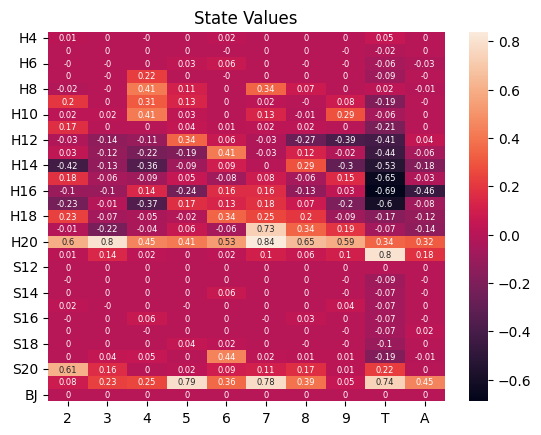

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit    hit  stick  stick    hit    hit  stick    hit
H5     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit    hit    hit    hit    hit  stick    hit
H8     hit    hit  stick    hit    hit  stick    hit    hit  stick    hit
H9   stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit    hit    hit    hit  stick    hit    hit
H11  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick  stick    hit  stick    hit    hit  stick
H13  stick    hit    hit  stick  stick    hit  stick    hit    hit    hit
H14    hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H15  stick    hit    hit  stick    hit    hit  stick  stick    hit    hit
H16    hit    hit  stick  stick  stick

runtime = 0.57 seconds


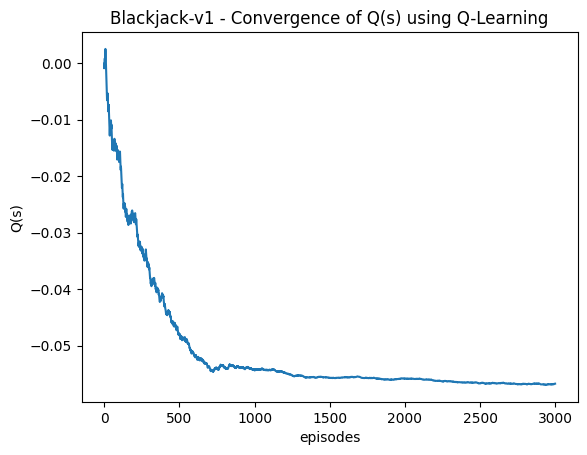

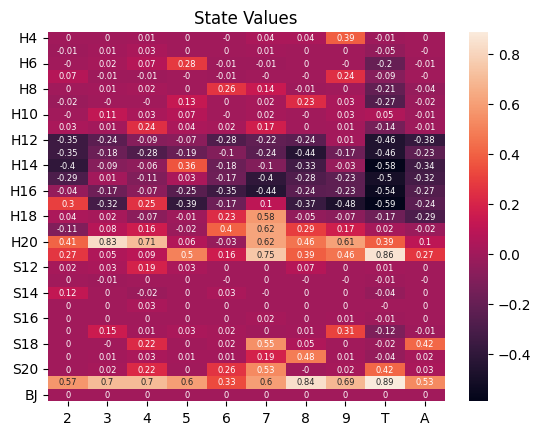

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit    hit  stick  stick  stick    hit  stick
H5     hit  stick  stick    hit  stick  stick  stick    hit    hit    hit
H6     hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H7   stick    hit    hit    hit    hit    hit    hit  stick  stick    hit
H8     hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H10    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit  stick  stick    hit    hit    hit    hit  stick    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H13  stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick  stick  stick    hit  stick    hit    hit  stick
H15    hit  stick    hit  stick    hit    hit    hit    hit  stick  stick
H16  stick    hit  stick    hit    hit

runtime = 0.74 seconds


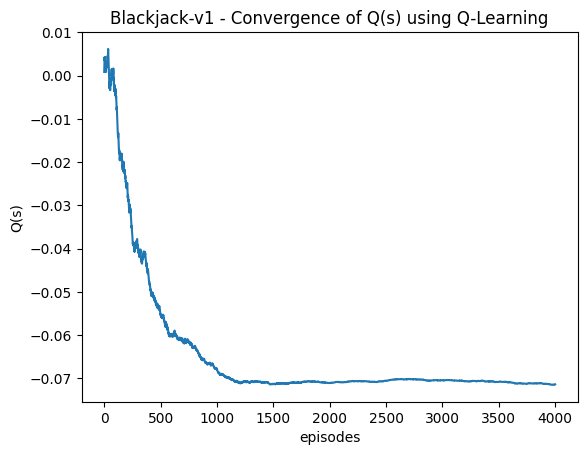

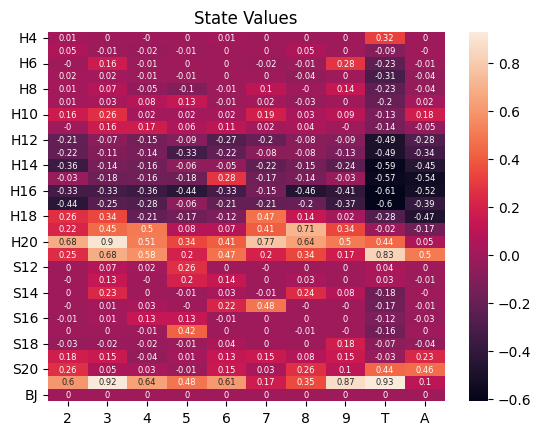

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit    hit  stick    hit    hit    hit  stick  stick
H5   stick    hit    hit    hit    hit    hit  stick    hit    hit    hit
H6     hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H7     hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H9     hit    hit    hit  stick    hit    hit    hit    hit    hit  stick
H10  stick    hit    hit    hit    hit  stick    hit    hit    hit  stick
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit  stick    hit  stick    hit    hit    hit  stick    hit    hit
H13    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H14  stick  stick    hit  stick  stick    hit    hit    hit  stick    hit
H15  stick    hit  stick  stick  stick  stick    hit    hit  stick  stick
H16  stick  stick    hit  stick  stick

runtime = 0.89 seconds


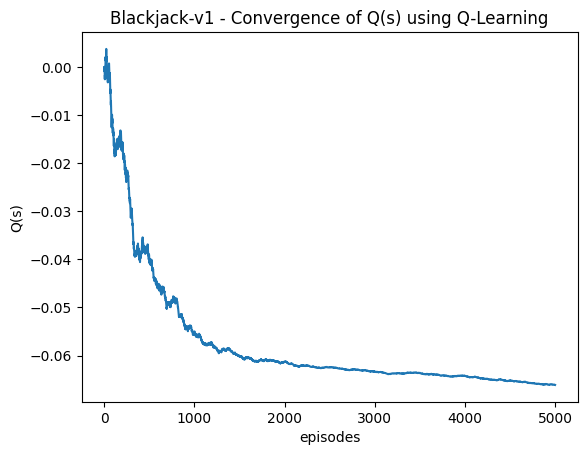

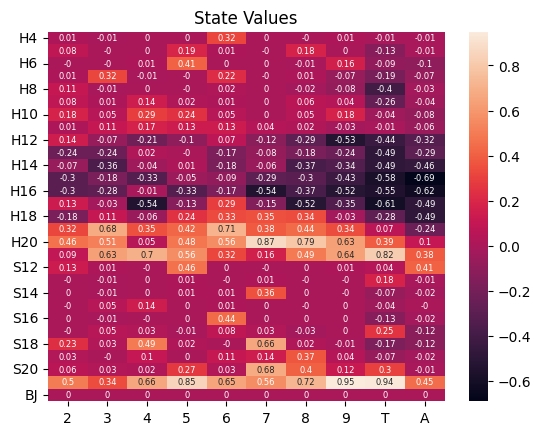

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit    hit  stick  stick    hit  stick    hit    hit
H5     hit    hit    hit  stick    hit    hit  stick  stick  stick    hit
H6     hit    hit    hit  stick    hit    hit    hit  stick    hit    hit
H7     hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H11    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit    hit    hit    hit  stick    hit    hit
H13    hit  stick  stick    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit  stick  stick  stick  stick    hit  stick  stick
H15    hit  stick  stick    hit  stick    hit    hit  stick    hit  stick
H16    hit  stick    hit  stick  stick

runtime = 1.91 seconds


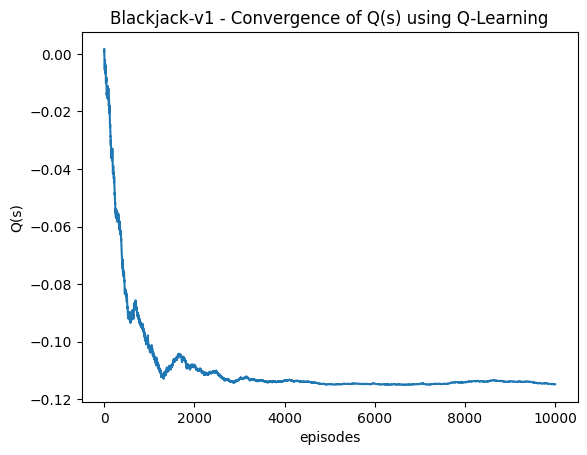

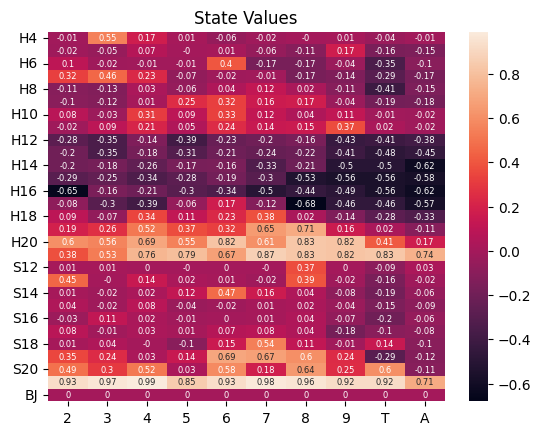

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H5     hit    hit  stick    hit    hit    hit    hit  stick    hit    hit
H6   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7   stick  stick  stick    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H14  stick  stick  stick  stick  stick    hit    hit  stick    hit    hit
H15  stick  stick    hit  stick  stick    hit    hit    hit    hit    hit
H16    hit  stick    hit  stick  stick

runtime = 6.55 seconds


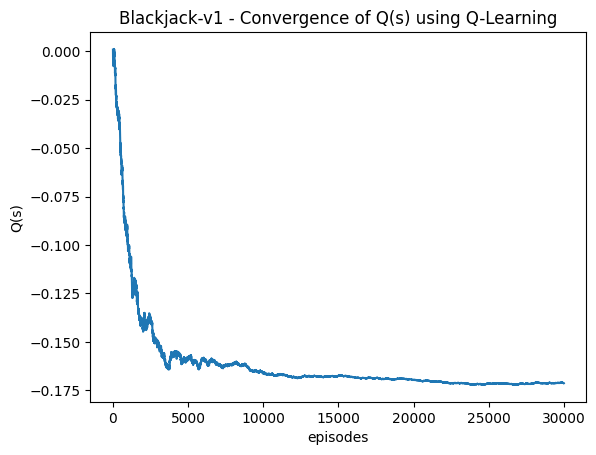

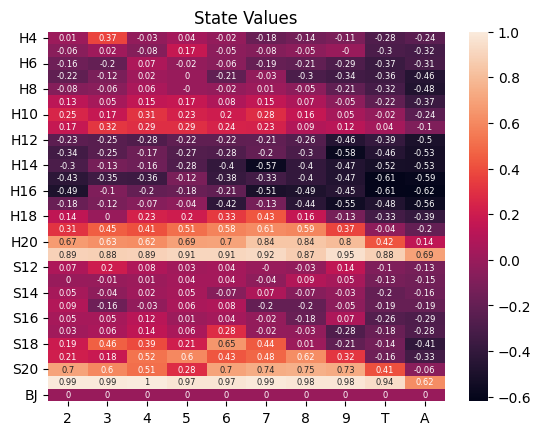

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H13    hit  stick  stick    hit    hit    hit  stick  stick    hit    hit
H14  stick  stick  stick    hit    hit  stick    hit    hit    hit    hit
H15    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H16    hit  stick  stick  stick  stick

runtime = 11.46 seconds


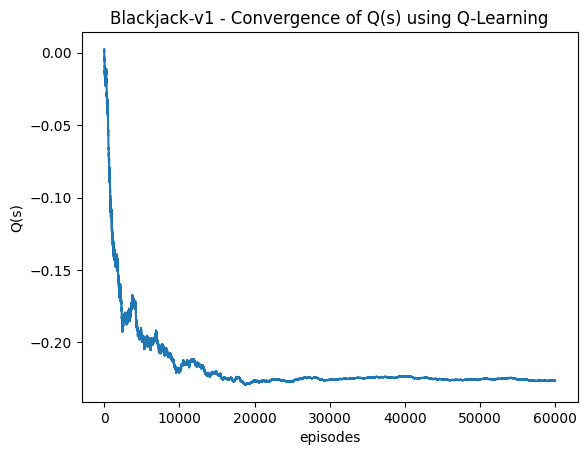

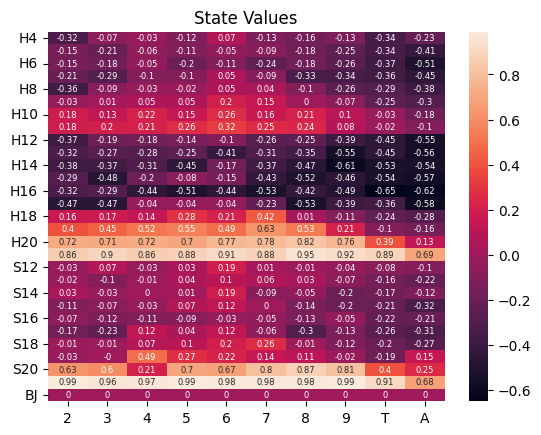

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H13  stick  stick    hit    hit    hit    hit    hit  stick    hit    hit
H14    hit  stick    hit    hit  stick    hit    hit  stick    hit    hit
H15  stick    hit  stick  stick  stick    hit  stick    hit    hit    hit
H16  stick  stick    hit    hit    hit

runtime = 17.42 seconds


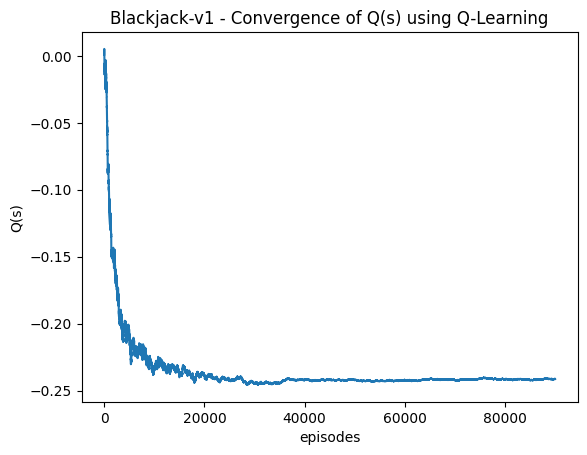

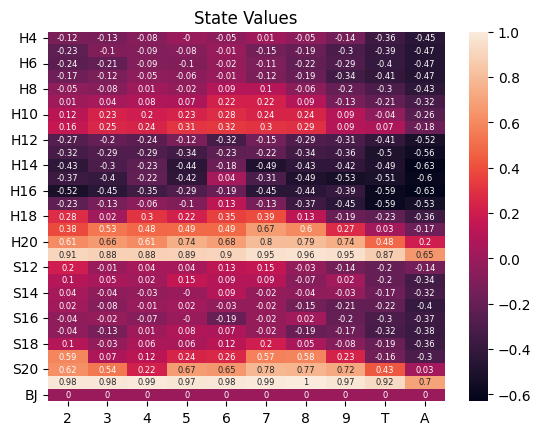

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit  stick  stick    hit  stick  stick    hit    hit    hit    hit
H15    hit    hit  stick    hit  stick    hit    hit  stick    hit    hit
H16    hit    hit  stick  stick  stick

runtime = 0.11 seconds


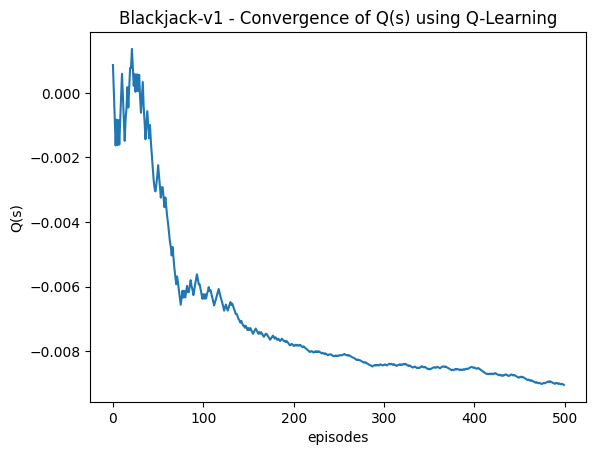

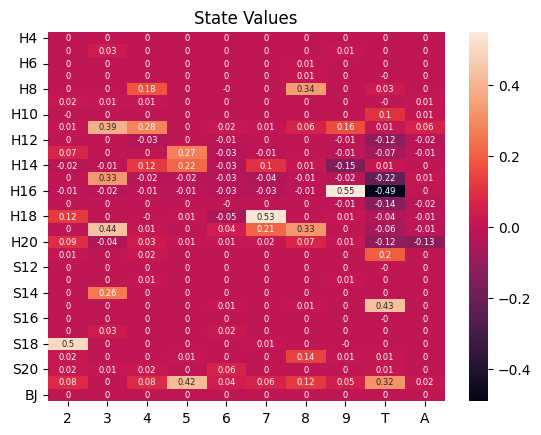

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick  stick  stick  stick  stick  stick  stick
H5   stick  stick    hit  stick  stick  stick  stick  stick  stick  stick
H6   stick    hit  stick  stick  stick  stick  stick    hit    hit    hit
H7     hit  stick    hit    hit    hit  stick  stick  stick    hit    hit
H8   stick  stick  stick    hit    hit    hit  stick    hit  stick  stick
H9     hit  stick  stick  stick  stick    hit    hit    hit    hit  stick
H10    hit  stick    hit    hit    hit    hit    hit    hit  stick  stick
H11  stick  stick  stick  stick  stick    hit  stick  stick    hit  stick
H12    hit  stick    hit    hit    hit    hit    hit    hit    hit  stick
H13  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick    hit  stick  stick    hit  stick    hit    hit  stick  stick
H15    hit  stick    hit    hit    hit  stick    hit    hit    hit  stick
H16  stick    hit    hit    hit    hit

runtime = 0.17 seconds


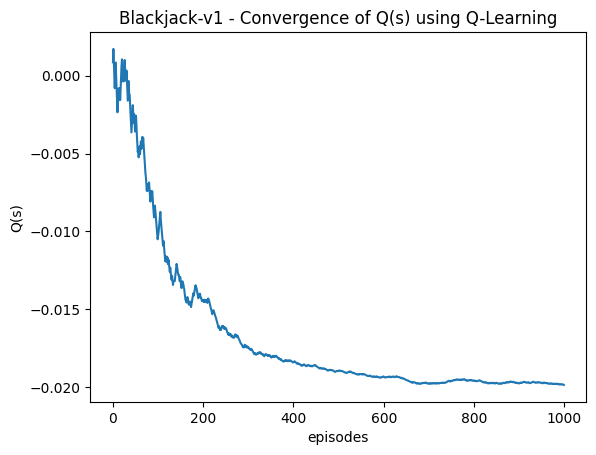

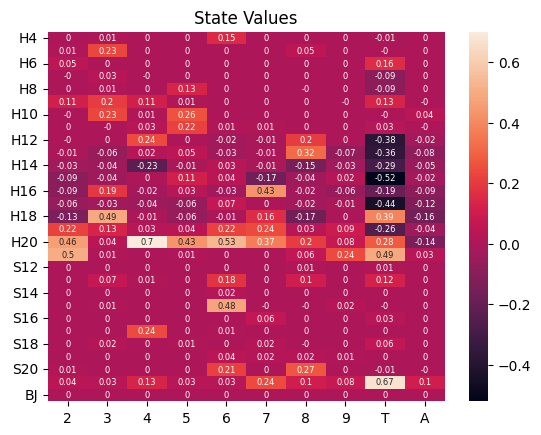

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick  stick  stick  stick  stick    hit    hit
H5   stick  stick  stick  stick  stick  stick  stick  stick    hit    hit
H6   stick  stick    hit    hit    hit    hit  stick    hit  stick  stick
H7     hit  stick    hit    hit  stick    hit    hit    hit    hit  stick
H8     hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H9   stick  stick  stick  stick    hit    hit    hit    hit    hit    hit
H10    hit  stick    hit  stick  stick    hit    hit    hit    hit  stick
H11  stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit  stick    hit    hit    hit
H13    hit  stick  stick  stick  stick    hit  stick    hit    hit    hit
H14    hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H15    hit    hit    hit  stick  stick    hit    hit  stick    hit    hit
H16    hit  stick  stick  stick    hit

runtime = 0.36 seconds


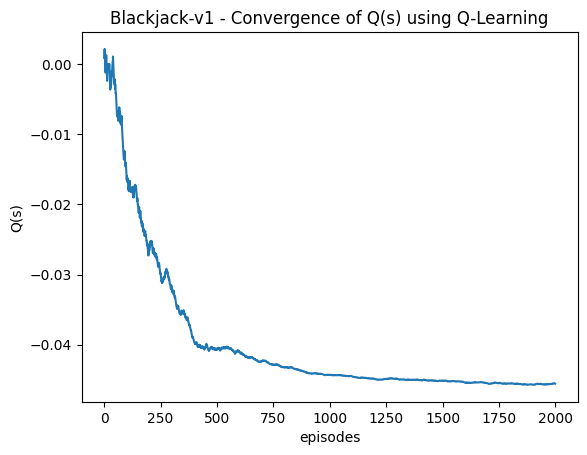

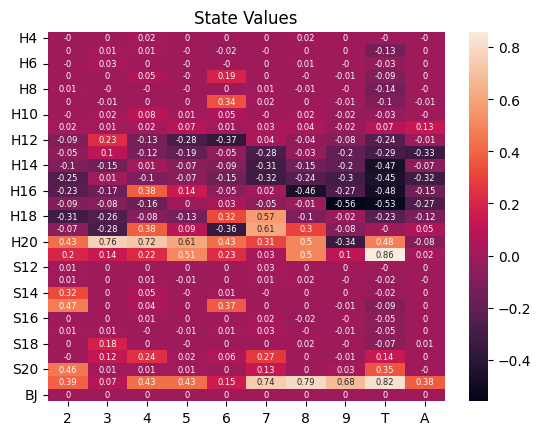

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick    hit    hit    hit  stick  stick    hit    hit
H5   stick    hit  stick    hit    hit    hit    hit  stick    hit    hit
H6     hit  stick    hit    hit    hit    hit  stick    hit    hit  stick
H7     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H11  stick    hit    hit    hit    hit    hit    hit    hit    hit  stick
H12    hit  stick  stick    hit  stick  stick    hit  stick  stick  stick
H13    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick    hit    hit    hit  stick  stick    hit    hit
H15    hit    hit    hit    hit    hit    hit    hit    hit  stick  stick
H16    hit    hit  stick  stick    hit

runtime = 0.54 seconds


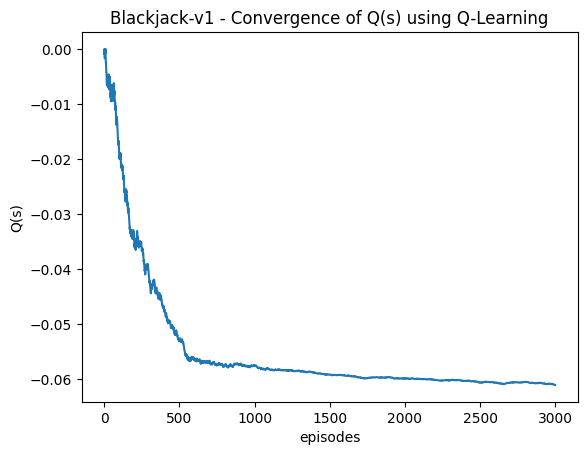

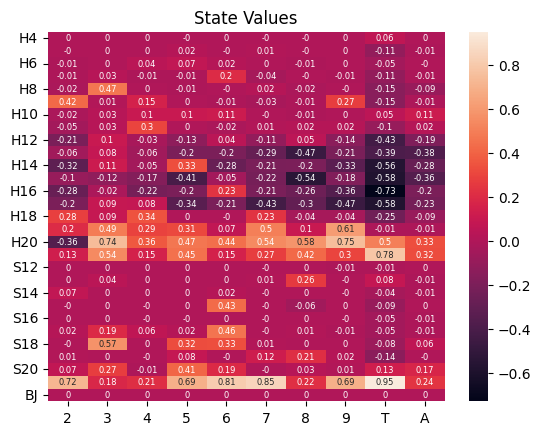

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit  stick    hit    hit    hit  stick    hit
H5     hit    hit  stick  stick    hit  stick    hit    hit    hit    hit
H6     hit    hit  stick  stick  stick  stick    hit    hit    hit    hit
H7     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit  stick    hit    hit    hit  stick    hit    hit    hit    hit
H9   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H11    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick  stick    hit    hit    hit  stick    hit
H13    hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H14  stick    hit  stick  stick  stick    hit    hit    hit    hit    hit
H15  stick    hit    hit    hit  stick    hit  stick    hit    hit    hit
H16    hit    hit  stick  stick  stick

runtime = 0.70 seconds


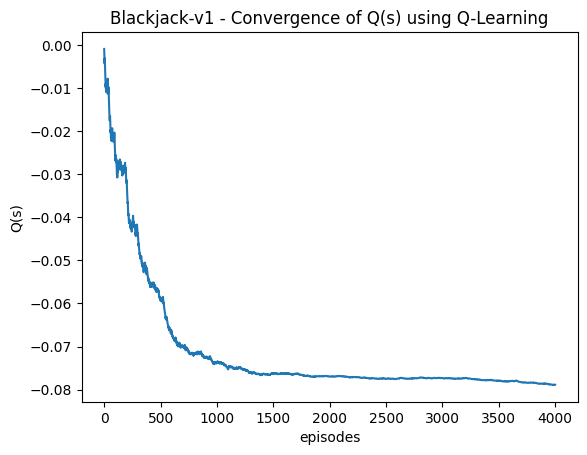

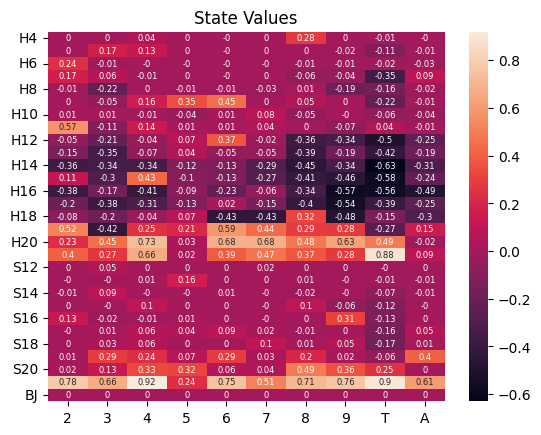

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick    hit    hit    hit  stick  stick    hit    hit
H5     hit  stick  stick    hit    hit    hit    hit    hit    hit    hit
H6   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7   stick  stick    hit    hit    hit    hit    hit    hit    hit  stick
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H11  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit  stick  stick  stick  stick    hit    hit    hit    hit  stick
H13    hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H14  stick  stick    hit  stick    hit  stick  stick    hit  stick    hit
H15  stick  stick  stick  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick    hit  stick  stick

runtime = 0.88 seconds


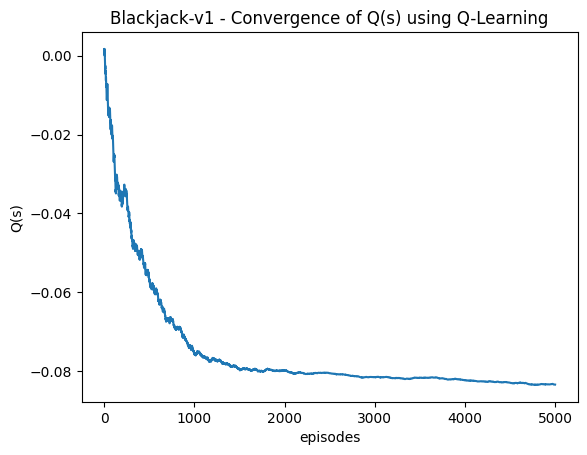

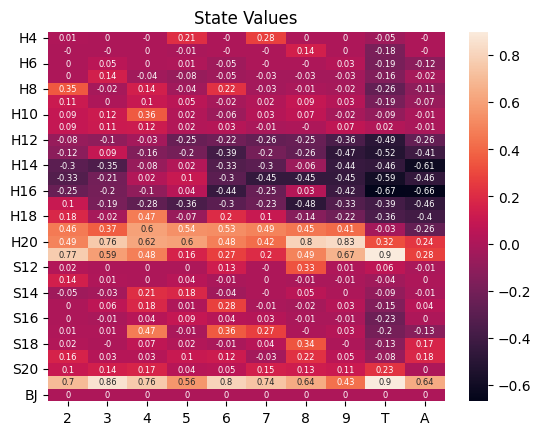

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick    hit  stick  stick    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H6     hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8   stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H10    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit    hit  stick
H14    hit    hit  stick  stick  stick  stick  stick    hit  stick    hit
H15  stick    hit  stick  stick  stick    hit  stick    hit  stick    hit
H16    hit    hit  stick  stick  stick

runtime = 1.80 seconds


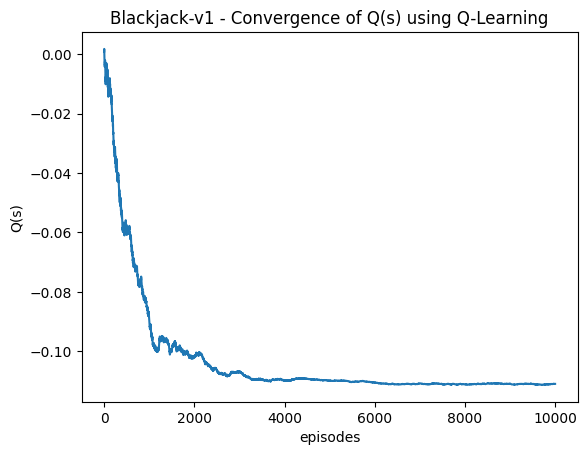

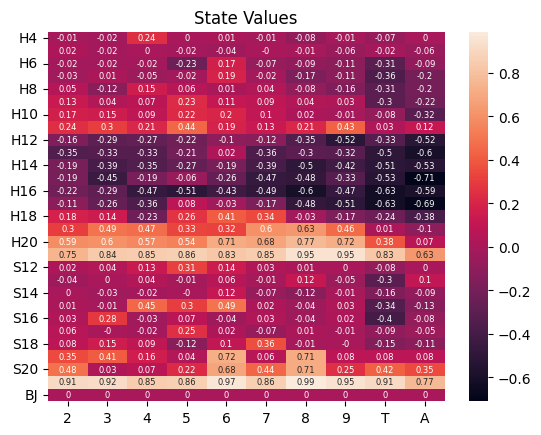

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit  stick    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit    hit  stick    hit
H14  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15  stick  stick  stick  stick    hit    hit  stick    hit  stick    hit
H16  stick  stick    hit    hit    hit

runtime = 5.57 seconds


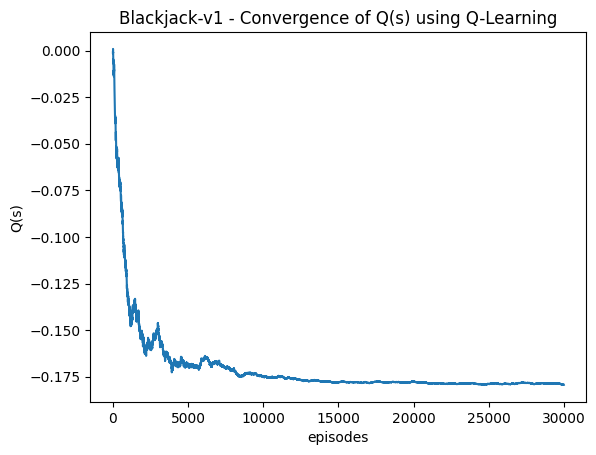

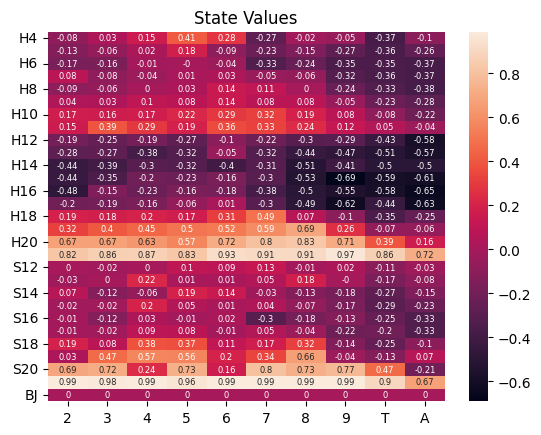

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick  stick    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit  stick    hit    hit  stick    hit    hit
H14  stick    hit    hit    hit    hit  stick  stick    hit    hit    hit
H15    hit    hit  stick  stick  stick    hit  stick  stick    hit    hit
H16    hit  stick  stick  stick  stick

runtime = 11.34 seconds


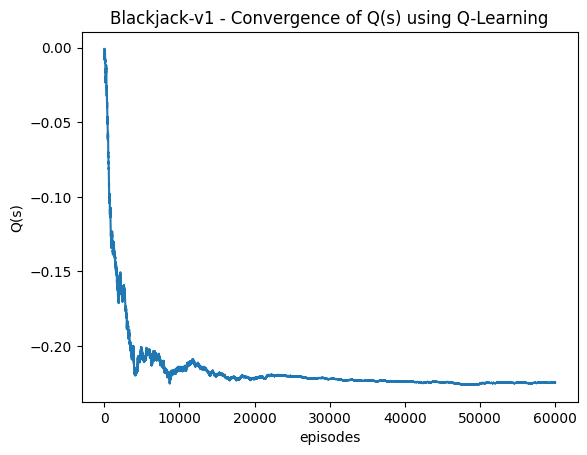

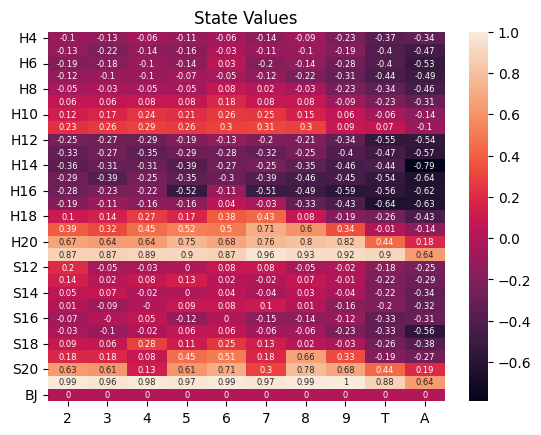

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit  stick    hit  stick
H15  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H16  stick  stick  stick    hit  stick

runtime = 16.94 seconds


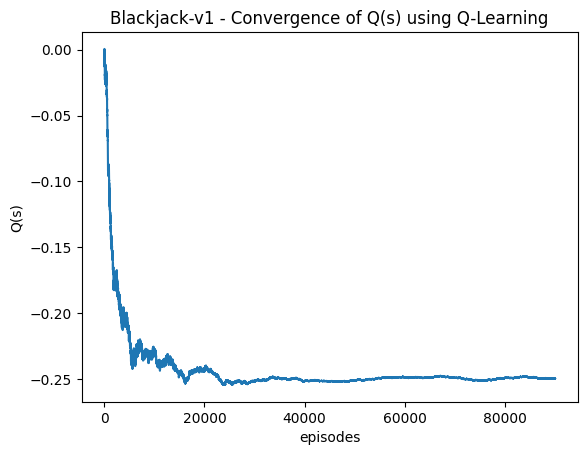

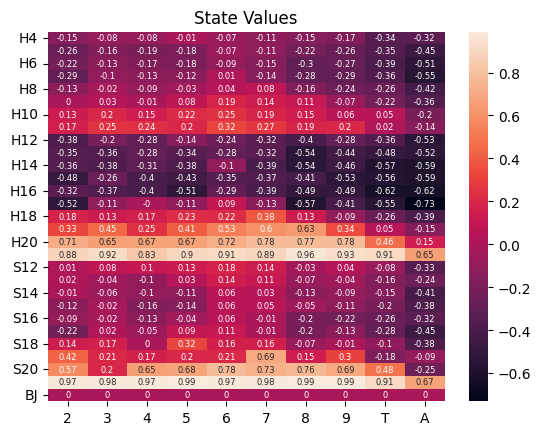

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H14    hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H15    hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H16  stick  stick    hit    hit  stick

runtime = 0.10 seconds


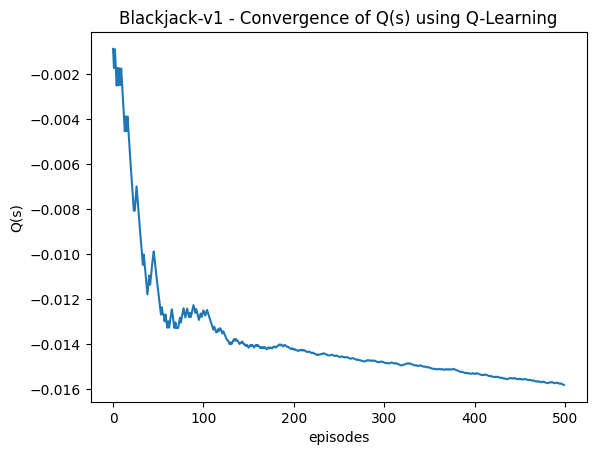

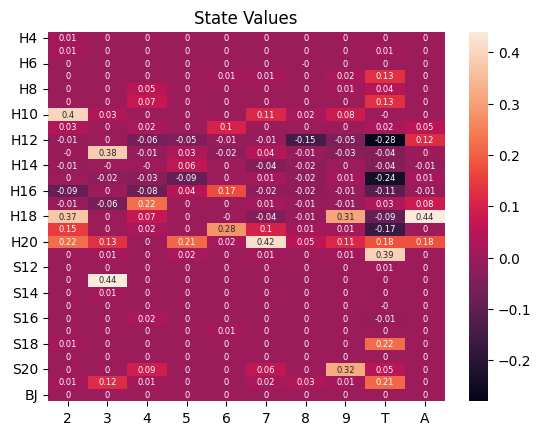

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick  stick    hit    hit  stick
H5   stick  stick  stick  stick    hit  stick    hit    hit    hit    hit
H6     hit    hit  stick  stick    hit  stick    hit    hit    hit    hit
H7   stick  stick    hit  stick  stick  stick  stick  stick  stick    hit
H8   stick    hit  stick    hit    hit    hit    hit  stick  stick  stick
H9     hit  stick  stick  stick  stick    hit    hit    hit  stick  stick
H10  stick  stick    hit    hit  stick  stick  stick  stick    hit    hit
H11  stick    hit  stick    hit  stick    hit  stick    hit    hit  stick
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H13    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit  stick    hit    hit    hit    hit  stick    hit
H15    hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H16    hit  stick    hit  stick  stick

runtime = 0.18 seconds


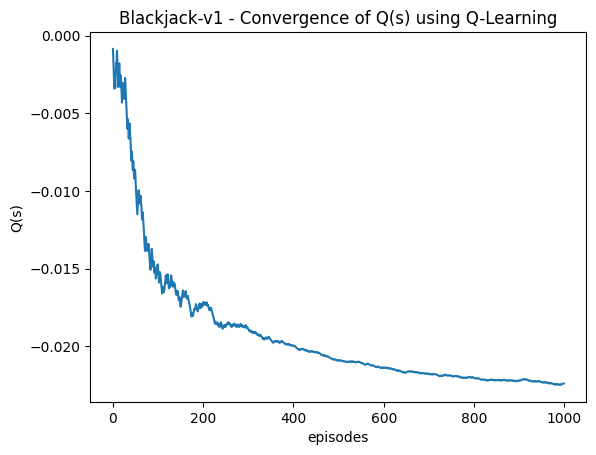

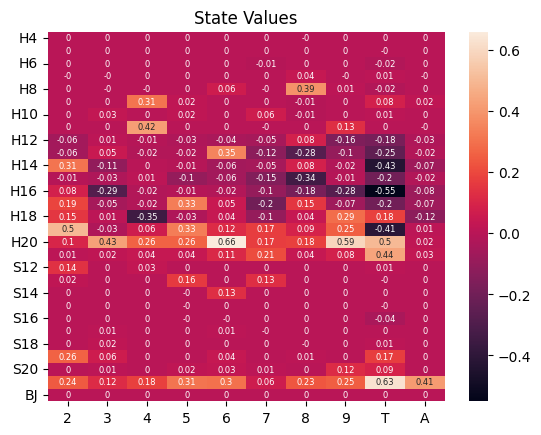

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick  stick  stick    hit  stick  stick    hit
H5   stick  stick  stick  stick  stick  stick    hit  stick    hit    hit
H6   stick    hit  stick  stick    hit    hit  stick    hit    hit    hit
H7     hit    hit  stick  stick  stick  stick  stick    hit    hit    hit
H8     hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H9     hit    hit  stick    hit    hit    hit    hit    hit  stick  stick
H10    hit    hit    hit  stick  stick  stick    hit    hit    hit    hit
H11    hit    hit  stick    hit    hit    hit    hit  stick    hit    hit
H12    hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H13    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H14  stick    hit    hit    hit    hit    hit  stick    hit    hit    hit
H15  stick    hit  stick    hit  stick    hit    hit  stick  stick    hit
H16  stick  stick    hit    hit    hit

runtime = 0.35 seconds


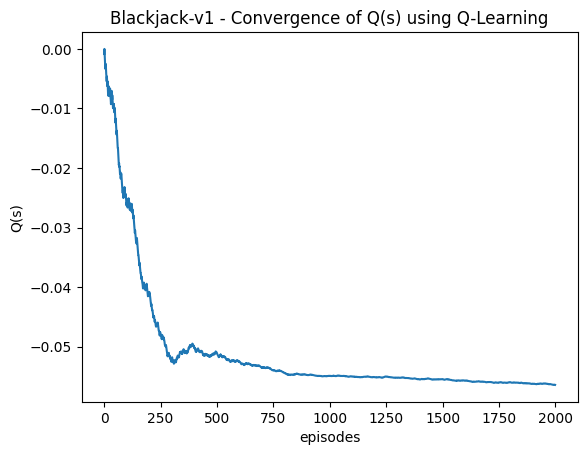

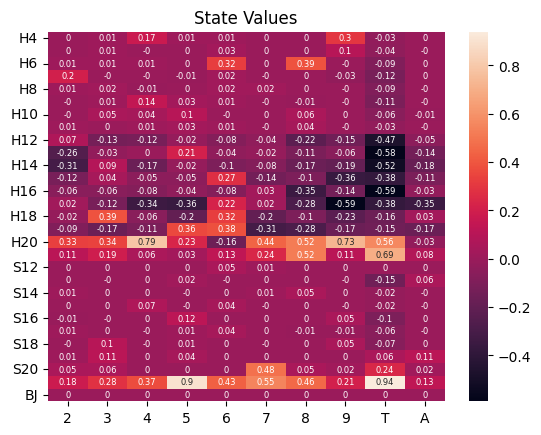

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick  stick  stick    hit  stick  stick    hit  stick
H5   stick  stick    hit    hit  stick  stick  stick  stick    hit    hit
H6     hit  stick  stick    hit  stick    hit  stick    hit    hit    hit
H7   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8   stick    hit    hit    hit    hit  stick    hit    hit    hit    hit
H9     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H10    hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H11  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit  stick    hit    hit  stick    hit    hit    hit
H13    hit  stick  stick  stick    hit    hit    hit    hit  stick    hit
H14    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H15    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H16    hit  stick  stick  stick    hit

runtime = 0.55 seconds


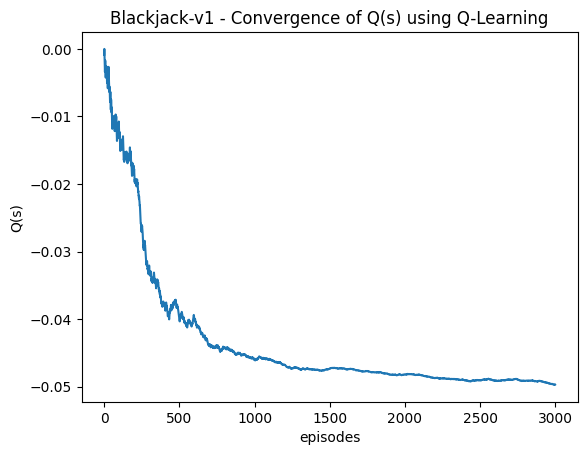

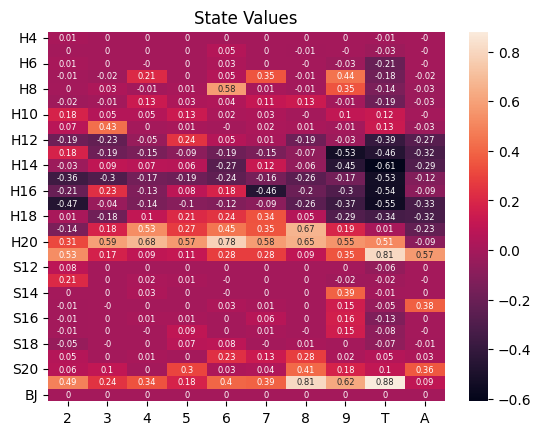

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick  stick    hit  stick    hit    hit    hit
H5     hit  stick    hit    hit  stick  stick    hit    hit    hit    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit  stick  stick    hit  stick    hit    hit
H8     hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H9     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H10    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit  stick    hit    hit    hit    hit    hit  stick
H13  stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H14  stick  stick    hit  stick    hit  stick    hit    hit  stick    hit
H15    hit    hit  stick  stick  stick    hit  stick    hit    hit  stick
H16  stick  stick    hit  stick  stick

runtime = 0.72 seconds


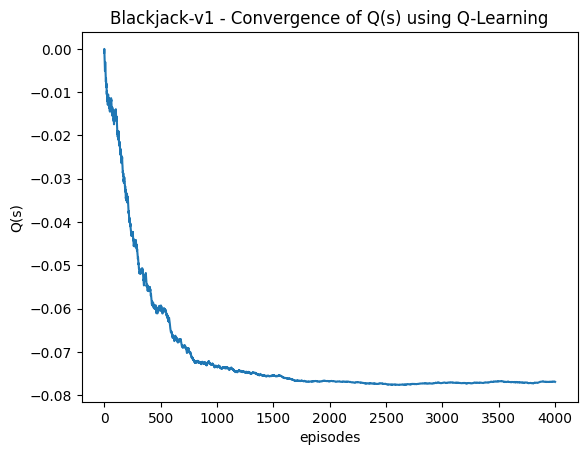

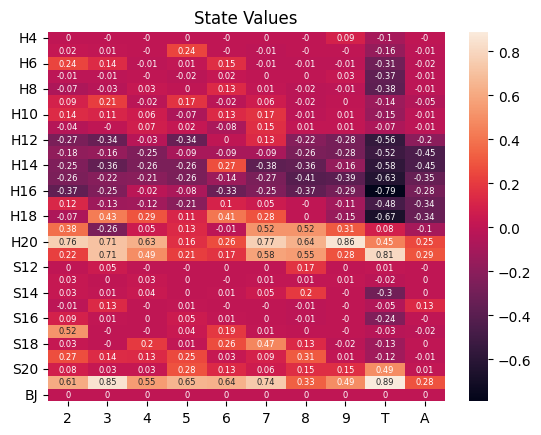

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit  stick  stick  stick    hit  stick    hit    hit
H5   stick  stick    hit  stick    hit    hit    hit    hit    hit    hit
H6   stick  stick    hit  stick  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit  stick    hit    hit
H12  stick    hit  stick    hit    hit    hit    hit    hit  stick    hit
H13    hit    hit    hit  stick  stick    hit    hit    hit  stick  stick
H14    hit    hit    hit    hit  stick    hit    hit    hit    hit  stick
H15    hit  stick    hit    hit  stick  stick  stick  stick    hit    hit
H16  stick    hit  stick  stick    hit

runtime = 0.88 seconds


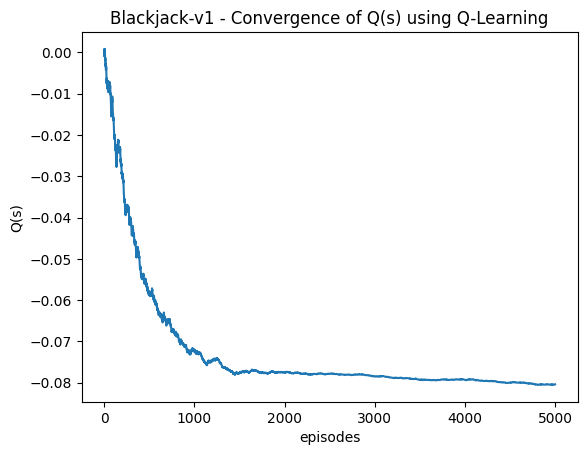

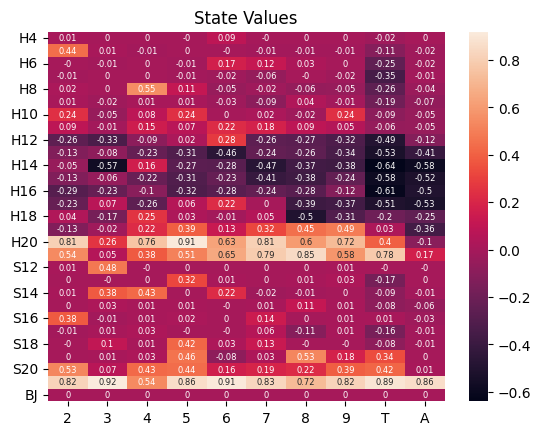

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H5   stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit  stick    hit  stick  stick    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H8     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H10    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H11    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H12    hit  stick    hit  stick  stick    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit  stick  stick    hit    hit    hit    hit    hit    hit    hit
H15  stick  stick    hit    hit    hit  stick    hit    hit  stick  stick
H16  stick  stick  stick  stick  stick

runtime = 1.82 seconds


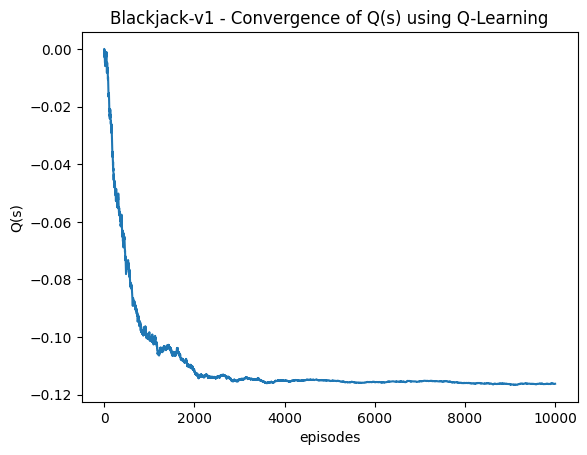

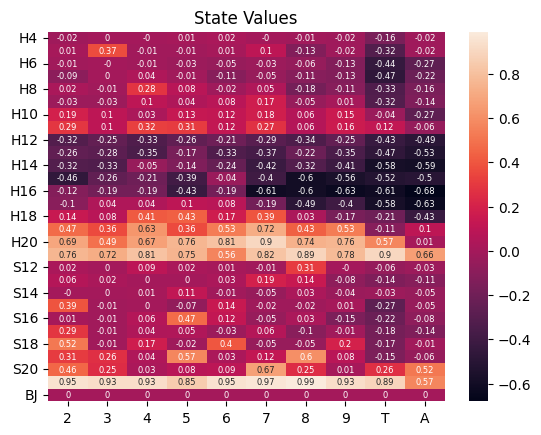

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H5   stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit  stick    hit    hit  stick    hit    hit    hit    hit
H9     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit  stick  stick    hit  stick    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit  stick    hit    hit
H14    hit    hit  stick  stick    hit    hit  stick  stick    hit    hit
H15    hit  stick    hit    hit  stick    hit  stick    hit    hit    hit
H16  stick  stick  stick    hit  stick

runtime = 5.55 seconds


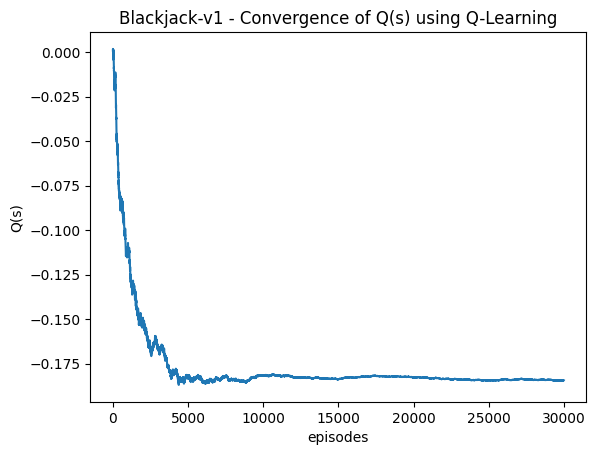

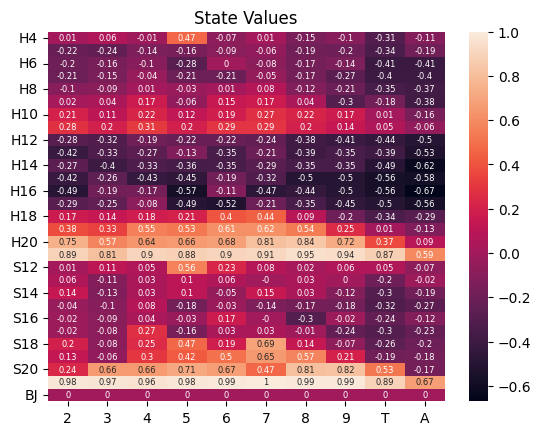

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15    hit  stick    hit    hit  stick    hit  stick    hit    hit    hit
H16    hit  stick  stick    hit  stick

runtime = 10.98 seconds


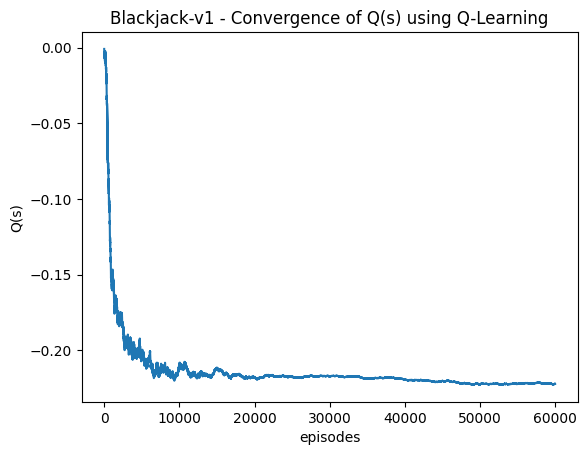

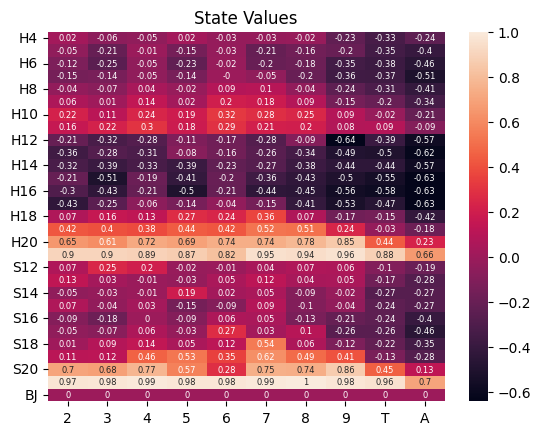

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit  stick    hit    hit
H13  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H15  stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H16  stick    hit  stick    hit  stick

runtime = 16.76 seconds


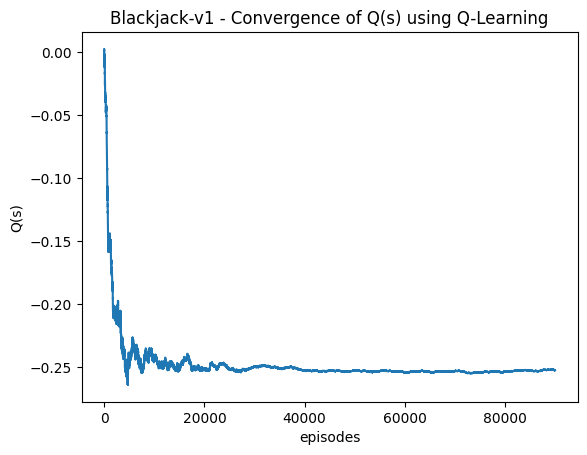

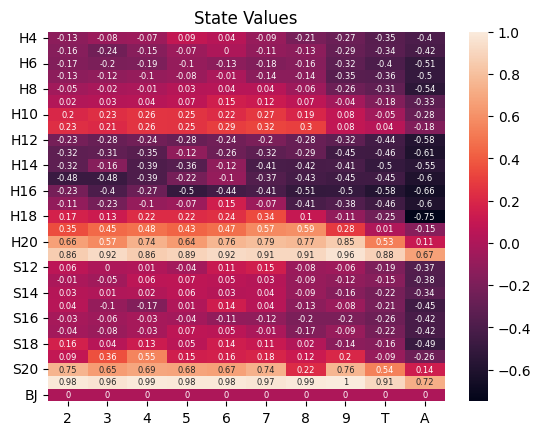

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H5     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick  stick    hit    hit  stick    hit    hit    hit    hit    hit
H15    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H16  stick    hit  stick    hit    hit

runtime = 0.12 seconds


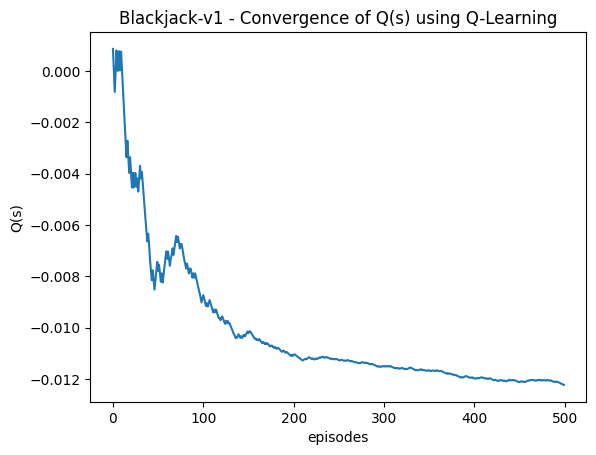

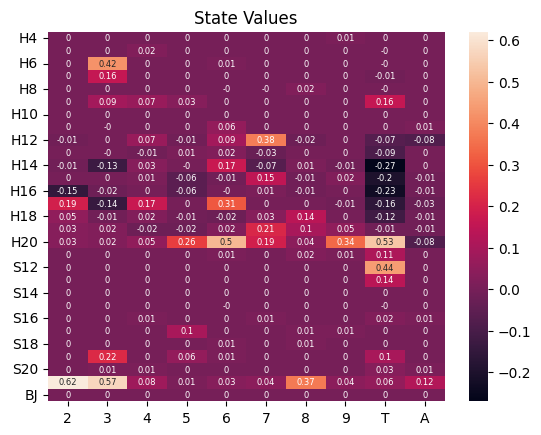

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick  stick  stick  stick    hit
H5     hit  stick  stick  stick    hit  stick  stick    hit    hit  stick
H6     hit  stick    hit    hit  stick    hit    hit    hit    hit  stick
H7     hit  stick    hit    hit    hit  stick  stick    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit  stick  stick    hit  stick
H9   stick  stick  stick  stick  stick  stick    hit    hit  stick    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit  stick    hit    hit    hit    hit    hit    hit  stick
H12    hit    hit  stick    hit  stick  stick    hit    hit    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H14    hit    hit  stick  stick  stick    hit  stick    hit    hit  stick
H15    hit  stick  stick    hit    hit  stick    hit  stick    hit    hit
H16    hit    hit    hit    hit  stick

runtime = 0.19 seconds


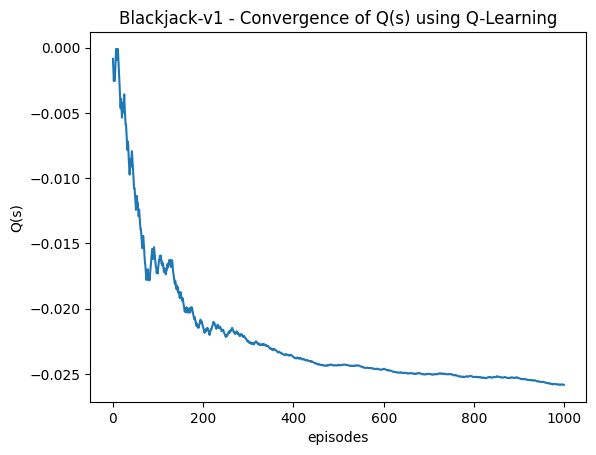

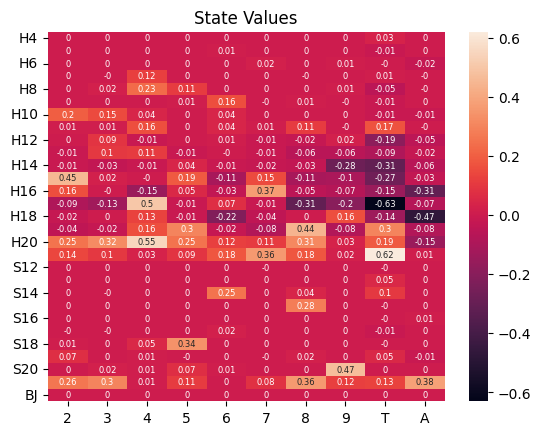

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick    hit  stick  stick  stick  stick
H5     hit  stick  stick  stick  stick  stick    hit    hit    hit  stick
H6   stick  stick    hit    hit    hit  stick  stick  stick    hit    hit
H7     hit    hit  stick  stick  stick    hit    hit  stick  stick    hit
H8   stick  stick  stick  stick    hit    hit    hit    hit    hit    hit
H9   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10  stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H11  stick    hit  stick    hit  stick    hit  stick    hit    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit  stick    hit
H14    hit    hit    hit  stick    hit    hit    hit    hit  stick    hit
H15  stick  stick    hit  stick    hit  stick    hit    hit    hit    hit
H16  stick    hit  stick  stick    hit

runtime = 0.36 seconds


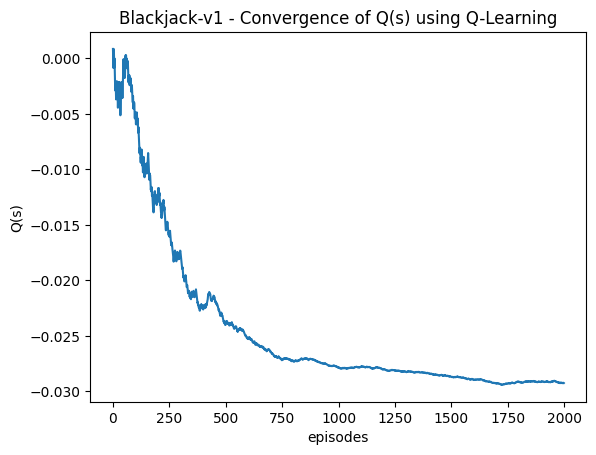

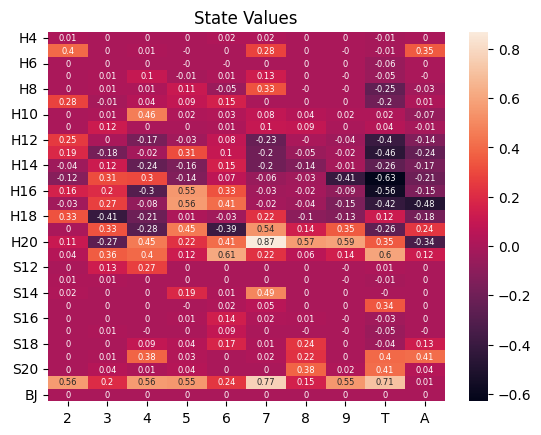

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit  stick  stick  stick  stick  stick    hit  stick
H5   stick    hit    hit    hit    hit  stick  stick    hit    hit  stick
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit  stick  stick    hit    hit  stick    hit    hit    hit    hit
H8     hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H9   stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H12  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H14    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H15    hit  stick  stick    hit    hit  stick    hit    hit  stick    hit
H16  stick  stick    hit  stick  stick

runtime = 0.54 seconds


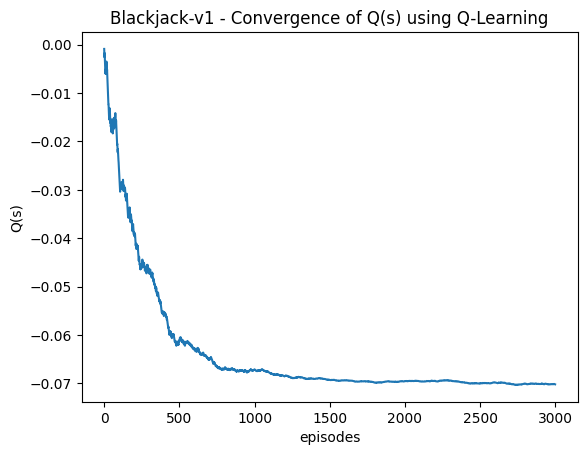

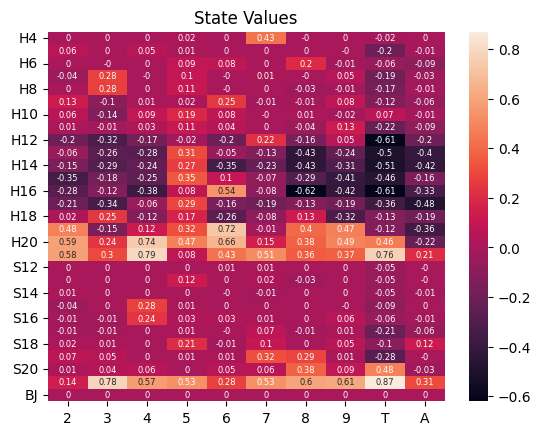

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick    hit  stick    hit    hit    hit    hit
H5   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit  stick  stick    hit  stick    hit  stick    hit
H7     hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H8     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H9   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H12    hit    hit    hit    hit    hit  stick    hit    hit  stick    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick  stick    hit  stick    hit  stick  stick    hit    hit    hit
H15    hit    hit    hit  stick  stick    hit    hit    hit  stick    hit
H16    hit  stick    hit  stick  stick

runtime = 0.70 seconds


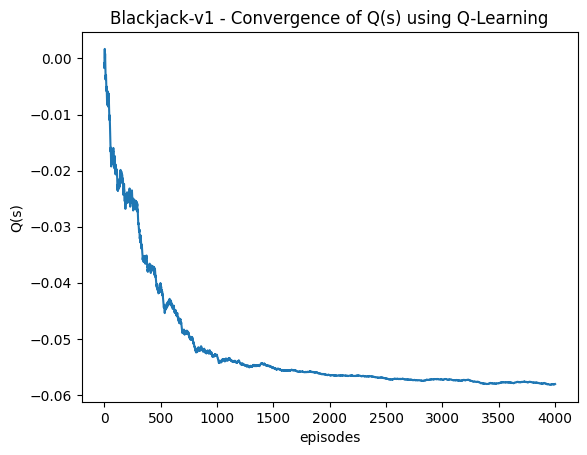

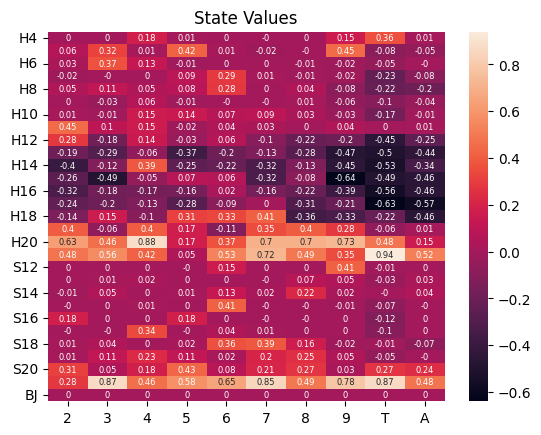

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick  stick    hit  stick  stick  stick  stick
H5   stick  stick    hit  stick  stick    hit    hit  stick    hit    hit
H6   stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H8     hit  stick    hit    hit  stick    hit  stick    hit  stick    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H11  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H12  stick  stick  stick  stick  stick    hit  stick    hit    hit    hit
H13    hit  stick  stick    hit    hit    hit    hit    hit  stick    hit
H14    hit  stick  stick    hit    hit    hit    hit  stick    hit    hit
H15  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick  stick  stick  stick

runtime = 0.91 seconds


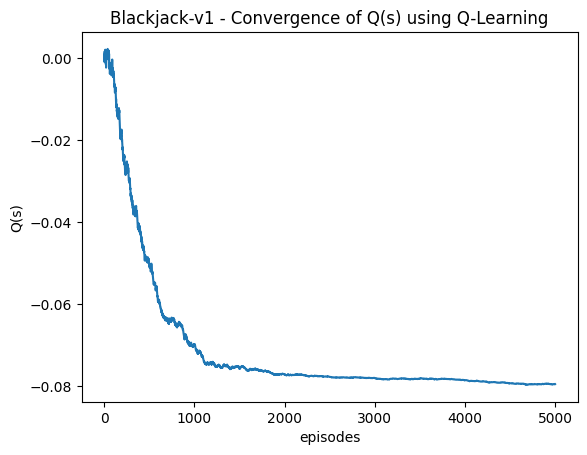

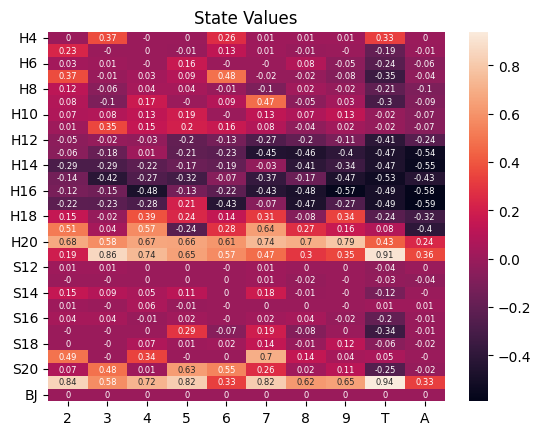

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit  stick  stick  stick  stick  stick    hit
H5   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H6     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H7   stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H13  stick    hit  stick    hit  stick    hit    hit  stick    hit    hit
H14  stick    hit  stick  stick    hit  stick  stick    hit    hit    hit
H15  stick    hit    hit    hit  stick    hit    hit  stick    hit    hit
H16  stick  stick    hit    hit  stick

runtime = 1.91 seconds


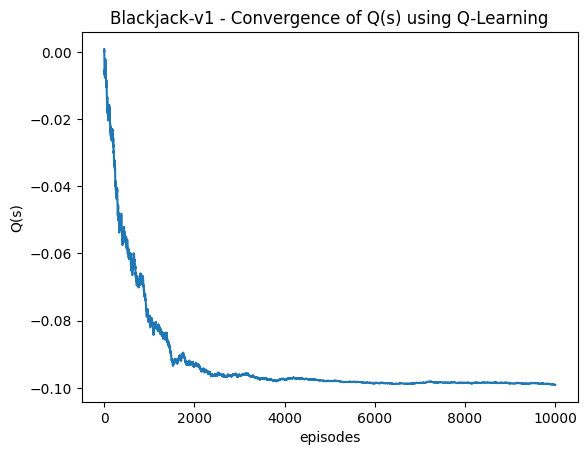

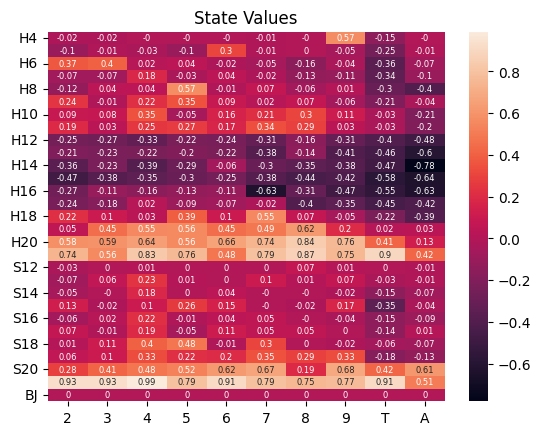

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H5     hit    hit    hit    hit  stick    hit    hit    hit    hit  stick
H6   stick  stick    hit  stick    hit    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit  stick    hit    hit    hit  stick    hit    hit
H9   stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit    hit  stick  stick  stick    hit    hit    hit
H14    hit  stick    hit    hit  stick    hit    hit    hit    hit  stick
H15    hit  stick    hit  stick  stick    hit    hit    hit  stick  stick
H16  stick  stick  stick  stick  stick

runtime = 5.56 seconds


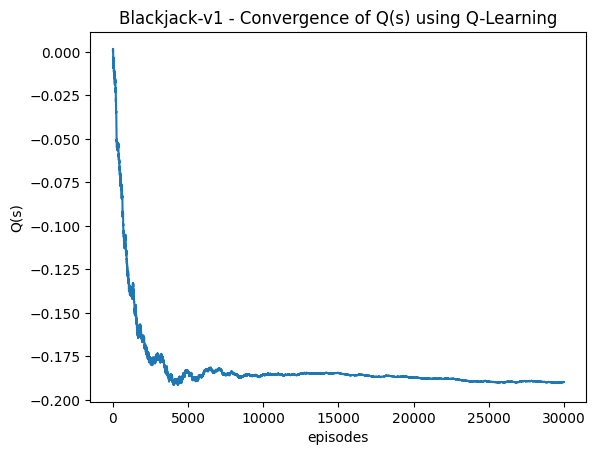

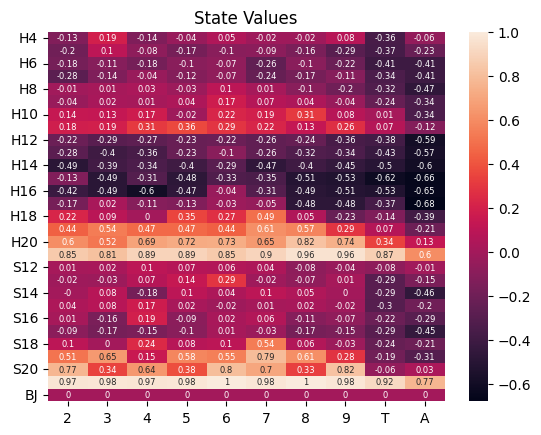

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H5     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H14    hit  stick    hit    hit    hit  stick    hit    hit    hit    hit
H15  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H16    hit    hit    hit    hit  stick

runtime = 11.50 seconds


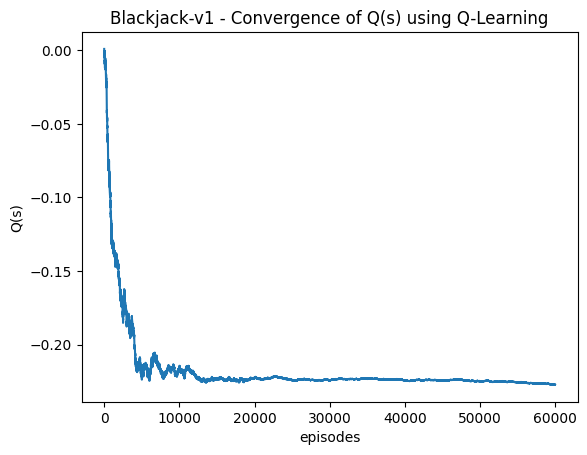

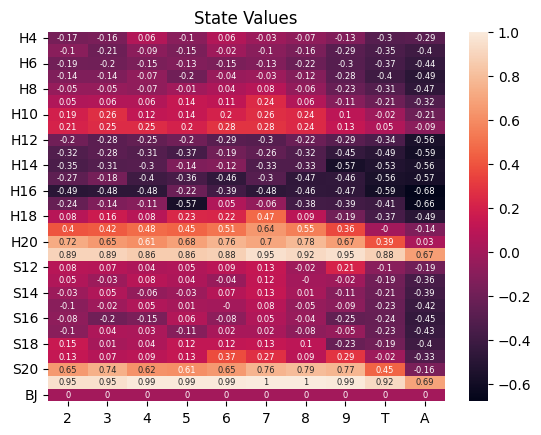

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14  stick    hit    hit  stick  stick    hit    hit  stick    hit    hit
H15  stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H16    hit    hit    hit  stick    hit

runtime = 17.30 seconds


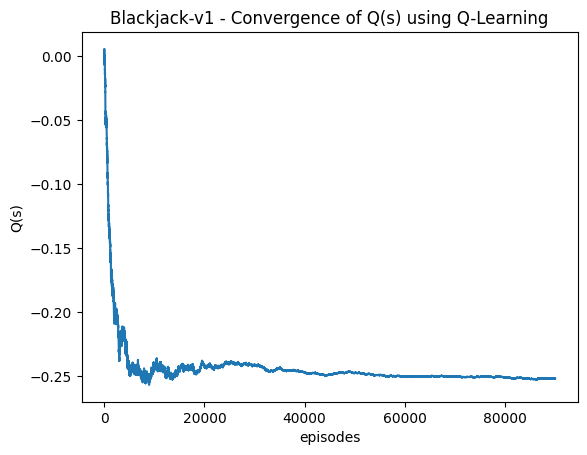

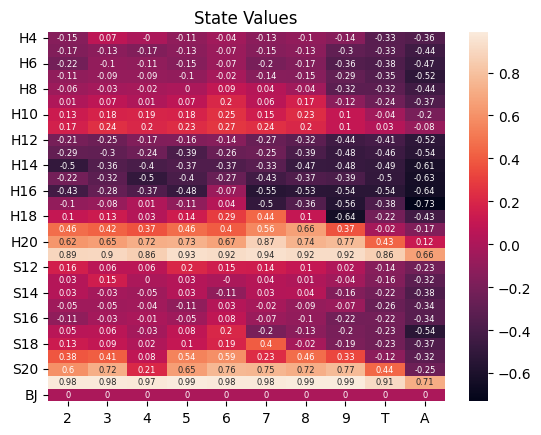

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15  stick  stick    hit    hit  stick    hit    hit    hit    hit    hit
H16    hit  stick  stick    hit  stick

runtime = 0.10 seconds


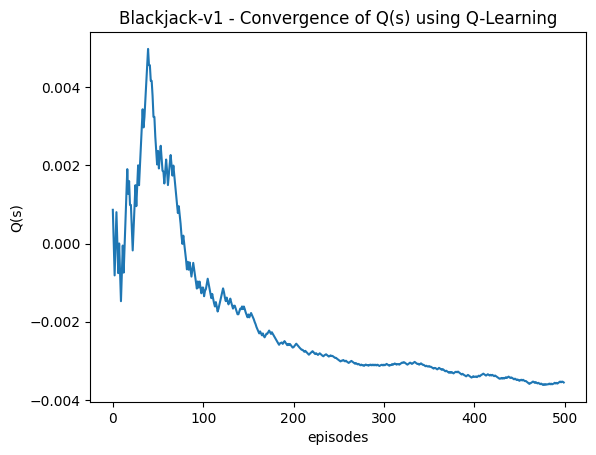

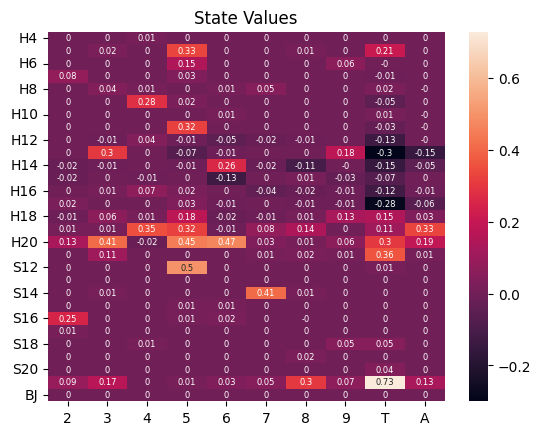

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick    hit  stick  stick  stick
H5   stick  stick    hit  stick  stick  stick  stick  stick  stick    hit
H6   stick  stick  stick  stick  stick  stick    hit  stick    hit  stick
H7   stick  stick  stick  stick  stick  stick    hit  stick    hit    hit
H8   stick  stick  stick    hit    hit  stick    hit    hit    hit    hit
H9     hit    hit  stick  stick  stick    hit  stick  stick    hit    hit
H10    hit    hit  stick  stick  stick    hit    hit  stick  stick    hit
H11    hit    hit  stick  stick    hit    hit  stick    hit    hit    hit
H12  stick    hit  stick    hit    hit  stick    hit    hit    hit    hit
H13    hit  stick  stick    hit  stick  stick    hit  stick    hit    hit
H14    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H15    hit  stick  stick    hit    hit    hit  stick    hit  stick    hit
H16    hit  stick  stick  stick  stick

runtime = 0.18 seconds


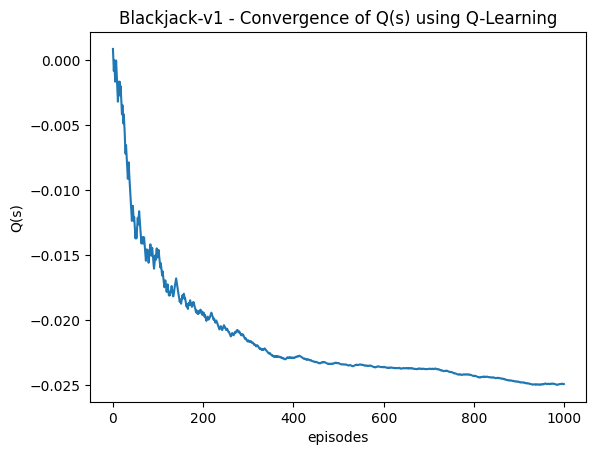

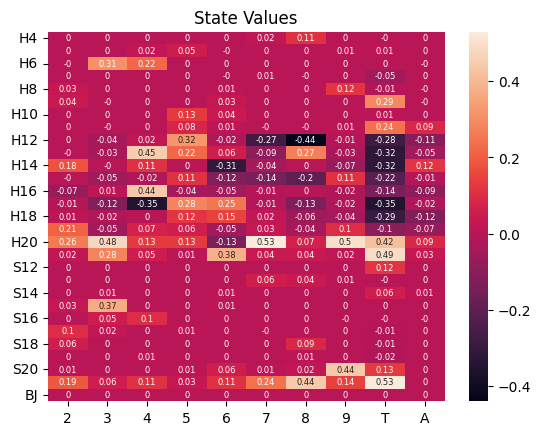

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick    hit  stick  stick  stick    hit  stick
H5   stick    hit  stick  stick    hit    hit    hit  stick    hit  stick
H6     hit  stick  stick  stick  stick    hit  stick    hit    hit    hit
H7   stick    hit    hit    hit    hit  stick    hit    hit    hit  stick
H8   stick    hit    hit    hit    hit    hit    hit  stick    hit    hit
H9   stick    hit    hit    hit  stick    hit    hit    hit  stick    hit
H10    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit  stick
H12    hit    hit    hit  stick    hit    hit  stick    hit    hit    hit
H13    hit    hit  stick  stick  stick    hit  stick    hit    hit    hit
H14  stick    hit  stick    hit    hit    hit    hit    hit    hit  stick
H15    hit    hit  stick  stick    hit    hit    hit  stick    hit    hit
H16    hit  stick  stick    hit    hit

runtime = 0.37 seconds


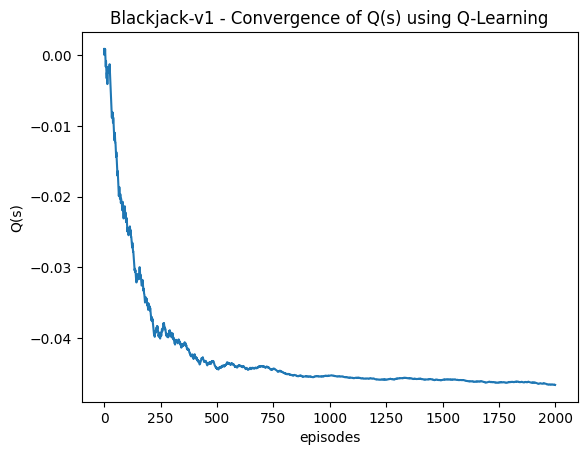

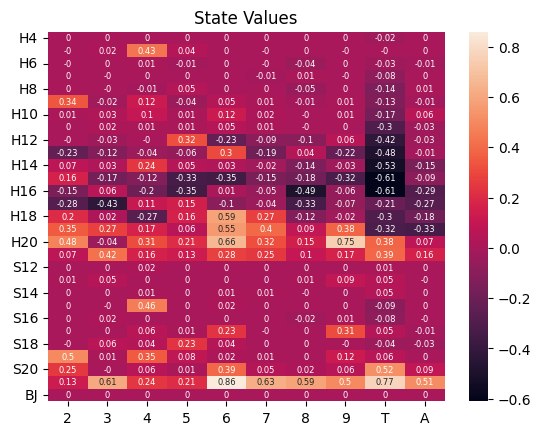

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick    hit  stick  stick  stick    hit  stick
H5     hit  stick  stick  stick  stick    hit  stick    hit    hit    hit
H6     hit  stick  stick    hit  stick    hit    hit  stick    hit    hit
H7     hit    hit    hit    hit  stick    hit  stick    hit    hit  stick
H8     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H9   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12  stick    hit  stick  stick    hit    hit  stick    hit  stick    hit
H13    hit    hit  stick    hit  stick    hit  stick    hit    hit    hit
H14  stick  stick  stick  stick  stick    hit    hit  stick  stick    hit
H15  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H16    hit  stick    hit  stick  stick

runtime = 0.55 seconds


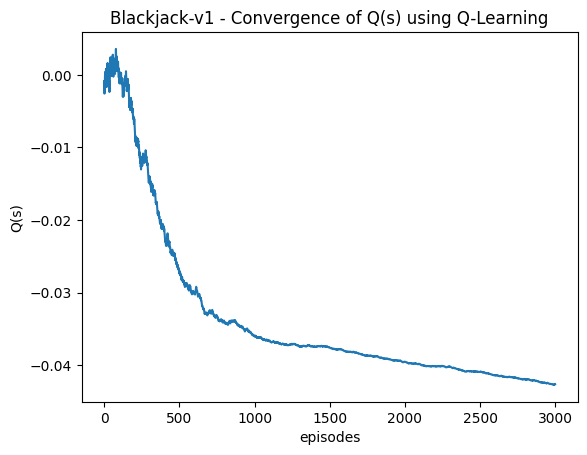

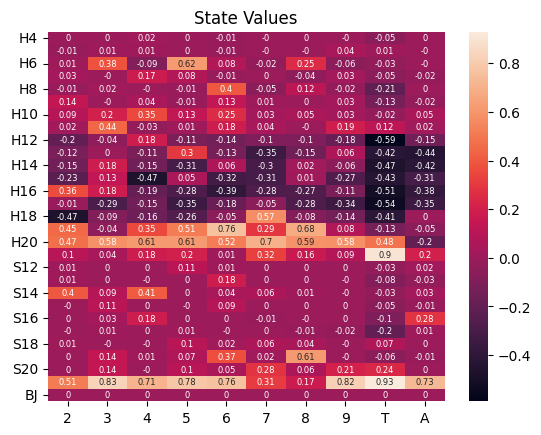

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick    hit    hit    hit    hit    hit  stick
H5     hit    hit  stick    hit    hit    hit    hit  stick  stick    hit
H6     hit  stick    hit  stick  stick    hit  stick    hit    hit    hit
H7   stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H9   stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H10  stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H11  stick  stick  stick    hit  stick    hit    hit  stick    hit    hit
H12    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick    hit  stick    hit  stick    hit    hit
H14  stick  stick    hit    hit  stick  stick    hit    hit    hit  stick
H15    hit  stick    hit  stick    hit    hit  stick  stick    hit  stick
H16  stick  stick  stick  stick    hit

runtime = 0.77 seconds


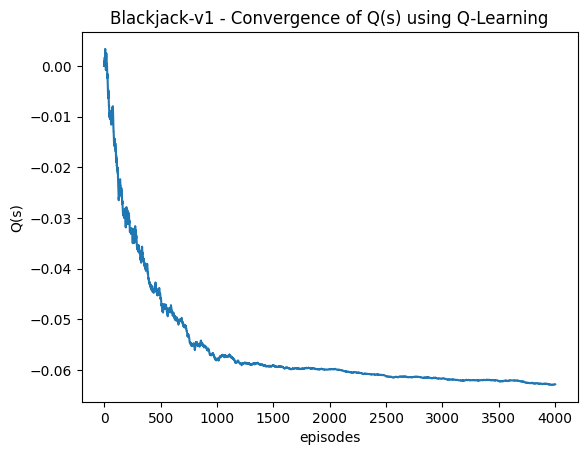

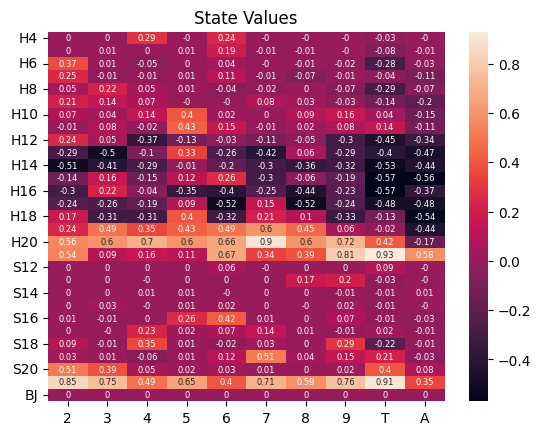

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit  stick    hit    hit    hit    hit  stick
H6   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8   stick  stick  stick    hit    hit    hit    hit    hit    hit    hit
H9   stick    hit    hit    hit    hit  stick    hit    hit    hit    hit
H10    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H11    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H12  stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H13    hit    hit  stick  stick    hit    hit  stick    hit    hit    hit
H14    hit  stick  stick  stick  stick    hit  stick    hit  stick    hit
H15    hit  stick  stick  stick  stick  stick    hit    hit    hit    hit
H16  stick  stick    hit    hit  stick

runtime = 0.92 seconds


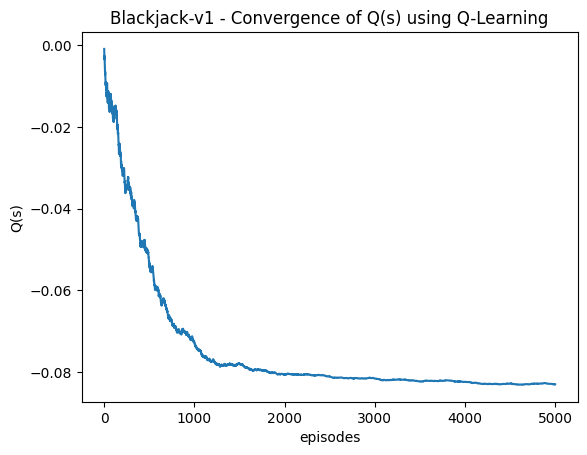

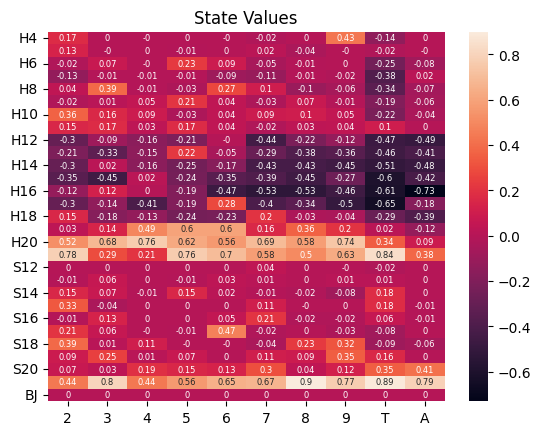

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit    hit    hit    hit    hit  stick    hit    hit
H5   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit  stick    hit    hit  stick  stick    hit    hit    hit    hit
H9     hit    hit    hit  stick    hit    hit  stick  stick    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H14    hit  stick    hit  stick    hit  stick    hit    hit    hit    hit
H15    hit  stick  stick  stick    hit  stick    hit    hit    hit    hit
H16  stick  stick  stick  stick    hit

runtime = 1.99 seconds


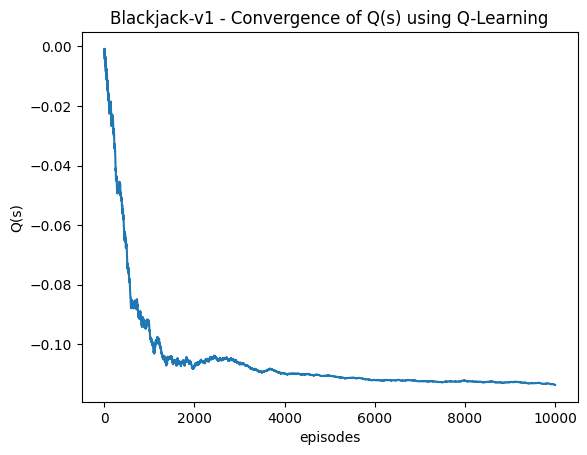

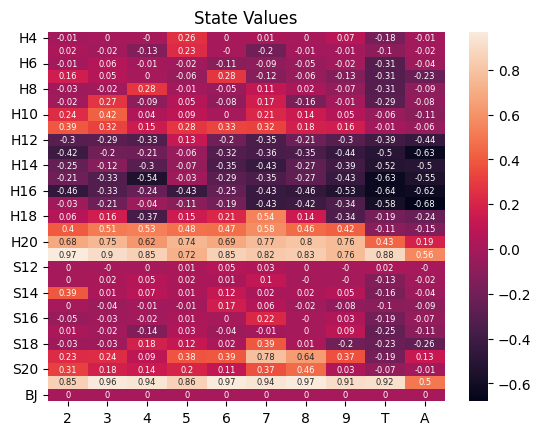

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit  stick    hit  stick    hit    hit
H5     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H7   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10  stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13  stick    hit  stick  stick  stick    hit    hit    hit    hit  stick
H14    hit  stick  stick  stick    hit    hit    hit    hit  stick    hit
H15  stick  stick    hit  stick    hit    hit    hit  stick  stick    hit
H16  stick    hit  stick    hit  stick

runtime = 6.05 seconds


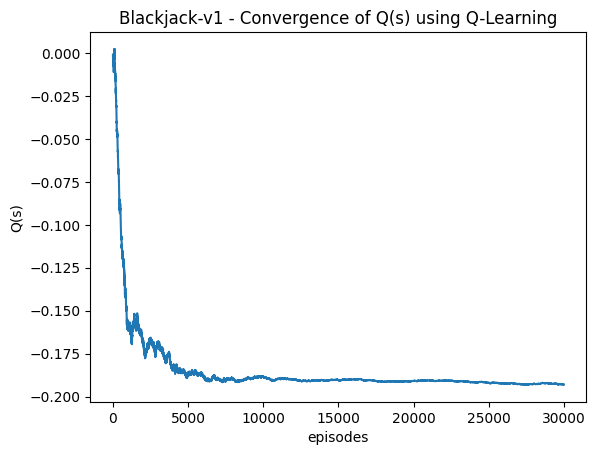

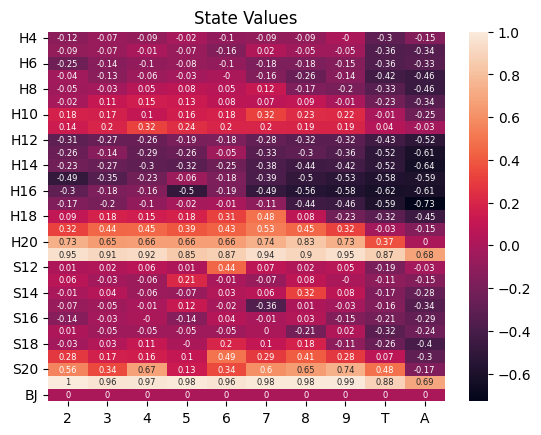

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick  stick  stick  stick    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit  stick  stick  stick    hit    hit    hit    hit
H14  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H15    hit  stick  stick  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick  stick    hit  stick

runtime = 11.73 seconds


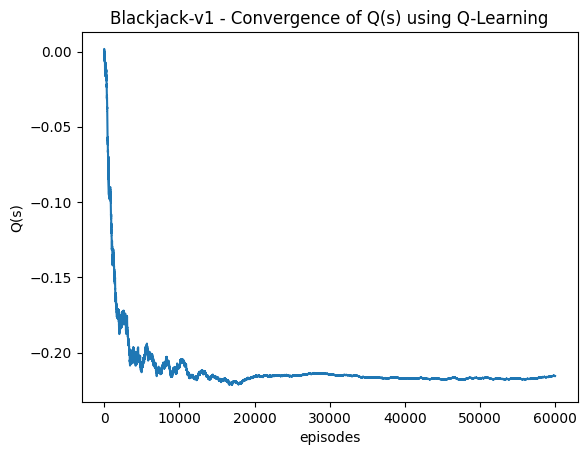

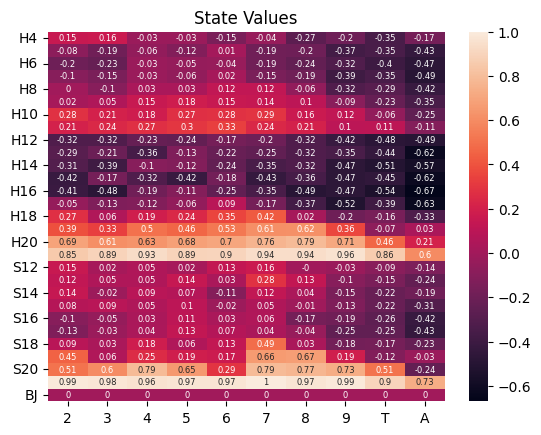

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H15    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H16    hit    hit  stick  stick  stick

runtime = 17.36 seconds


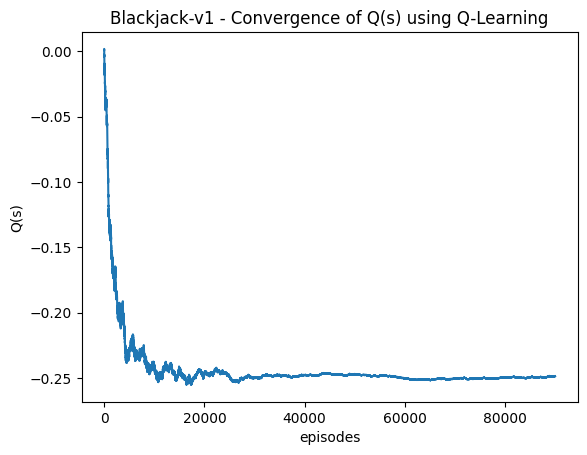

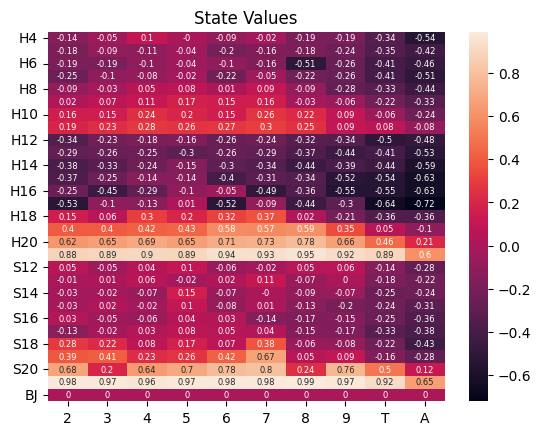

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H15  stick  stick  stick  stick    hit    hit    hit    hit    hit    hit
H16  stick    hit  stick  stick  stick

runtime = 0.10 seconds


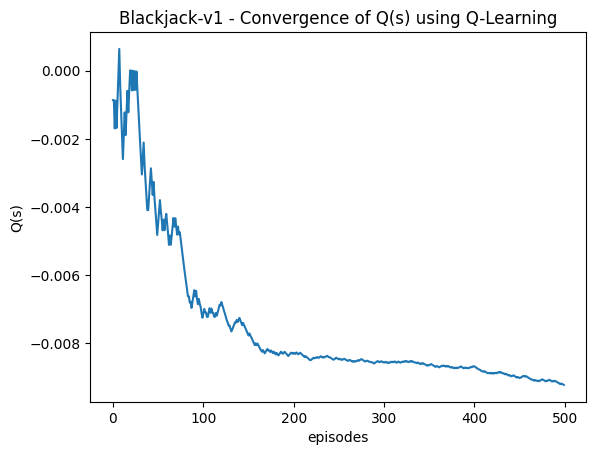

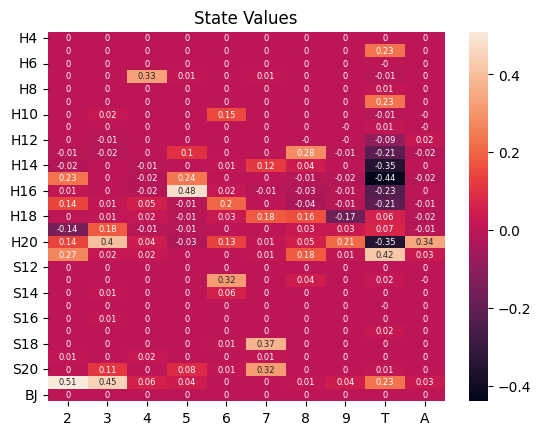

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick    hit  stick  stick    hit    hit  stick
H5   stick  stick  stick    hit  stick    hit  stick    hit  stick  stick
H6   stick    hit    hit  stick    hit  stick  stick  stick    hit  stick
H7   stick  stick  stick  stick  stick  stick  stick    hit    hit    hit
H8   stick  stick    hit    hit    hit    hit    hit  stick  stick    hit
H9     hit    hit  stick    hit    hit    hit  stick    hit  stick    hit
H10    hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit  stick    hit    hit    hit  stick    hit    hit    hit  stick
H13    hit    hit    hit  stick    hit    hit  stick    hit    hit    hit
H14    hit    hit    hit  stick  stick  stick  stick    hit    hit    hit
H15  stick  stick    hit  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick    hit  stick  stick

runtime = 0.18 seconds


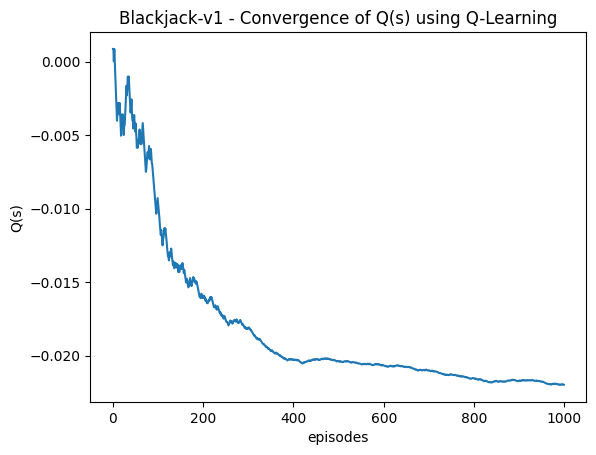

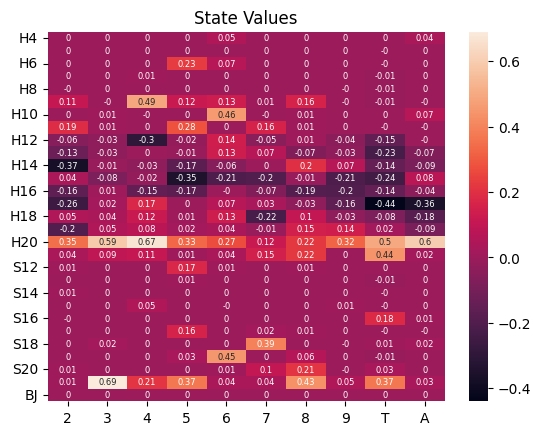

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick  stick  stick    hit  stick  stick  stick
H5     hit  stick  stick  stick    hit    hit  stick  stick    hit  stick
H6   stick    hit    hit  stick  stick  stick  stick  stick    hit    hit
H7   stick  stick  stick  stick  stick    hit    hit    hit    hit  stick
H8     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H9   stick    hit  stick  stick  stick  stick  stick    hit    hit    hit
H10    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H11  stick    hit    hit  stick    hit  stick  stick    hit    hit    hit
H12    hit    hit  stick    hit  stick  stick    hit    hit    hit    hit
H13    hit  stick    hit  stick  stick  stick    hit  stick  stick  stick
H14    hit    hit    hit  stick    hit    hit  stick  stick    hit    hit
H15  stick    hit    hit    hit  stick    hit    hit    hit  stick  stick
H16    hit    hit    hit    hit    hit

runtime = 0.35 seconds


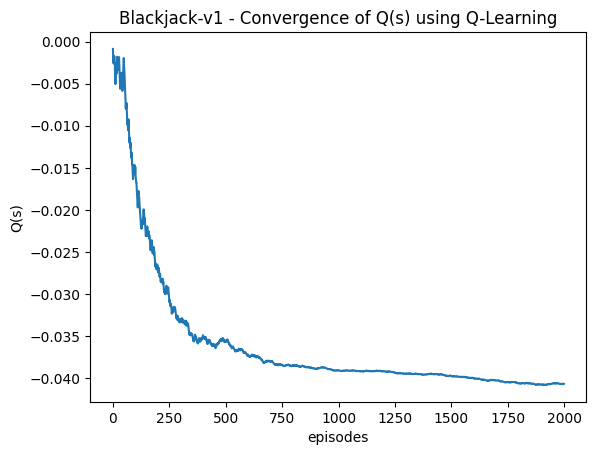

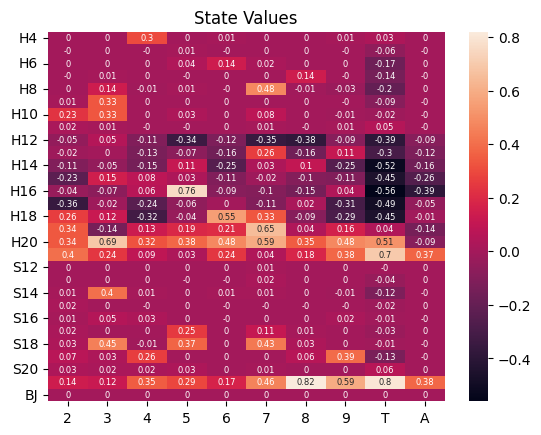

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick  stick  stick  stick  stick  stick  stick
H5     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit  stick  stick  stick    hit    hit    hit  stick
H7     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H8     hit  stick    hit  stick    hit  stick    hit    hit    hit    hit
H9     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H10  stick  stick    hit  stick    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit  stick    hit    hit    hit  stick    hit    hit    hit
H13  stick    hit    hit    hit  stick  stick    hit  stick  stick    hit
H14    hit    hit    hit  stick    hit  stick  stick    hit    hit    hit
H15  stick  stick  stick  stick    hit    hit    hit    hit    hit    hit
H16  stick  stick  stick  stick  stick

runtime = 0.62 seconds


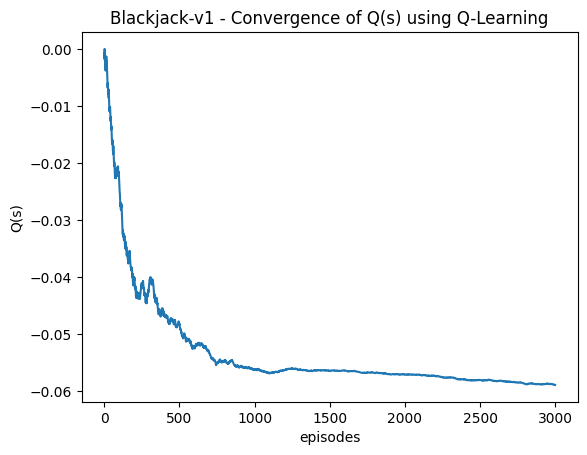

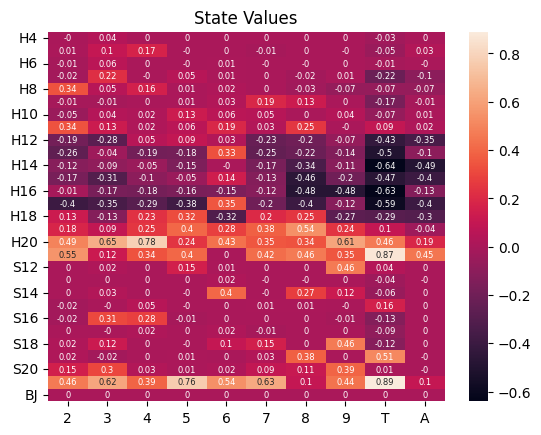

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H5   stick  stick  stick    hit  stick    hit    hit    hit    hit  stick
H6     hit  stick    hit    hit    hit    hit    hit    hit  stick    hit
H7     hit  stick    hit  stick    hit    hit    hit  stick    hit    hit
H8   stick  stick  stick    hit    hit  stick    hit    hit    hit    hit
H9     hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick  stick    hit    hit  stick    hit  stick    hit    hit    hit
H12    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H14    hit  stick    hit    hit  stick    hit    hit    hit  stick    hit
H15    hit  stick    hit  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick  stick    hit  stick

runtime = 0.75 seconds


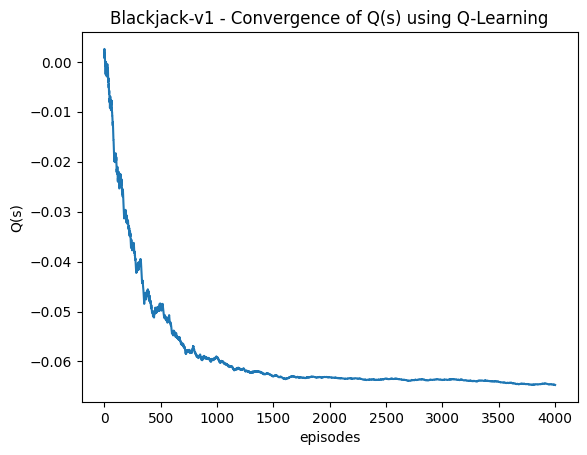

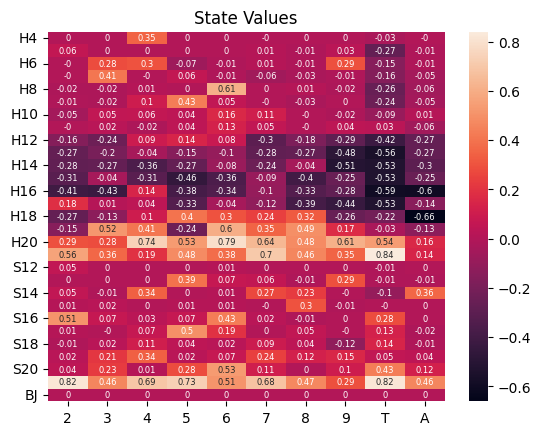

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick    hit    hit    hit    hit  stick    hit    hit
H5   stick    hit    hit  stick    hit    hit    hit  stick    hit    hit
H6     hit  stick  stick    hit    hit  stick  stick  stick    hit  stick
H7     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H9     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit    hit    hit  stick
H11    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H13    hit  stick  stick    hit    hit  stick    hit    hit    hit    hit
H14  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15  stick  stick  stick  stick    hit    hit    hit  stick    hit  stick
H16    hit    hit  stick  stick  stick

runtime = 0.89 seconds


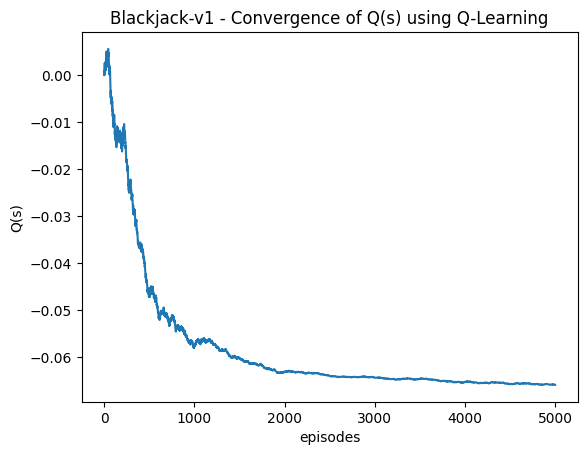

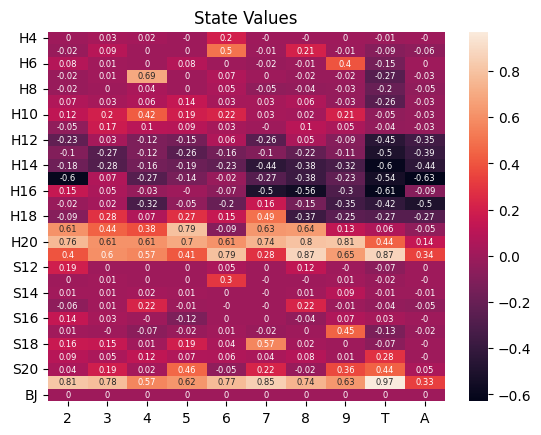

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H5     hit  stick  stick    hit  stick    hit  stick    hit    hit    hit
H6   stick    hit    hit  stick    hit    hit    hit  stick    hit    hit
H7     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit  stick    hit  stick    hit  stick    hit    hit    hit    hit
H15    hit  stick    hit    hit  stick    hit    hit    hit  stick    hit
H16  stick    hit  stick  stick  stick

runtime = 1.81 seconds


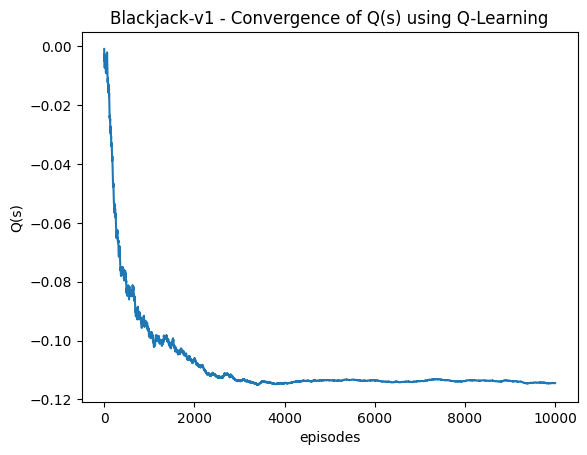

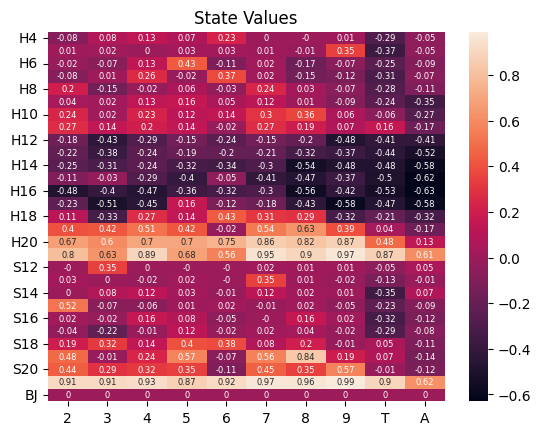

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick  stick    hit    hit    hit    hit    hit
H5     hit  stick    hit    hit    hit  stick    hit  stick    hit    hit
H6     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H14    hit  stick  stick    hit    hit    hit  stick  stick    hit    hit
H15  stick  stick    hit  stick  stick    hit  stick  stick    hit    hit
H16    hit    hit    hit    hit  stick

runtime = 5.56 seconds


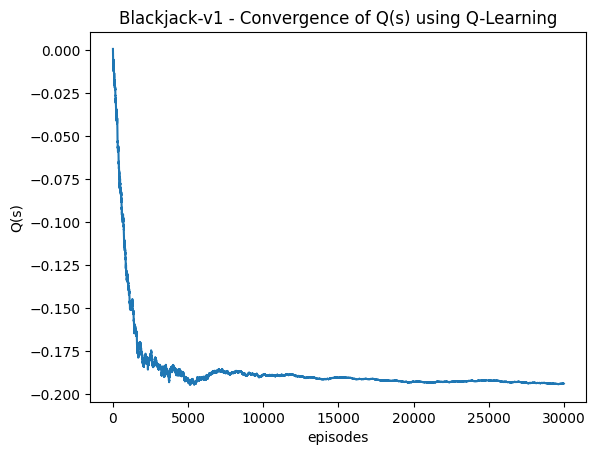

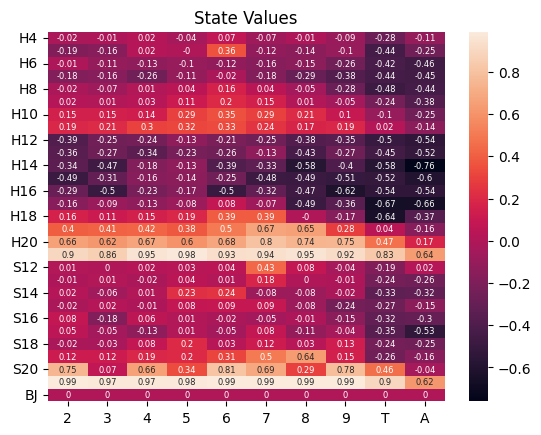

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit  stick    hit    hit    hit    hit  stick
H5     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H13  stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14  stick    hit  stick  stick    hit    hit  stick    hit    hit  stick
H15    hit  stick  stick  stick  stick    hit  stick  stick    hit    hit
H16  stick    hit  stick  stick    hit

runtime = 11.69 seconds


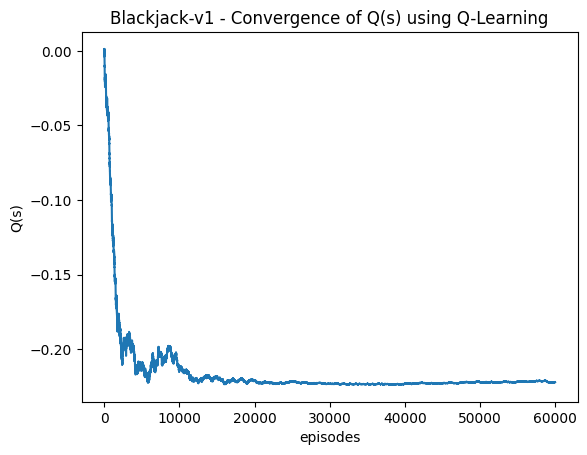

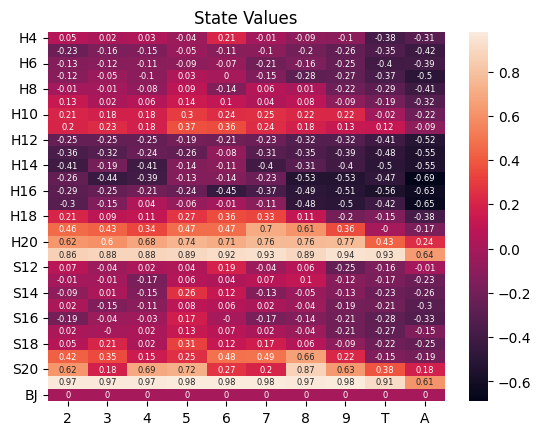

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick  stick    hit  stick    hit    hit    hit    hit    hit
H14    hit  stick    hit  stick  stick  stick    hit    hit    hit    hit
H15  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick  stick  stick    hit

runtime = 17.19 seconds


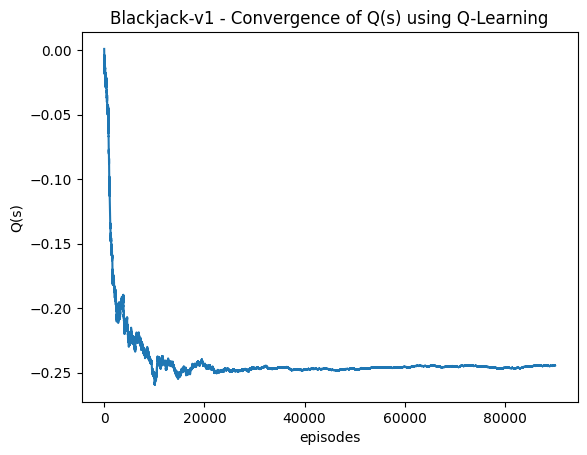

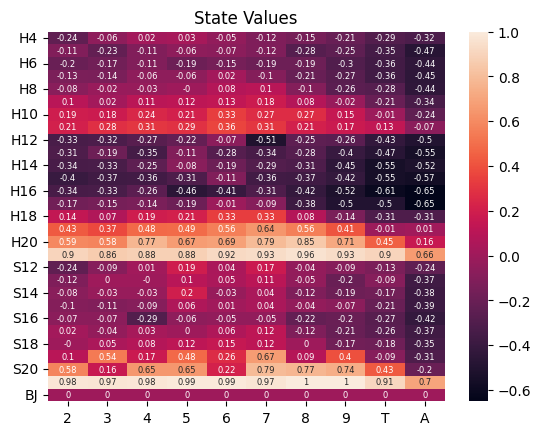

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H13    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit  stick    hit  stick  stick    hit    hit    hit    hit    hit
H15    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H16  stick  stick  stick    hit    hit

runtime = 0.09 seconds


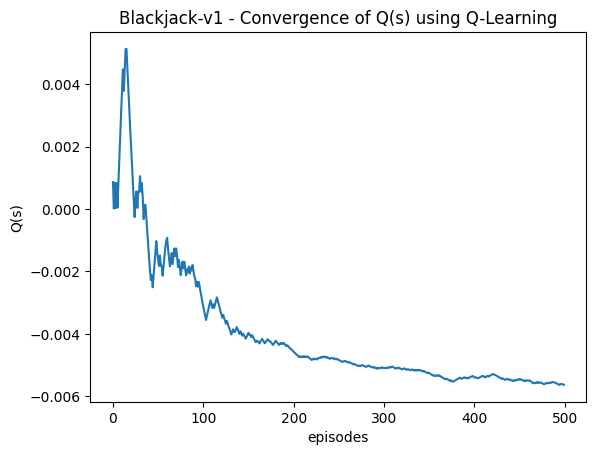

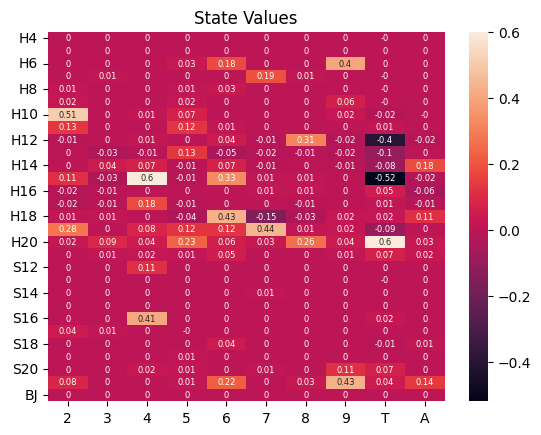

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick  stick    hit  stick  stick    hit  stick
H5   stick  stick    hit    hit  stick    hit    hit    hit  stick  stick
H6   stick    hit    hit  stick  stick  stick  stick  stick    hit  stick
H7   stick  stick  stick  stick    hit  stick  stick  stick    hit  stick
H8   stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H9   stick    hit  stick  stick  stick    hit    hit  stick    hit    hit
H10  stick    hit  stick  stick    hit  stick  stick  stick    hit    hit
H11  stick    hit    hit  stick  stick    hit  stick  stick    hit    hit
H12    hit  stick    hit    hit  stick  stick  stick    hit    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit  stick  stick    hit  stick    hit  stick    hit  stick  stick
H15  stick  stick  stick    hit  stick  stick  stick  stick    hit    hit
H16    hit  stick  stick    hit    hit

runtime = 0.18 seconds


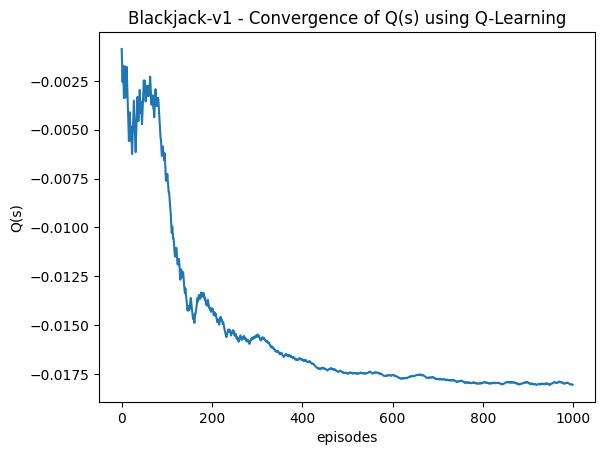

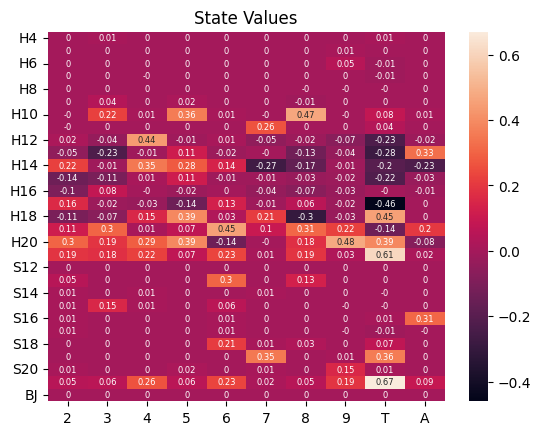

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit  stick  stick  stick    hit    hit  stick
H5     hit  stick  stick    hit  stick    hit  stick  stick    hit  stick
H6   stick  stick  stick    hit  stick  stick    hit  stick    hit    hit
H7     hit    hit    hit  stick    hit  stick    hit  stick    hit  stick
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H10    hit  stick  stick  stick  stick    hit  stick    hit    hit    hit
H11    hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H12    hit    hit  stick    hit  stick    hit    hit    hit    hit  stick
H13    hit    hit    hit  stick    hit  stick    hit    hit    hit  stick
H14  stick    hit  stick  stick  stick    hit    hit    hit    hit    hit
H15    hit    hit  stick  stick    hit    hit    hit  stick  stick    hit
H16    hit  stick    hit    hit  stick

runtime = 0.39 seconds


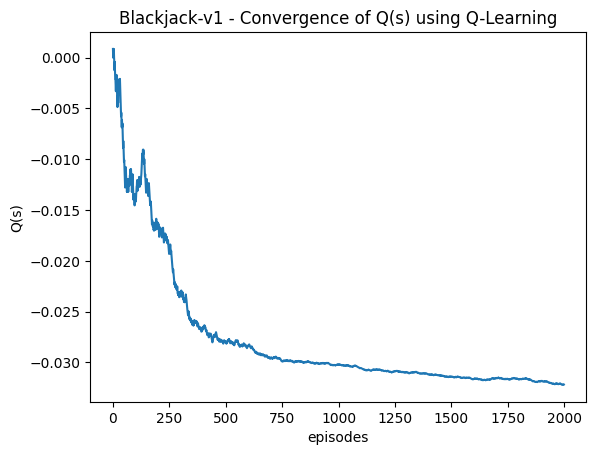

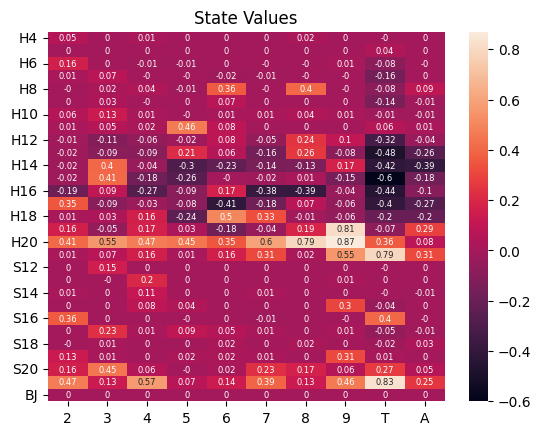

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick    hit    hit  stick    hit    hit    hit
H5   stick  stick    hit    hit    hit    hit    hit    hit    hit  stick
H6   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit  stick    hit  stick  stick  stick    hit    hit  stick
H9     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick  stick    hit  stick    hit    hit    hit
H13    hit    hit    hit  stick  stick    hit  stick    hit  stick    hit
H14    hit  stick    hit  stick    hit    hit    hit  stick    hit    hit
H15  stick  stick    hit    hit    hit  stick    hit    hit    hit    hit
H16  stick  stick  stick    hit  stick

runtime = 0.54 seconds


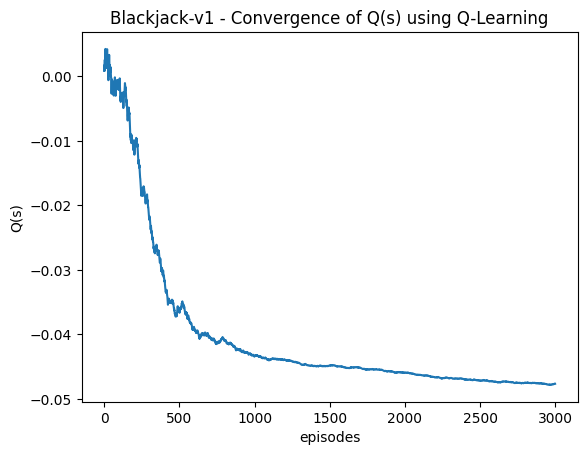

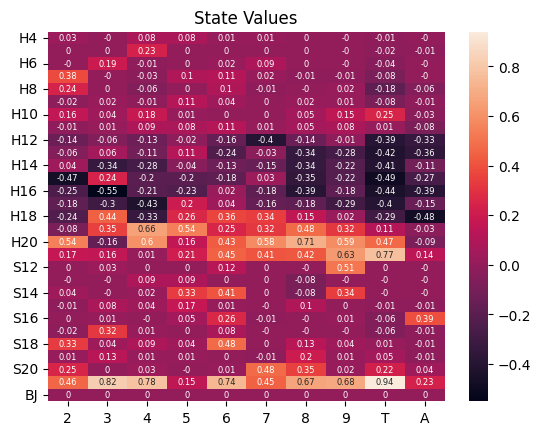

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick  stick  stick  stick    hit    hit    hit    hit
H5     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6     hit  stick    hit    hit  stick  stick    hit    hit    hit    hit
H7   stick    hit    hit  stick  stick  stick    hit    hit    hit    hit
H8   stick    hit    hit    hit    hit    hit    hit  stick    hit    hit
H9     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick  stick    hit  stick  stick    hit    hit    hit    hit    hit
H14  stick  stick    hit    hit    hit  stick    hit    hit  stick    hit
H15    hit  stick  stick  stick    hit  stick    hit    hit    hit  stick
H16  stick    hit  stick  stick  stick

runtime = 0.70 seconds


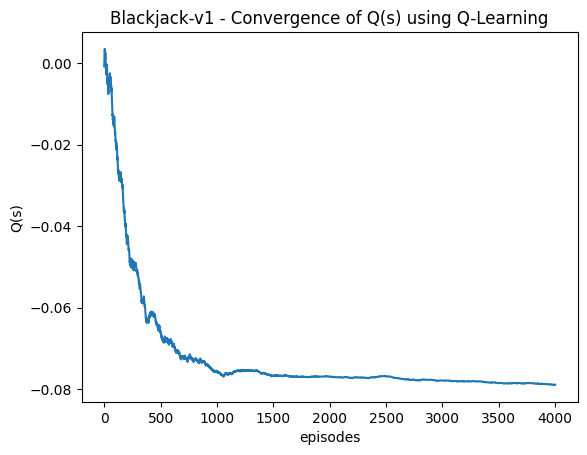

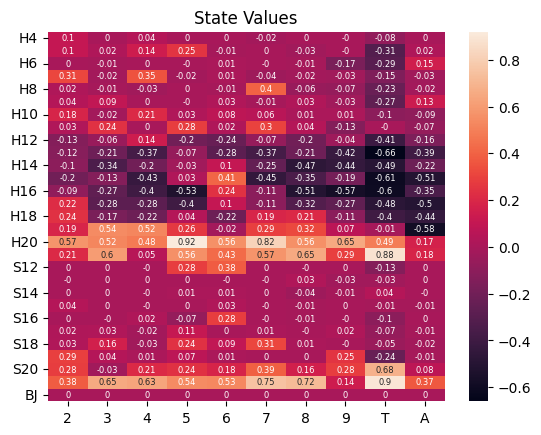

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H5   stick  stick  stick  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H7   stick    hit  stick    hit    hit    hit    hit    hit  stick    hit
H8     hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H10    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H11    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit  stick    hit
H13    hit  stick    hit    hit  stick    hit    hit    hit  stick  stick
H14    hit  stick    hit  stick  stick    hit    hit    hit    hit  stick
H15    hit    hit    hit  stick  stick    hit  stick  stick    hit    hit
H16    hit    hit    hit    hit  stick

runtime = 0.90 seconds


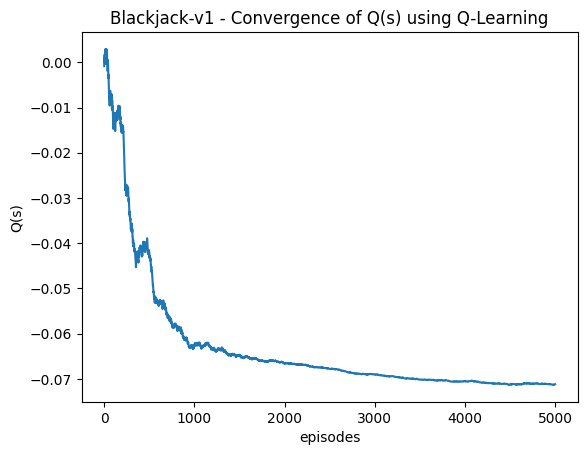

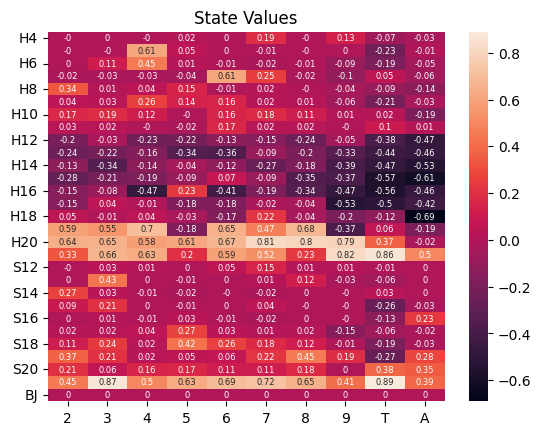

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit  stick    hit  stick    hit    hit
H5     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6     hit  stick  stick    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit  stick  stick    hit    hit  stick    hit
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick  stick  stick    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H15  stick    hit    hit  stick  stick    hit    hit    hit  stick    hit
H16  stick  stick    hit  stick  stick

runtime = 1.81 seconds


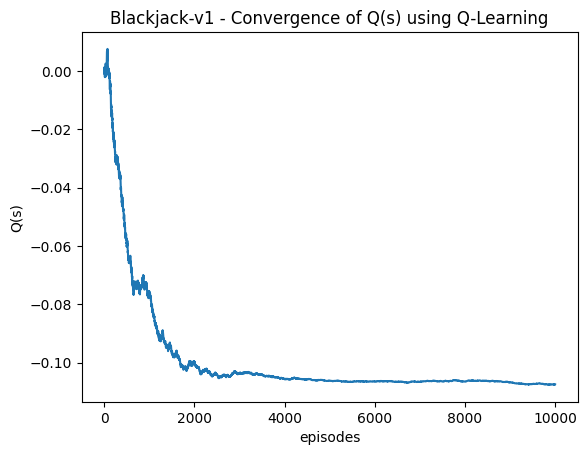

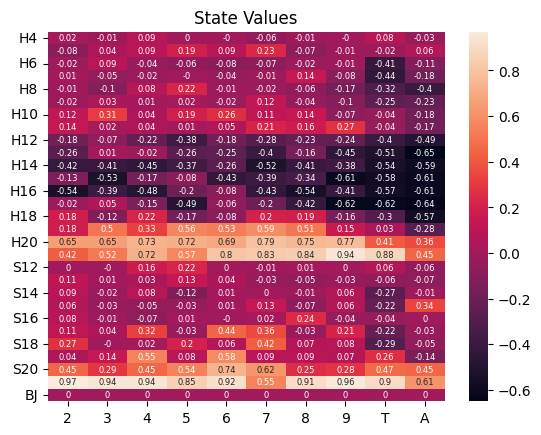

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick    hit    hit    hit    hit    hit  stick    hit
H5     hit  stick  stick  stick    hit  stick    hit    hit    hit  stick
H6     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H8     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit  stick  stick    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12  stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15  stick    hit  stick  stick    hit    hit    hit    hit  stick    hit
H16  stick    hit    hit  stick  stick

runtime = 5.67 seconds


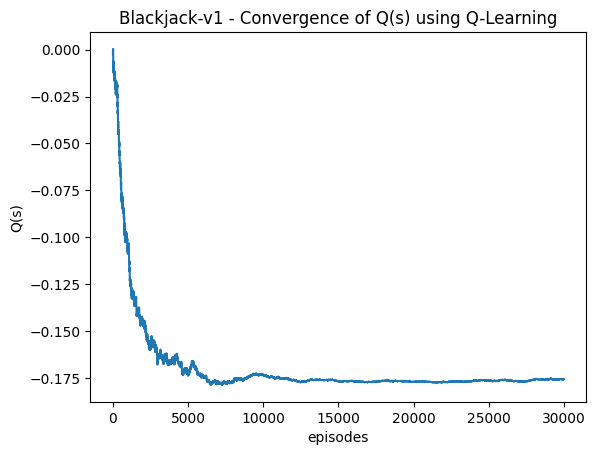

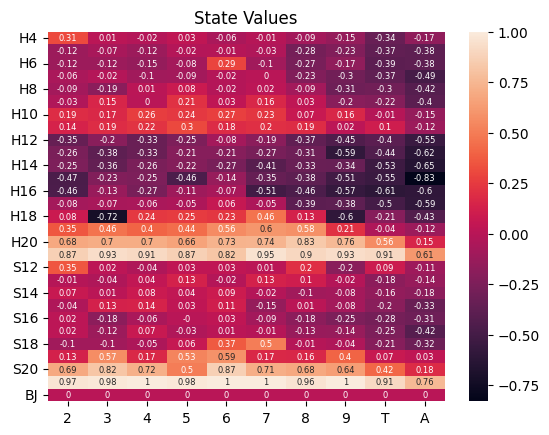

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H13  stick    hit    hit  stick    hit    hit    hit  stick    hit    hit
H14  stick    hit    hit  stick    hit  stick    hit    hit    hit    hit
H15    hit  stick  stick    hit  stick    hit    hit    hit    hit  stick
H16    hit  stick  stick  stick  stick

runtime = 11.50 seconds


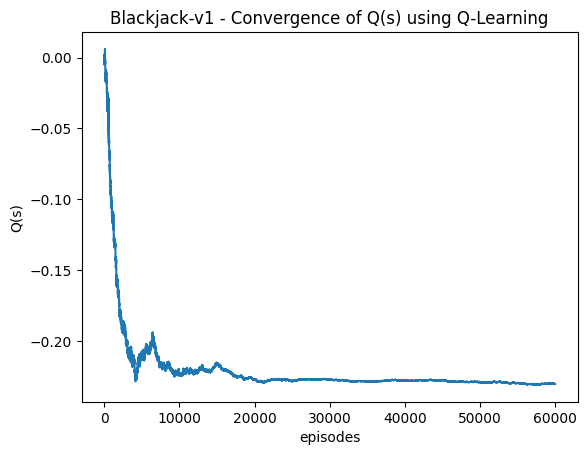

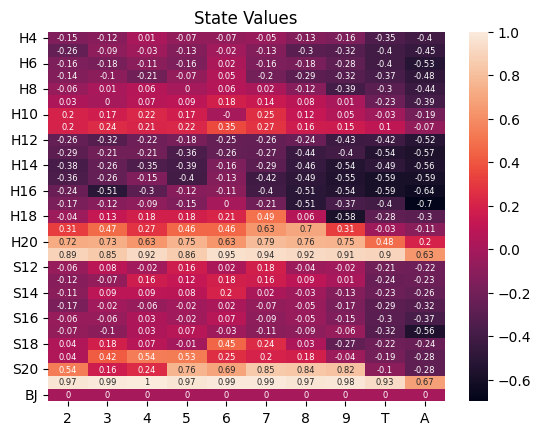

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit    hit  stick    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H14  stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H15  stick  stick  stick    hit  stick    hit  stick    hit    hit    hit
H16  stick    hit  stick  stick  stick

runtime = 17.28 seconds


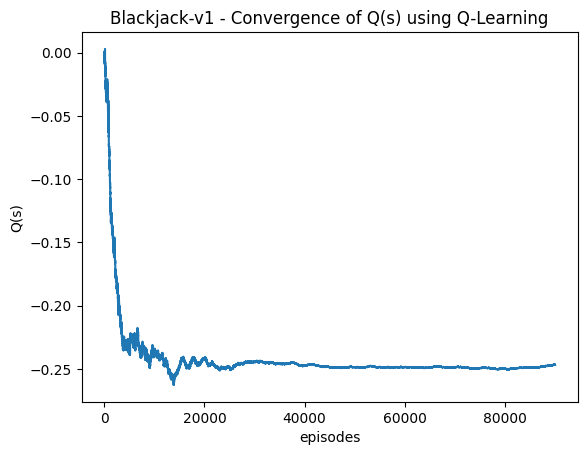

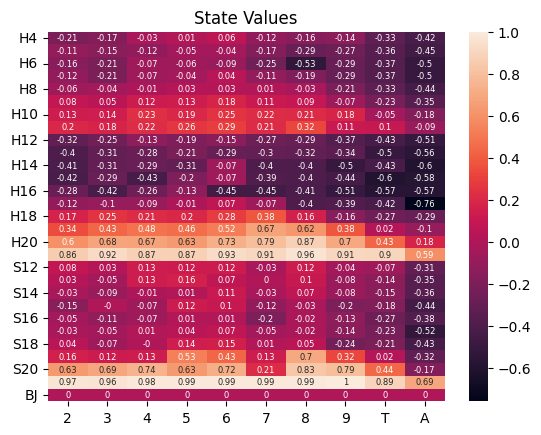

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H15    hit  stick    hit  stick  stick    hit    hit    hit    hit    hit
H16  stick    hit  stick  stick    hit

runtime = 0.10 seconds


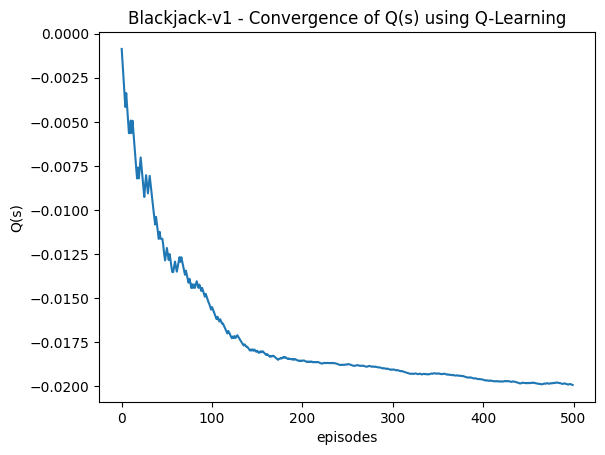

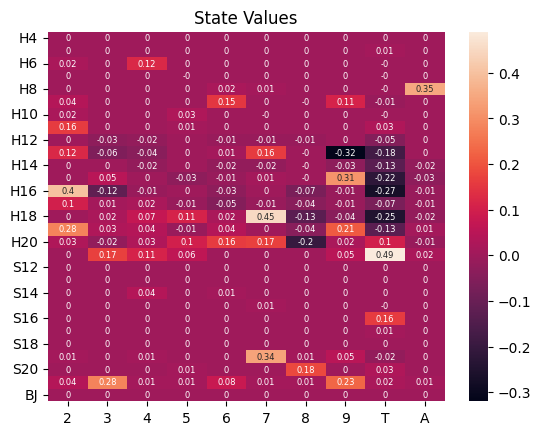

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick    hit  stick  stick  stick  stick  stick
H5   stick  stick    hit    hit  stick  stick    hit  stick  stick  stick
H6   stick  stick  stick    hit  stick    hit  stick    hit    hit  stick
H7   stick    hit    hit    hit  stick  stick    hit  stick    hit    hit
H8     hit    hit  stick    hit  stick    hit    hit    hit    hit  stick
H9   stick    hit    hit    hit  stick    hit    hit  stick    hit    hit
H10  stick  stick  stick  stick  stick    hit    hit  stick    hit    hit
H11  stick    hit    hit  stick    hit    hit    hit    hit    hit  stick
H12  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit    hit  stick  stick    hit    hit    hit    hit
H14    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H15    hit  stick    hit    hit    hit  stick    hit  stick    hit    hit
H16  stick    hit  stick    hit    hit

runtime = 0.19 seconds


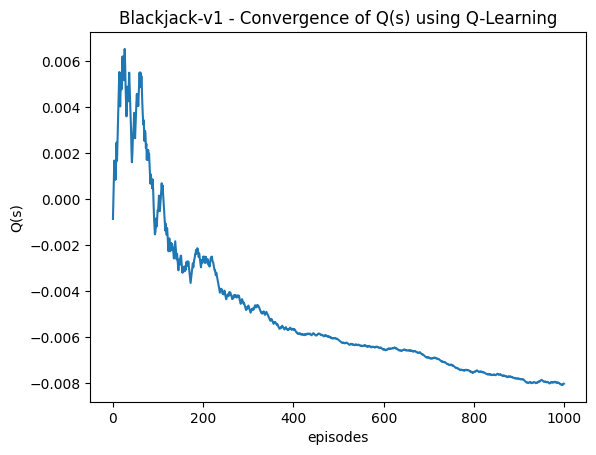

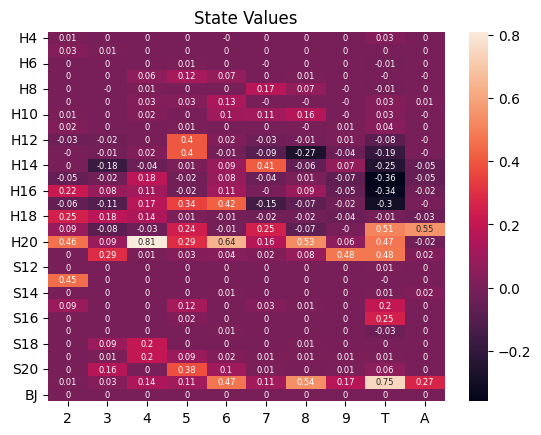

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick    hit    hit  stick  stick  stick  stick
H5   stick  stick    hit  stick  stick    hit    hit  stick    hit  stick
H6   stick  stick  stick  stick    hit    hit    hit    hit    hit    hit
H7   stick  stick  stick  stick  stick    hit  stick    hit    hit    hit
H8   stick    hit  stick  stick    hit  stick  stick    hit    hit    hit
H9     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H10    hit  stick  stick    hit    hit  stick    hit    hit    hit    hit
H11  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H13  stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H14    hit  stick    hit  stick  stick  stick    hit  stick  stick    hit
H15  stick    hit  stick    hit  stick    hit  stick    hit    hit    hit
H16  stick  stick  stick    hit  stick

runtime = 0.37 seconds


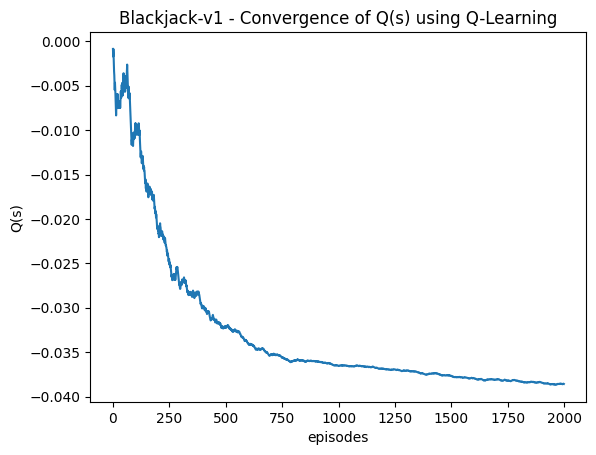

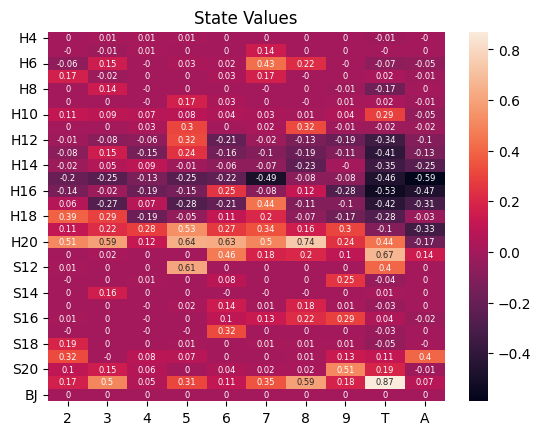

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick    hit    hit  stick    hit    hit    hit
H5     hit    hit  stick    hit  stick  stick    hit    hit    hit  stick
H6     hit  stick    hit  stick  stick  stick  stick    hit    hit    hit
H7   stick    hit    hit    hit  stick  stick    hit    hit    hit    hit
H8     hit  stick    hit  stick    hit    hit    hit    hit    hit  stick
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10  stick    hit  stick  stick  stick    hit    hit  stick    hit    hit
H11    hit    hit  stick  stick    hit    hit  stick    hit    hit    hit
H12  stick    hit  stick  stick    hit    hit    hit    hit  stick    hit
H13  stick  stick    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H15    hit    hit  stick  stick    hit  stick    hit    hit    hit    hit
H16    hit    hit    hit  stick  stick

runtime = 0.55 seconds


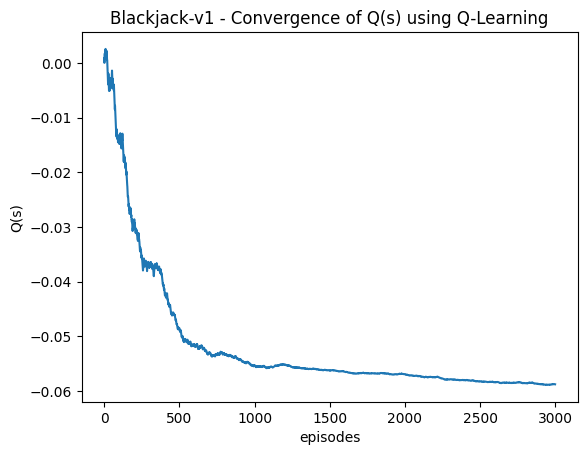

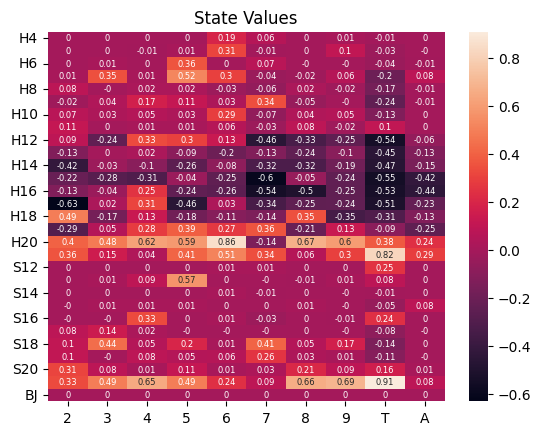

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit    hit  stick  stick  stick  stick    hit  stick
H5     hit    hit    hit  stick  stick    hit  stick  stick    hit    hit
H6     hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H7     hit  stick    hit  stick  stick    hit    hit  stick    hit  stick
H8     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H9     hit  stick  stick  stick    hit  stick    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H11    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H12  stick    hit  stick  stick    hit    hit  stick    hit  stick  stick
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit  stick  stick  stick    hit  stick    hit    hit
H15    hit  stick  stick  stick  stick    hit    hit    hit    hit    hit
H16    hit    hit  stick    hit  stick

runtime = 0.72 seconds


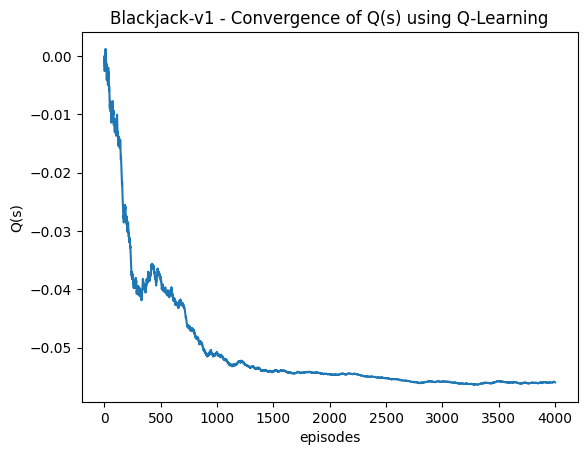

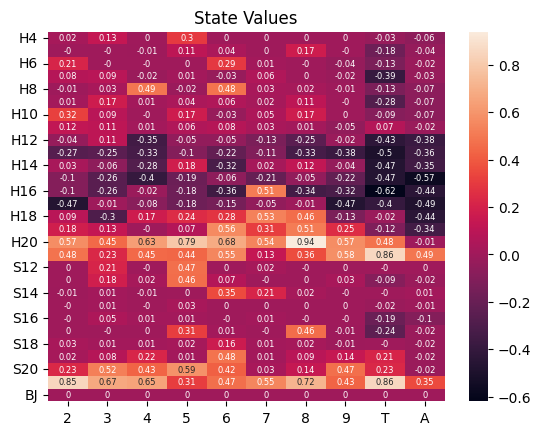

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick    hit    hit  stick  stick    hit    hit
H5     hit    hit    hit  stick  stick    hit  stick    hit    hit    hit
H6   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7   stick  stick    hit    hit    hit    hit    hit    hit    hit  stick
H8     hit    hit  stick  stick  stick  stick    hit    hit    hit    hit
H9     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H13    hit    hit  stick    hit  stick    hit  stick  stick  stick    hit
H14  stick  stick    hit  stick    hit  stick    hit  stick    hit    hit
H15  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H16  stick    hit    hit  stick  stick

runtime = 0.91 seconds


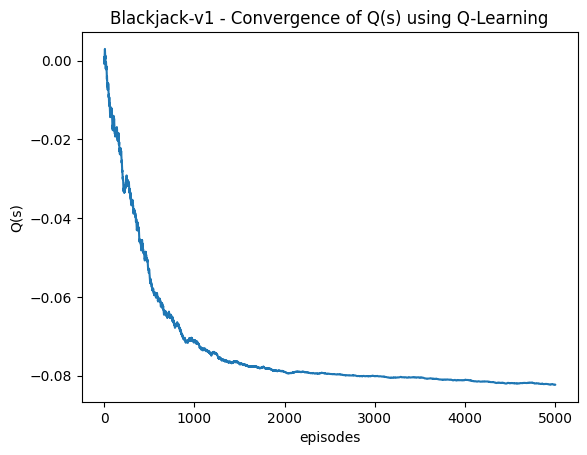

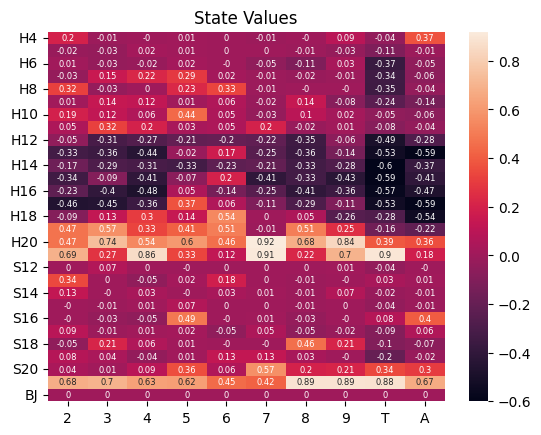

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit  stick    hit    hit    hit  stick    hit  stick
H5     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H8   stick    hit    hit  stick  stick    hit  stick    hit    hit    hit
H9     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H11    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H14  stick    hit    hit    hit    hit  stick    hit    hit  stick    hit
H15  stick  stick    hit    hit  stick    hit  stick    hit    hit    hit
H16    hit  stick  stick  stick  stick

runtime = 1.91 seconds


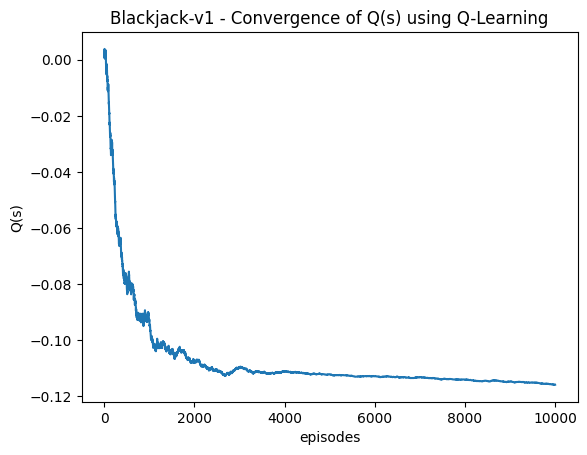

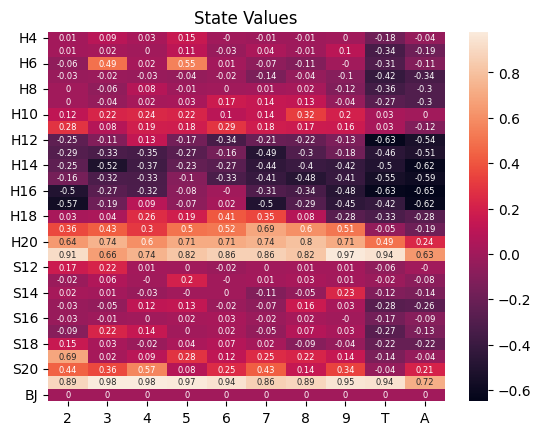

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H5     hit    hit  stick  stick    hit  stick    hit  stick    hit    hit
H6     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H7   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit  stick    hit
H13    hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H14  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H15  stick  stick    hit  stick    hit    hit  stick  stick    hit    hit
H16    hit  stick  stick  stick  stick

runtime = 5.85 seconds


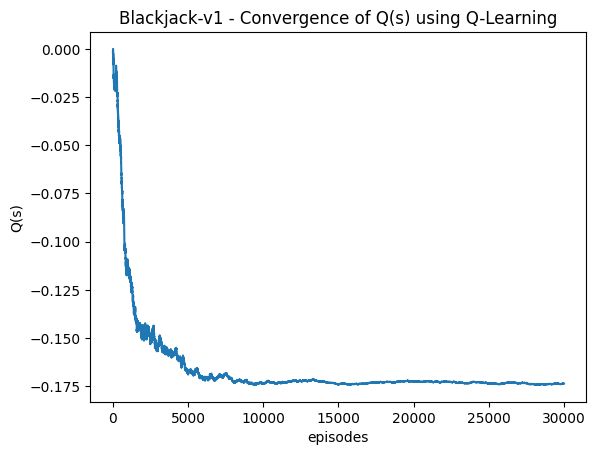

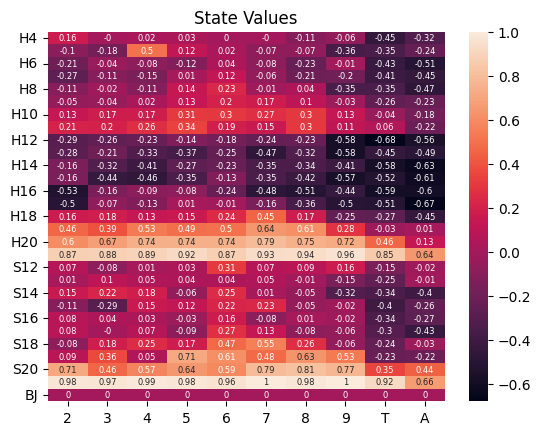

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick    hit    hit    hit    hit  stick    hit    hit
H5     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit  stick  stick    hit
H13  stick    hit    hit    hit    hit  stick    hit  stick    hit    hit
H14  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H15  stick    hit    hit    hit  stick    hit    hit  stick    hit    hit
H16    hit  stick  stick  stick  stick

runtime = 11.57 seconds


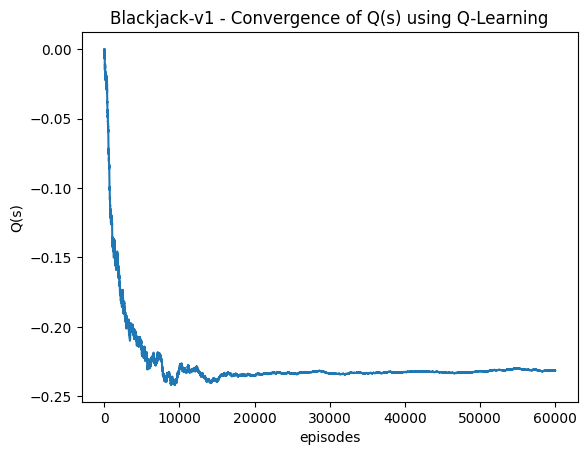

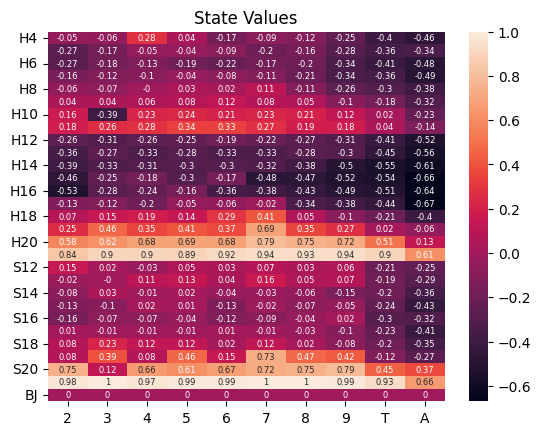

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit    hit  stick    hit
H15    hit  stick  stick  stick  stick  stick    hit  stick    hit    hit
H16    hit  stick  stick  stick    hit

runtime = 17.76 seconds


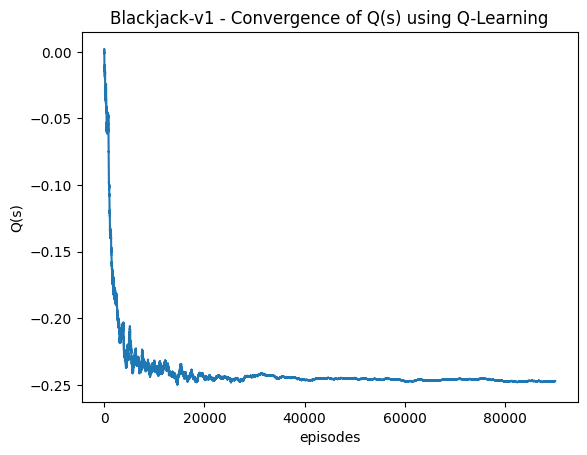

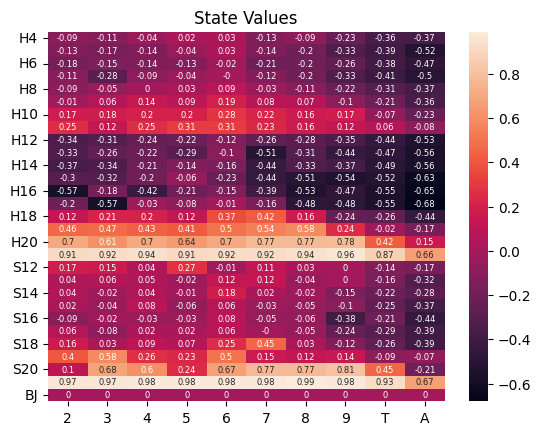

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick  stick    hit  stick  stick    hit    hit    hit    hit
H14    hit    hit  stick  stick  stick  stick    hit    hit    hit    hit
H15  stick    hit  stick  stick  stick    hit  stick  stick    hit    hit
H16    hit  stick    hit  stick  stick

runtime = 0.10 seconds


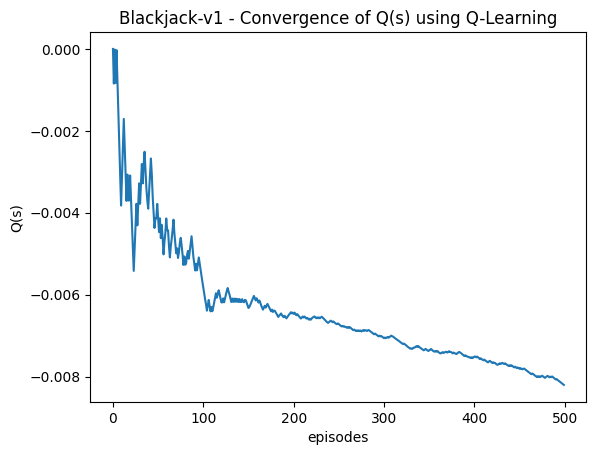

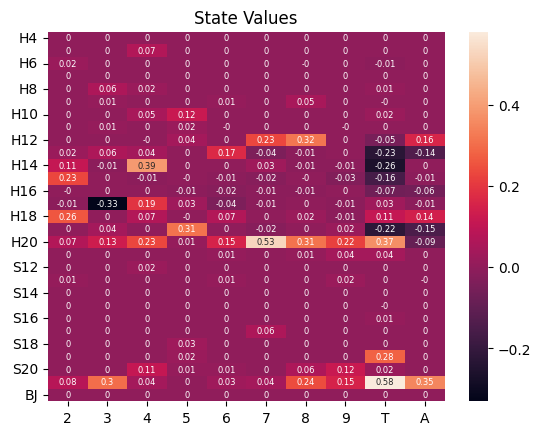

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit  stick  stick  stick  stick  stick  stick
H5   stick  stick  stick  stick  stick  stick    hit  stick    hit  stick
H6   stick  stick  stick    hit    hit    hit    hit    hit    hit  stick
H7     hit    hit  stick  stick  stick  stick    hit    hit    hit    hit
H8     hit  stick  stick    hit    hit  stick  stick  stick    hit  stick
H9     hit  stick  stick    hit  stick  stick  stick    hit    hit    hit
H10  stick  stick  stick  stick    hit  stick    hit  stick    hit    hit
H11    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit  stick  stick    hit    hit  stick
H13  stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H14  stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H15  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H16    hit  stick    hit    hit    hit

runtime = 0.19 seconds


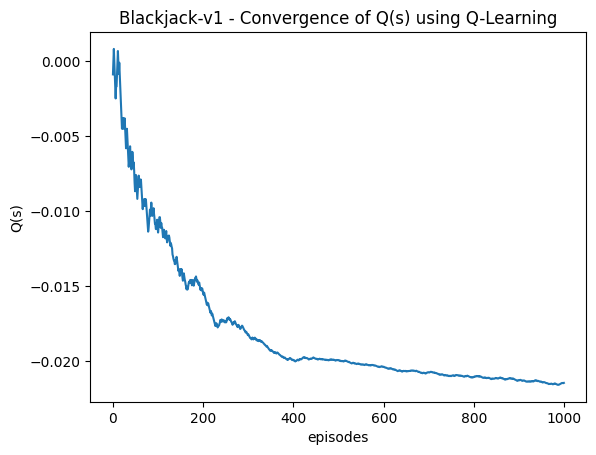

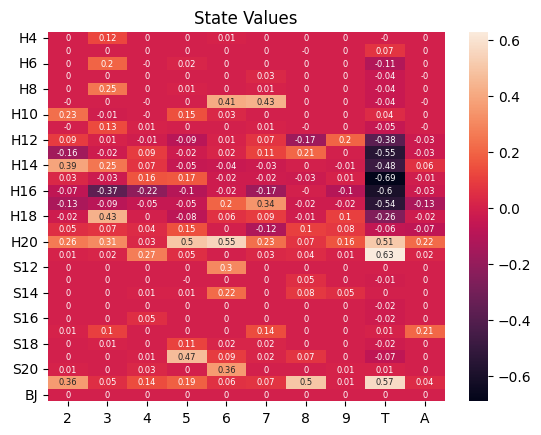

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit  stick  stick  stick  stick    hit  stick
H5   stick  stick  stick    hit  stick    hit    hit  stick  stick    hit
H6   stick  stick    hit  stick  stick    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H8   stick  stick    hit  stick    hit  stick    hit    hit    hit    hit
H9     hit    hit    hit    hit  stick  stick    hit    hit  stick    hit
H10  stick    hit    hit  stick  stick    hit    hit  stick    hit    hit
H11    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit    hit  stick  stick  stick    hit    hit
H13    hit    hit  stick    hit  stick  stick  stick    hit    hit    hit
H14  stick  stick  stick    hit    hit    hit    hit    hit    hit  stick
H15  stick    hit  stick  stick    hit    hit  stick  stick  stick    hit
H16    hit    hit    hit    hit  stick

runtime = 0.37 seconds


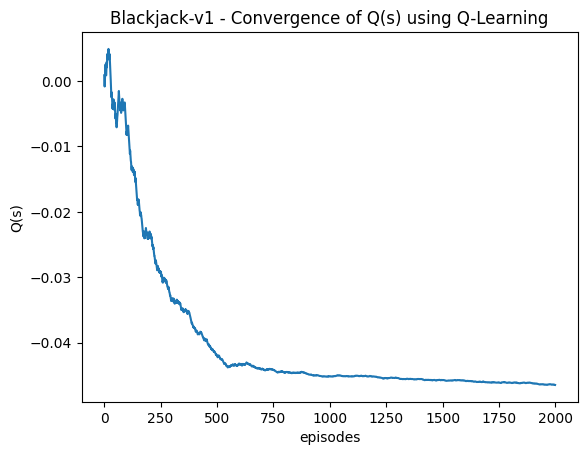

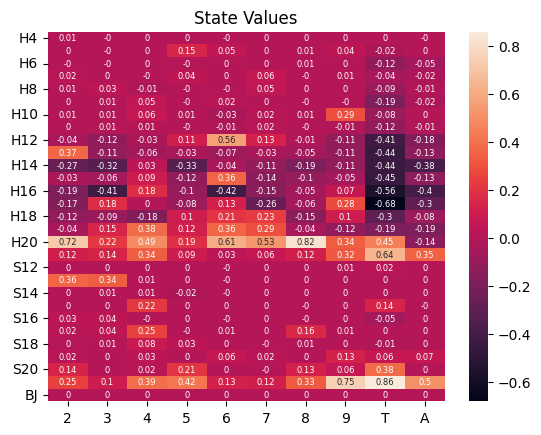

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick    hit    hit  stick  stick    hit    hit
H5   stick    hit    hit  stick  stick    hit  stick  stick    hit  stick
H6     hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H7   stick    hit    hit    hit    hit  stick    hit    hit    hit    hit
H8     hit  stick    hit    hit    hit  stick  stick    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick  stick  stick    hit    hit  stick    hit
H13  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick    hit    hit    hit    hit    hit    hit  stick
H15  stick    hit  stick  stick  stick    hit    hit    hit    hit    hit
H16  stick    hit  stick    hit  stick

runtime = 0.56 seconds


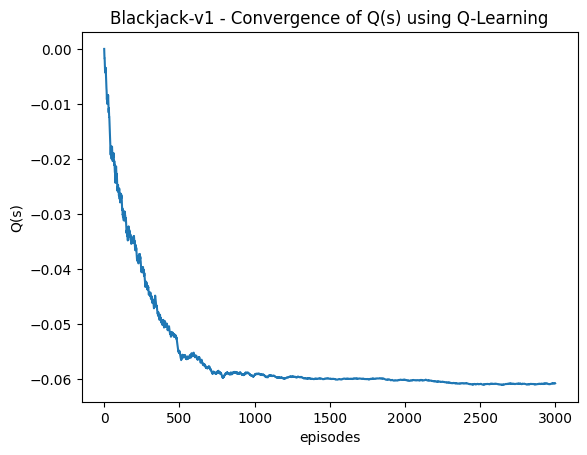

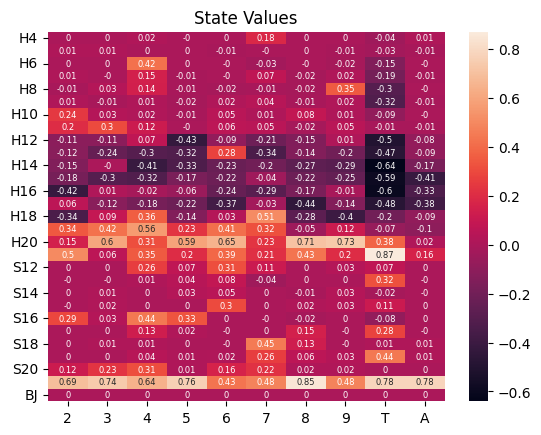

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit  stick  stick    hit  stick    hit  stick
H5     hit  stick    hit  stick    hit    hit    hit    hit  stick    hit
H6     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit    hit  stick    hit  stick    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H11  stick  stick    hit    hit    hit  stick    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit  stick    hit  stick
H13    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H14    hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H15    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H16    hit  stick    hit  stick  stick

runtime = 0.74 seconds


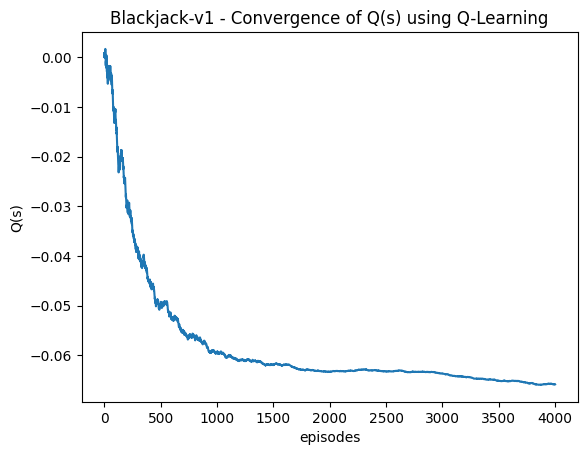

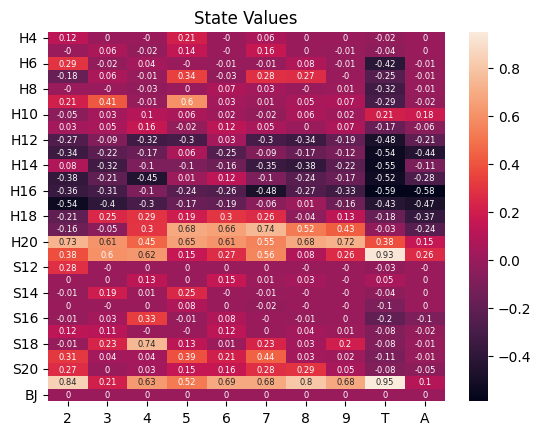

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit  stick    hit  stick    hit  stick    hit    hit
H5     hit  stick    hit  stick    hit    hit    hit    hit  stick    hit
H6   stick    hit  stick    hit    hit    hit  stick    hit    hit  stick
H7     hit  stick    hit  stick    hit  stick  stick    hit    hit    hit
H8     hit    hit    hit    hit  stick    hit    hit    hit    hit  stick
H9   stick  stick  stick  stick    hit    hit  stick    hit    hit    hit
H10    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit  stick
H14  stick    hit    hit    hit    hit  stick    hit    hit    hit    hit
H15  stick  stick    hit  stick  stick    hit  stick    hit    hit    hit
H16    hit  stick  stick  stick  stick

runtime = 0.93 seconds


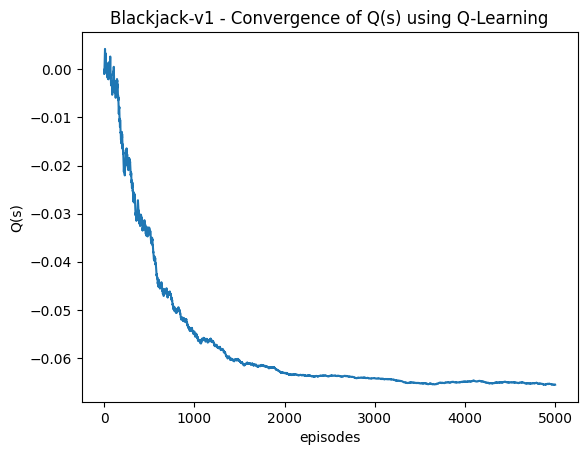

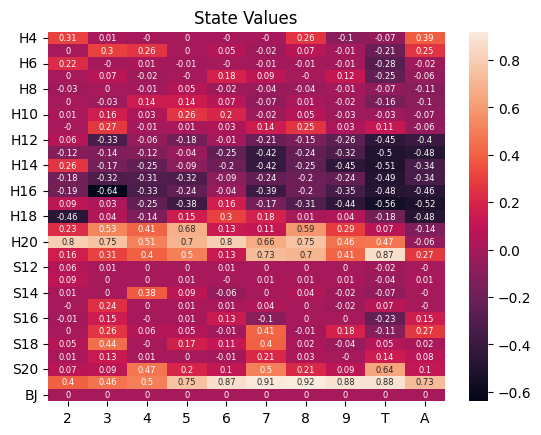

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit    hit    hit    hit  stick    hit    hit  stick
H5     hit  stick  stick    hit    hit    hit  stick    hit    hit  stick
H6   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit  stick  stick    hit    hit  stick    hit    hit
H8     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H9     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H14  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H15    hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H16  stick    hit  stick  stick  stick

runtime = 1.88 seconds


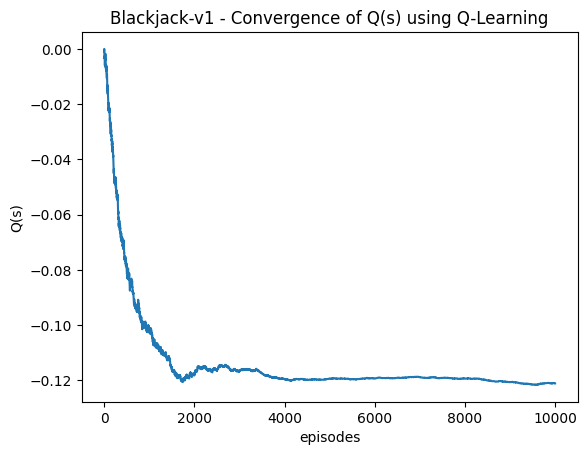

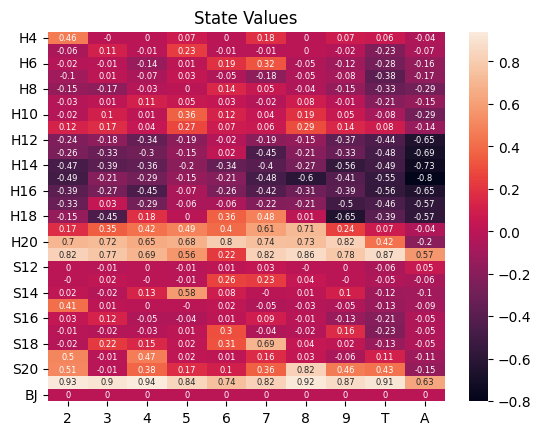

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit  stick    hit  stick    hit  stick  stick    hit
H5     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H7     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H14    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H15    hit  stick  stick  stick  stick  stick  stick    hit    hit    hit
H16  stick  stick    hit  stick  stick

runtime = 5.98 seconds


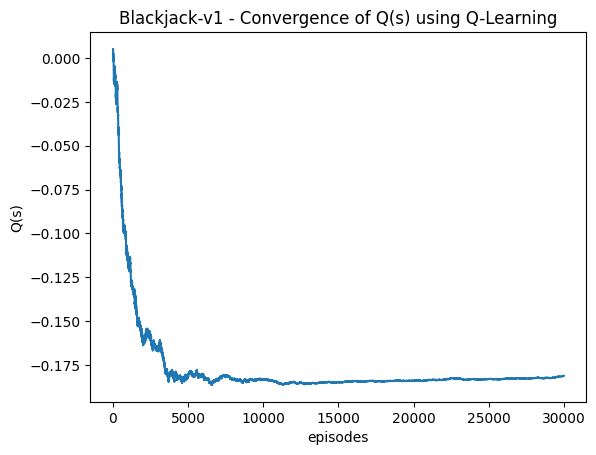

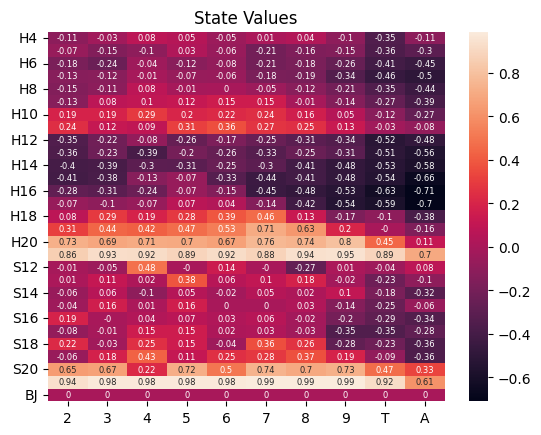

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick  stick    hit  stick    hit    hit    hit    hit
H5     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit    hit  stick    hit
H15  stick    hit  stick  stick    hit    hit    hit  stick    hit    hit
H16  stick  stick  stick  stick  stick

runtime = 11.59 seconds


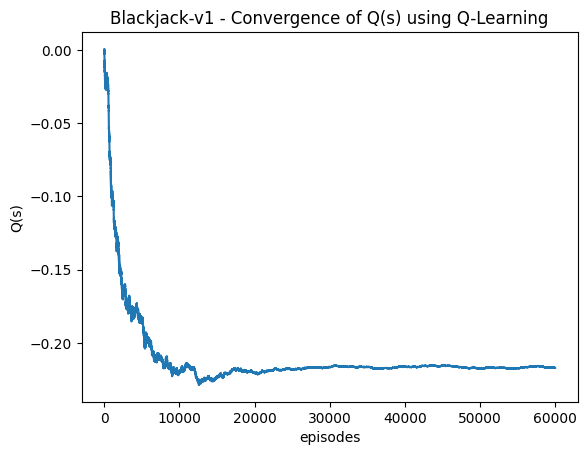

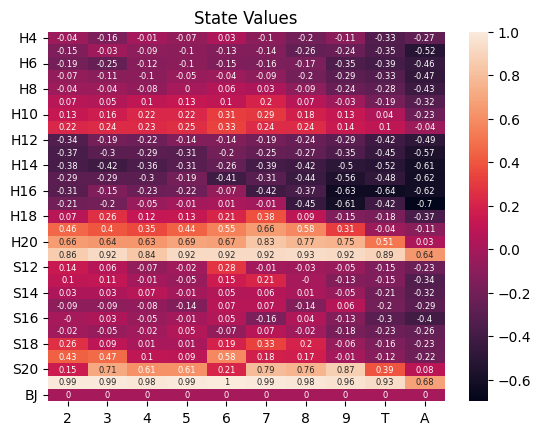

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15  stick    hit  stick  stick    hit    hit  stick    hit    hit    hit
H16  stick  stick  stick  stick  stick

runtime = 17.35 seconds


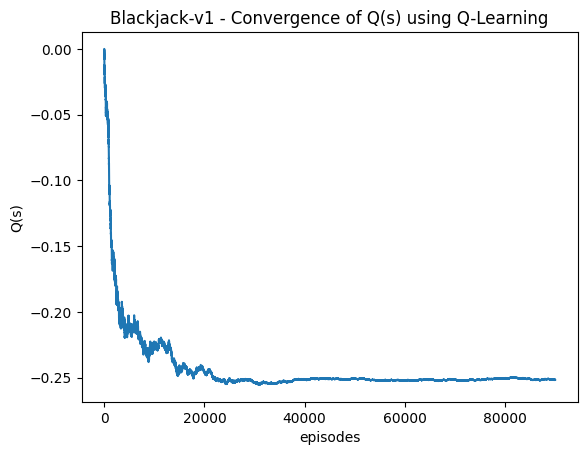

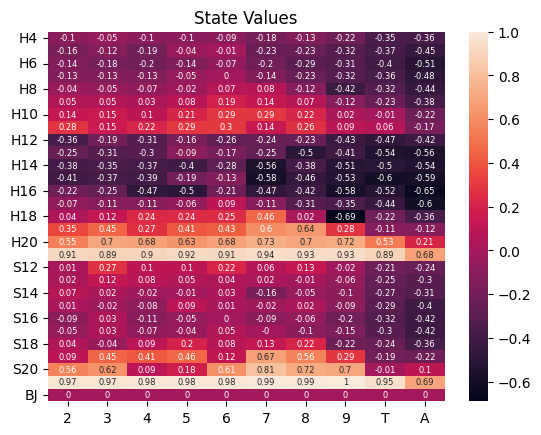

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit  stick  stick    hit  stick    hit    hit    hit
H14    hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H15  stick    hit    hit  stick  stick  stick    hit    hit    hit    hit
H16  stick  stick    hit    hit  stick

runtime = 0.10 seconds


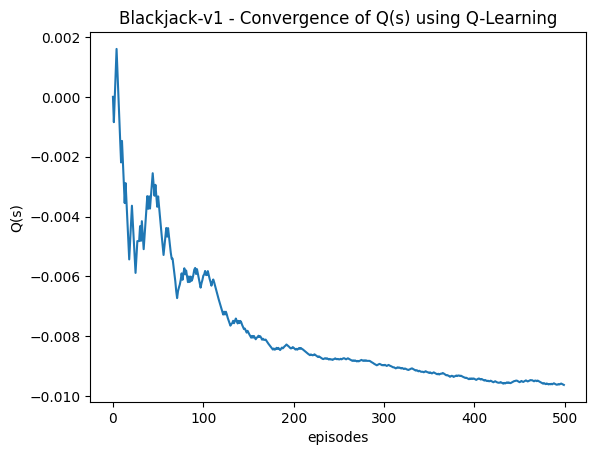

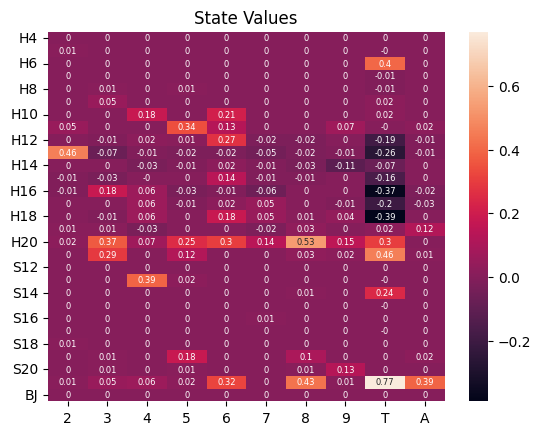

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick  stick  stick    hit  stick
H5     hit    hit    hit  stick  stick  stick  stick  stick    hit  stick
H6   stick  stick    hit  stick    hit    hit  stick    hit  stick    hit
H7   stick  stick    hit    hit    hit    hit    hit    hit    hit  stick
H8     hit  stick  stick  stick  stick  stick  stick  stick    hit    hit
H9     hit    hit    hit    hit    hit  stick    hit    hit  stick  stick
H10  stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H11  stick    hit    hit  stick  stick    hit    hit  stick  stick  stick
H12  stick    hit  stick  stick  stick    hit    hit    hit    hit    hit
H13  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit  stick    hit  stick  stick    hit    hit    hit  stick    hit
H15    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H16    hit  stick  stick    hit    hit

runtime = 0.19 seconds


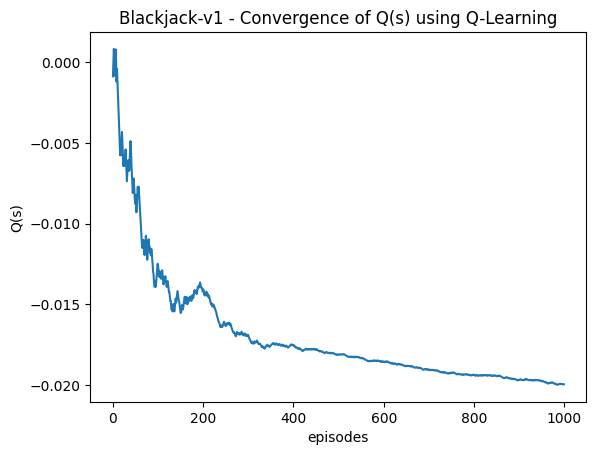

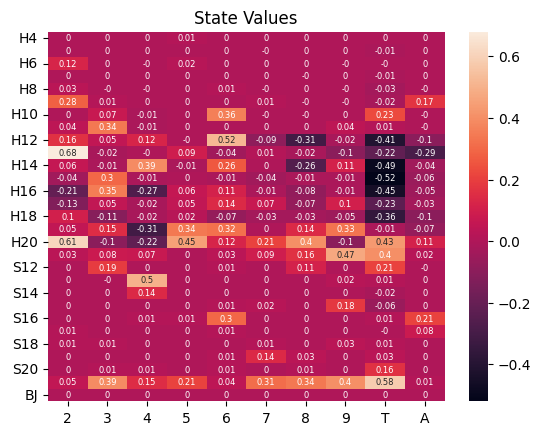

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick    hit  stick  stick  stick  stick
H5   stick  stick    hit  stick    hit    hit    hit  stick    hit  stick
H6   stick  stick    hit  stick    hit    hit    hit    hit    hit    hit
H7     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9   stick    hit  stick    hit    hit  stick    hit    hit    hit  stick
H10    hit  stick    hit    hit  stick    hit    hit    hit  stick    hit
H11  stick  stick    hit    hit  stick    hit    hit    hit    hit    hit
H12  stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H13  stick  stick    hit  stick    hit  stick    hit    hit    hit    hit
H14  stick    hit  stick    hit  stick    hit    hit  stick    hit    hit
H15    hit  stick  stick    hit    hit    hit    hit    hit  stick    hit
H16  stick  stick    hit  stick  stick

runtime = 0.39 seconds


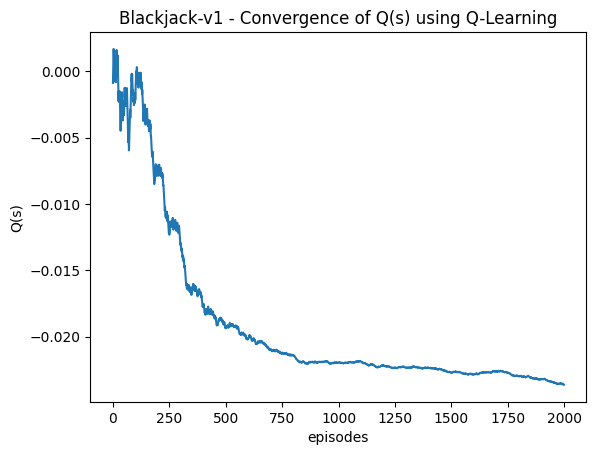

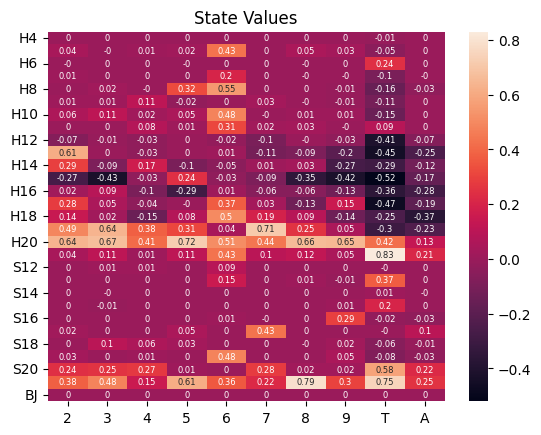

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit    hit    hit    hit  stick    hit  stick
H5   stick    hit    hit    hit  stick    hit  stick  stick    hit    hit
H6     hit    hit    hit    hit    hit    hit  stick    hit  stick  stick
H7     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit  stick  stick  stick  stick    hit    hit    hit    hit    hit
H9     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H11  stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit    hit    hit  stick    hit    hit    hit    hit
H14  stick    hit  stick    hit    hit    hit  stick    hit    hit    hit
H15    hit  stick  stick  stick    hit    hit    hit    hit    hit  stick
H16    hit  stick    hit    hit  stick

runtime = 0.58 seconds


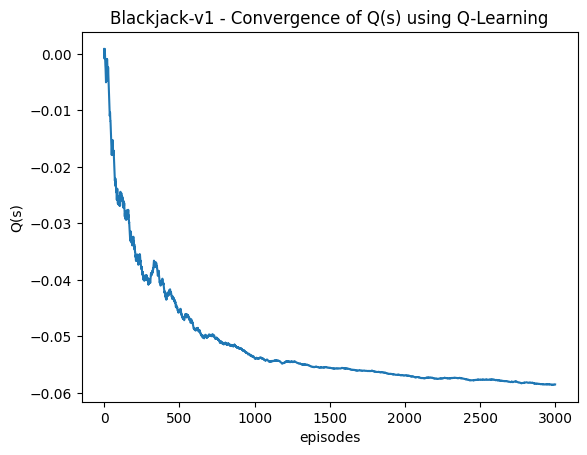

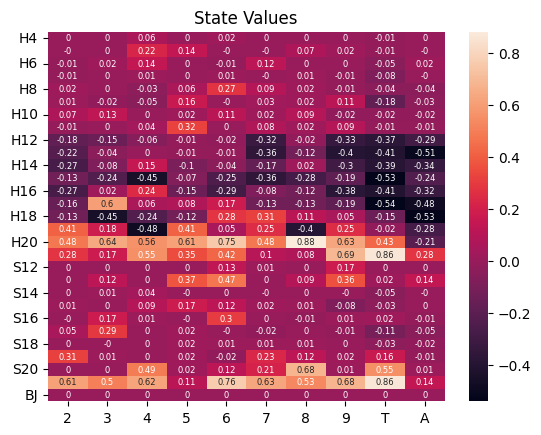

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H5     hit    hit  stick  stick    hit    hit  stick  stick    hit    hit
H6     hit  stick  stick    hit    hit  stick    hit    hit    hit  stick
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit  stick  stick  stick    hit    hit    hit    hit
H9     hit    hit    hit  stick    hit    hit    hit  stick    hit    hit
H10    hit  stick    hit    hit    hit    hit  stick    hit    hit    hit
H11    hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit  stick  stick    hit  stick    hit    hit    hit
H14  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H15    hit    hit  stick    hit    hit    hit  stick    hit    hit    hit
H16    hit  stick  stick    hit    hit

runtime = 0.87 seconds


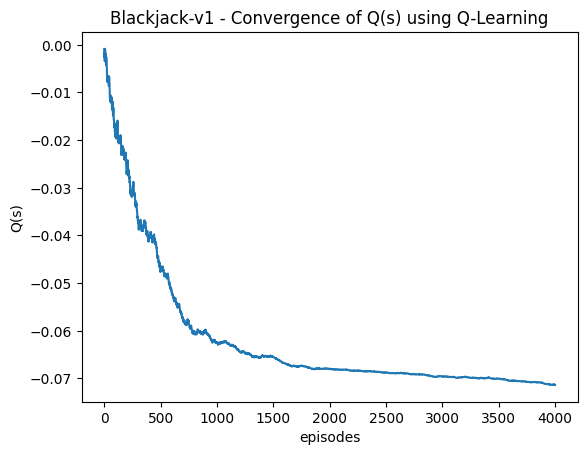

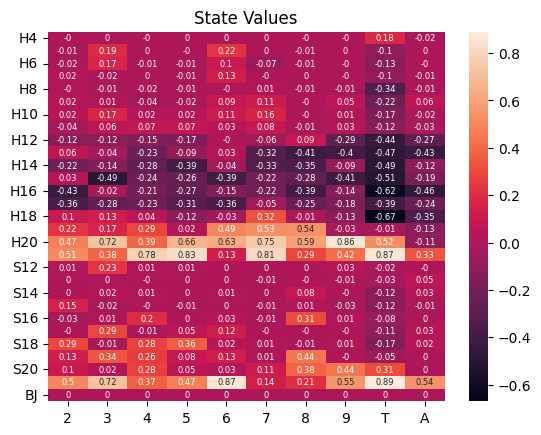

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit    hit    hit    hit  stick    hit
H5     hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H13  stick  stick    hit    hit  stick    hit  stick    hit    hit    hit
H14    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H15  stick    hit    hit    hit    hit    hit    hit  stick    hit    hit
H16    hit  stick  stick    hit  stick

runtime = 0.89 seconds


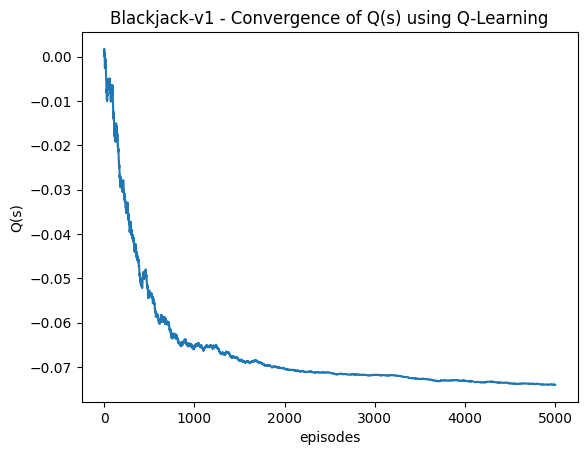

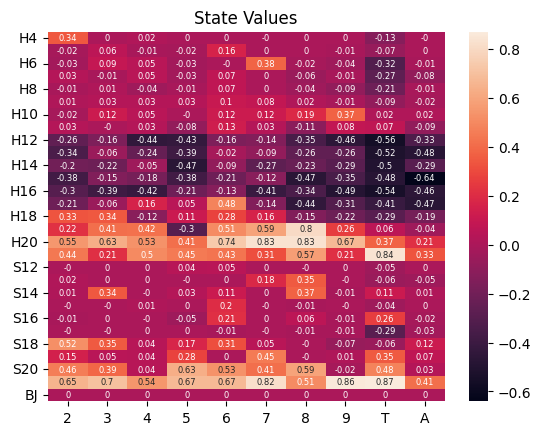

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H5     hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H6     hit  stick    hit    hit    hit  stick    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit  stick  stick  stick    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit  stick    hit
H14  stick  stick  stick    hit  stick    hit    hit    hit  stick  stick
H15  stick  stick    hit  stick    hit    hit  stick    hit    hit  stick
H16  stick    hit    hit  stick  stick

runtime = 1.79 seconds


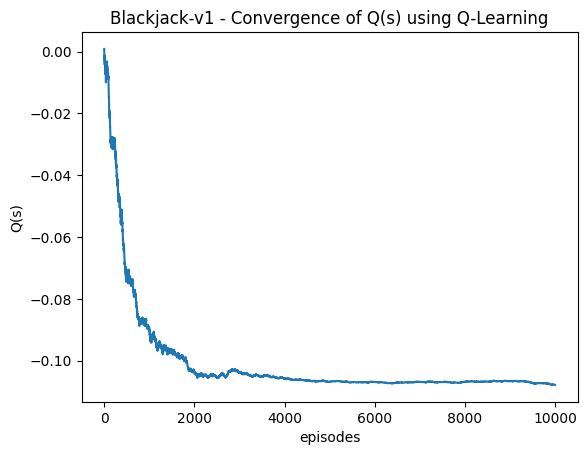

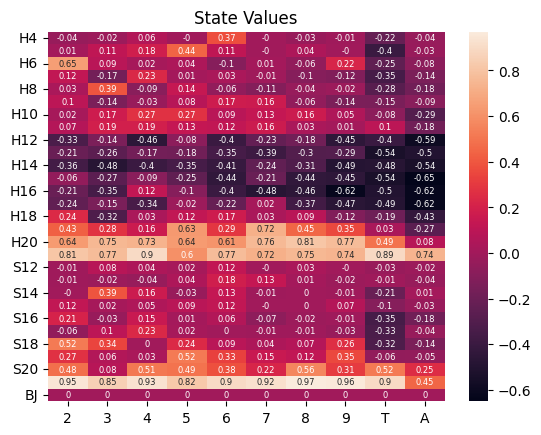

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H5     hit  stick  stick  stick  stick    hit  stick    hit    hit    hit
H6   stick  stick    hit    hit    hit    hit    hit  stick    hit    hit
H7   stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H8     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12  stick  stick    hit    hit  stick    hit    hit    hit    hit    hit
H13    hit  stick  stick  stick    hit  stick    hit  stick    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15  stick  stick  stick  stick    hit  stick  stick  stick    hit    hit
H16    hit  stick  stick  stick    hit

runtime = 5.60 seconds


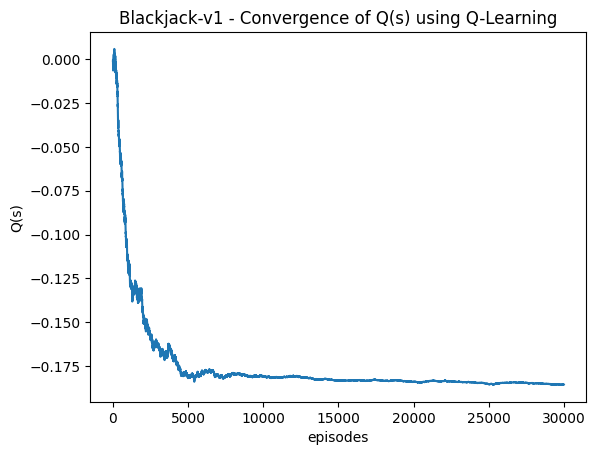

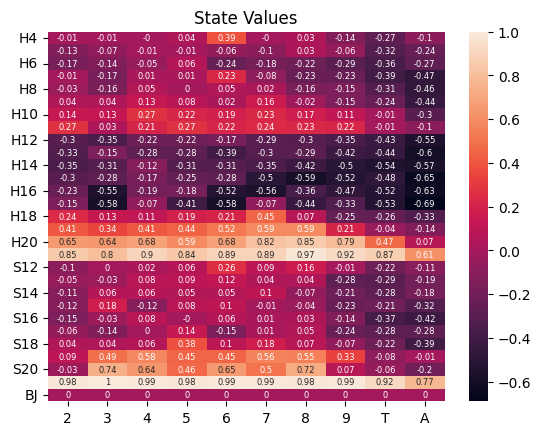

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H6     hit    hit    hit  stick    hit    hit  stick    hit    hit    hit
H7     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick    hit    hit    hit    hit  stick    hit    hit
H15  stick  stick  stick  stick    hit  stick  stick  stick    hit    hit
H16  stick    hit  stick  stick    hit

runtime = 11.69 seconds


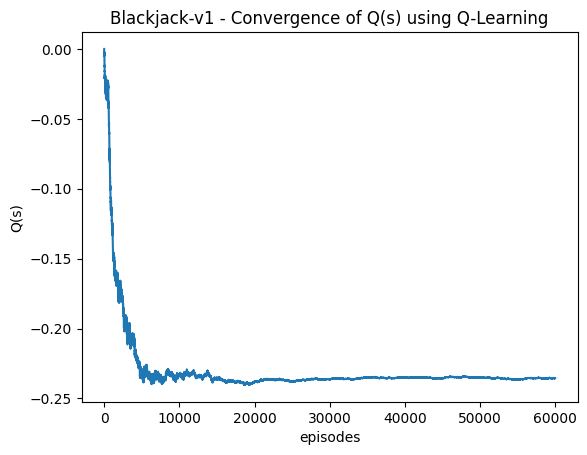

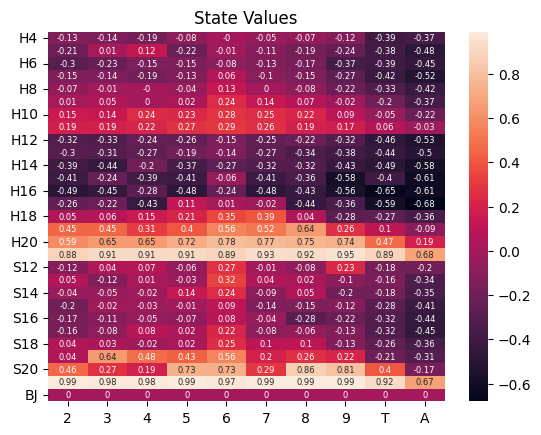

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H14    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H15    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H16    hit    hit  stick    hit  stick

runtime = 17.40 seconds


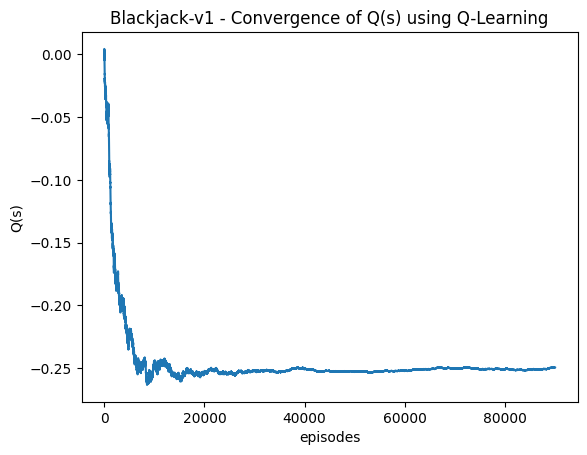

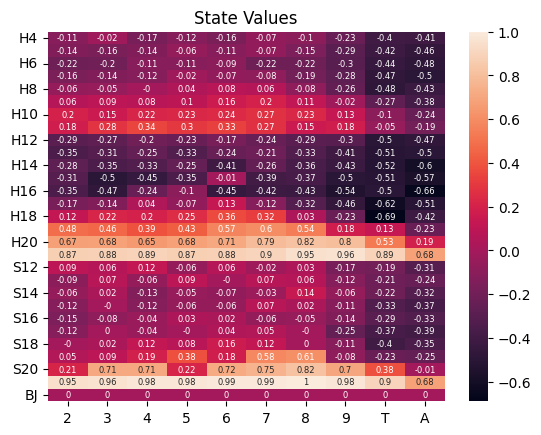

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15    hit    hit    hit    hit  stick    hit    hit    hit  stick    hit
H16  stick    hit  stick  stick    hit

runtime = 0.10 seconds


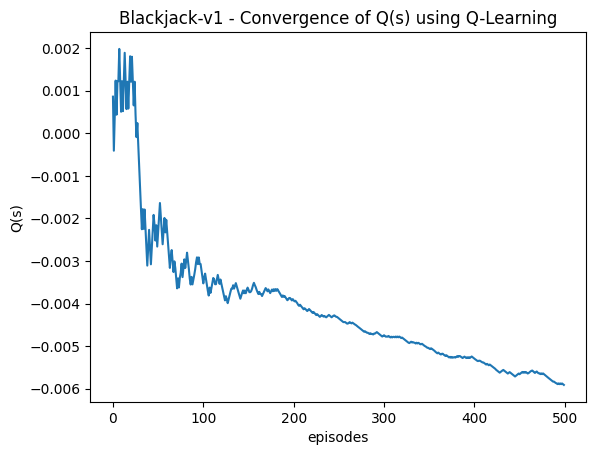

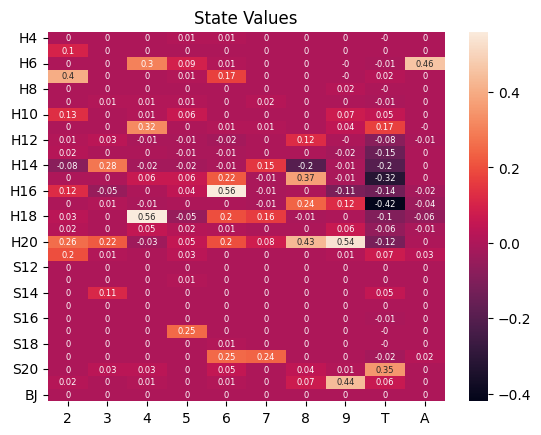

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick  stick  stick  stick  stick    hit  stick
H5   stick  stick    hit  stick    hit  stick  stick  stick  stick  stick
H6   stick  stick  stick  stick  stick  stick    hit    hit    hit  stick
H7   stick  stick    hit  stick  stick    hit    hit    hit  stick  stick
H8     hit  stick    hit    hit  stick  stick  stick  stick    hit    hit
H9   stick  stick  stick  stick    hit  stick    hit  stick    hit    hit
H10  stick    hit  stick  stick    hit  stick    hit  stick  stick    hit
H11    hit    hit  stick  stick    hit  stick    hit  stick  stick    hit
H12    hit  stick    hit    hit  stick    hit  stick    hit    hit    hit
H13  stick    hit    hit    hit    hit  stick  stick    hit  stick    hit
H14    hit  stick    hit    hit    hit  stick    hit    hit    hit    hit
H15  stick    hit  stick  stick  stick  stick  stick    hit    hit  stick
H16  stick    hit    hit  stick  stick

runtime = 0.19 seconds


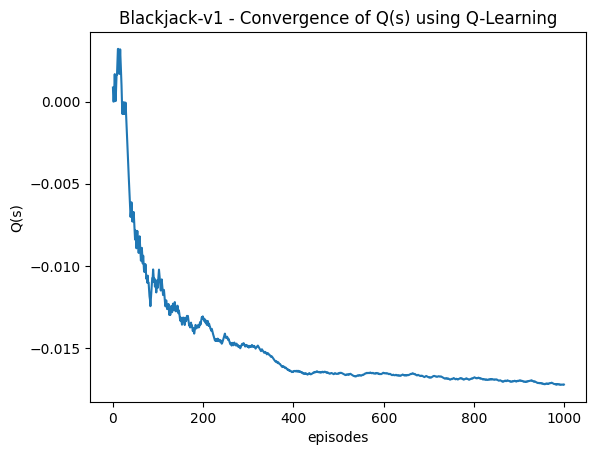

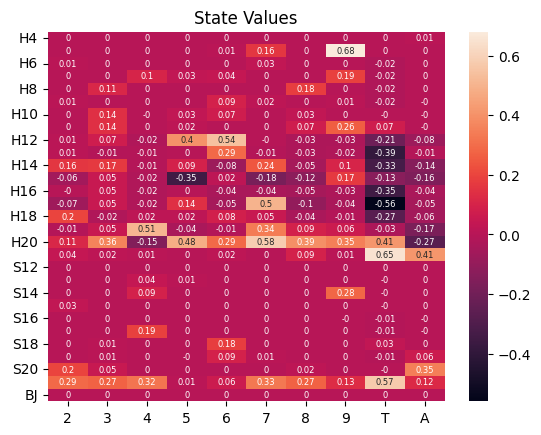

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick  stick  stick    hit  stick
H5   stick    hit    hit  stick  stick  stick    hit  stick    hit  stick
H6   stick  stick  stick    hit    hit  stick    hit    hit    hit    hit
H7     hit    hit  stick  stick  stick    hit    hit  stick    hit  stick
H8   stick  stick    hit  stick    hit  stick  stick    hit    hit  stick
H9     hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H10  stick    hit    hit  stick  stick    hit  stick    hit    hit    hit
H11    hit  stick    hit  stick    hit  stick  stick  stick    hit    hit
H12  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H13    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H14  stick  stick    hit  stick    hit  stick    hit  stick    hit    hit
H15    hit  stick    hit    hit  stick    hit    hit  stick    hit    hit
H16  stick  stick    hit  stick    hit

runtime = 0.37 seconds


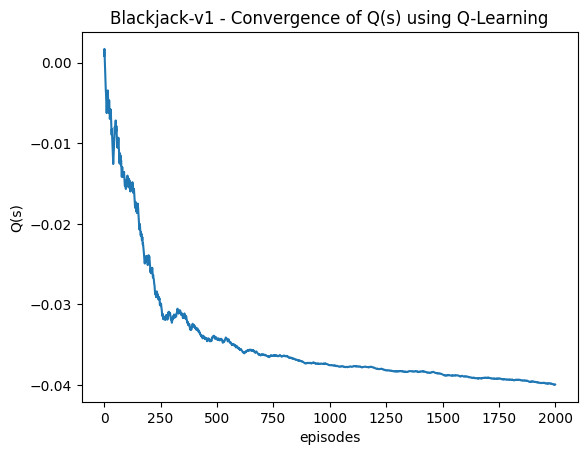

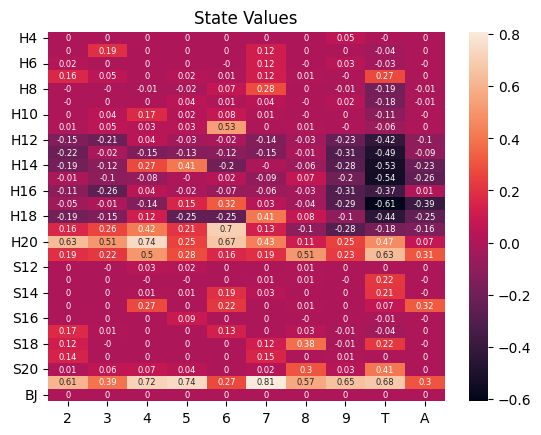

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit  stick  stick  stick  stick  stick    hit    hit
H5     hit  stick    hit  stick    hit  stick    hit    hit    hit  stick
H6   stick    hit    hit    hit    hit  stick    hit  stick    hit    hit
H7   stick  stick    hit  stick    hit  stick    hit    hit  stick    hit
H8     hit    hit    hit    hit  stick  stick  stick    hit    hit    hit
H9     hit    hit    hit    hit    hit  stick    hit  stick    hit    hit
H10    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H15    hit    hit    hit    hit    hit    hit  stick    hit  stick    hit
H16    hit    hit  stick    hit    hit

runtime = 0.54 seconds


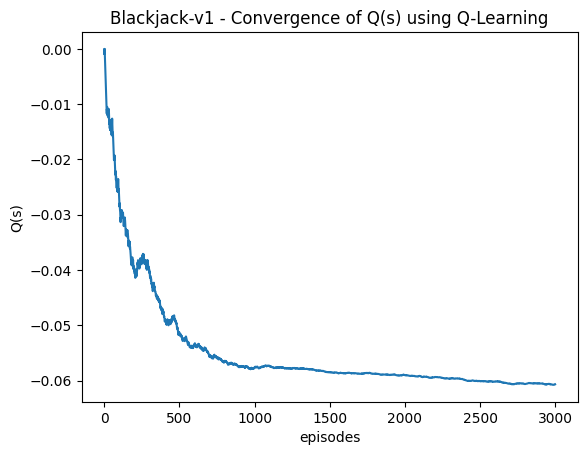

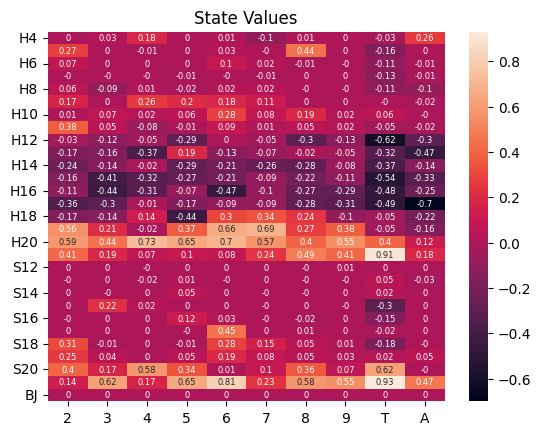

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick    hit  stick  stick    hit  stick
H5   stick    hit    hit    hit  stick    hit  stick    hit    hit    hit
H6   stick    hit    hit    hit  stick  stick    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H8   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9   stick    hit  stick  stick  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit    hit    hit    hit    hit  stick    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit  stick    hit
H13    hit  stick    hit  stick    hit    hit    hit    hit  stick    hit
H14    hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H15    hit  stick  stick  stick  stick    hit    hit    hit    hit  stick
H16  stick    hit  stick  stick    hit

runtime = 0.74 seconds


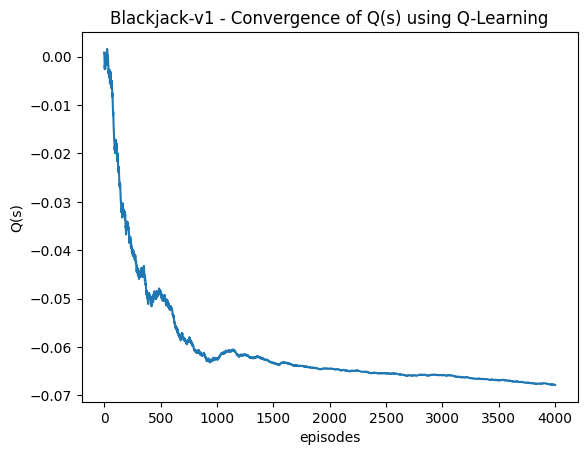

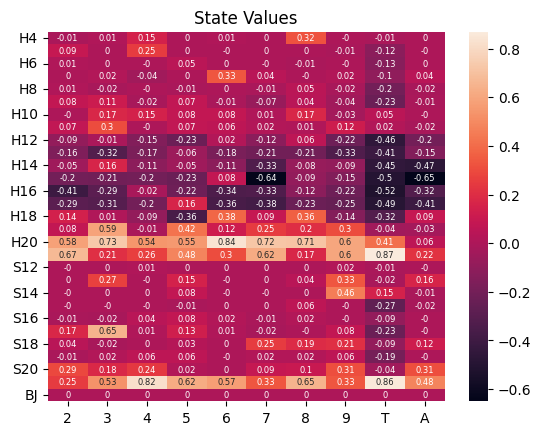

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick    hit  stick    hit  stick    hit    hit  stick
H5   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6   stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H10    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit  stick    hit    hit  stick    hit    hit    hit    hit
H14  stick  stick    hit    hit  stick  stick  stick    hit    hit    hit
H15    hit  stick    hit    hit  stick    hit    hit  stick    hit    hit
H16    hit    hit  stick    hit    hit

runtime = 1.02 seconds


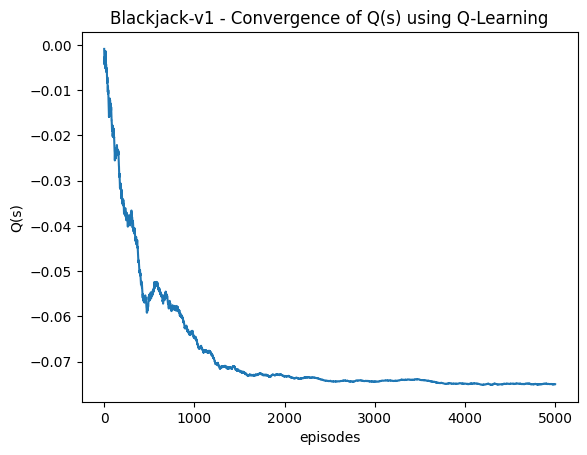

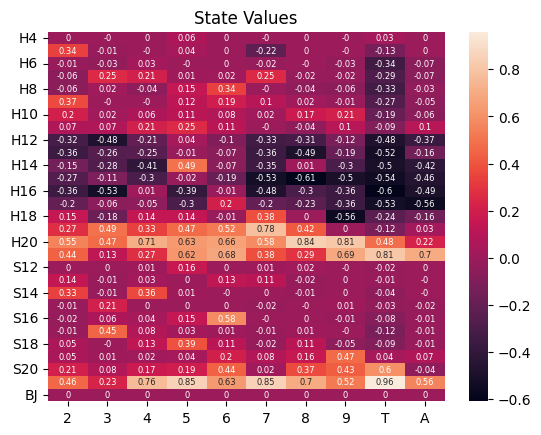

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit    hit    hit    hit  stick    hit
H5   stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit  stick  stick    hit  stick  stick    hit    hit    hit    hit
H8     hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H9   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit    hit  stick    hit    hit    hit    hit
H11    hit  stick  stick    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit  stick    hit    hit  stick  stick    hit  stick
H15  stick  stick    hit    hit    hit    hit    hit    hit  stick    hit
H16    hit    hit  stick    hit  stick

runtime = 1.85 seconds


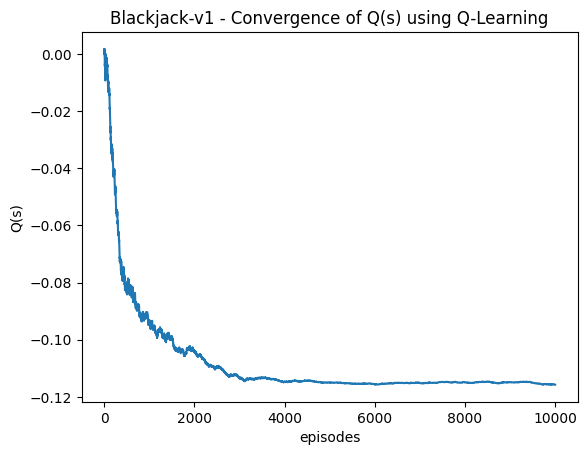

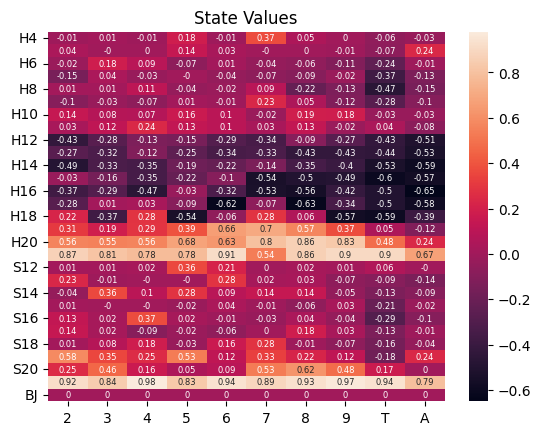

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit  stick    hit  stick  stick    hit    hit    hit
H5   stick    hit    hit  stick  stick    hit    hit    hit    hit  stick
H6   stick  stick  stick    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit  stick  stick    hit    hit    hit    hit  stick    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick  stick    hit    hit    hit  stick    hit    hit
H13    hit    hit  stick  stick    hit    hit  stick    hit    hit    hit
H14    hit  stick    hit  stick  stick  stick    hit    hit  stick    hit
H15  stick  stick    hit  stick  stick    hit    hit  stick    hit    hit
H16  stick  stick    hit  stick  stick

runtime = 6.05 seconds


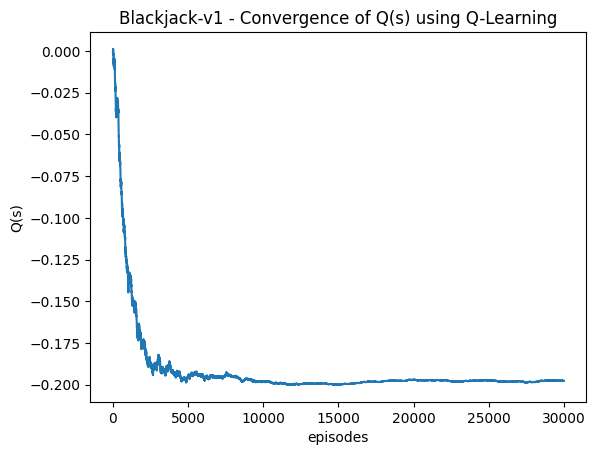

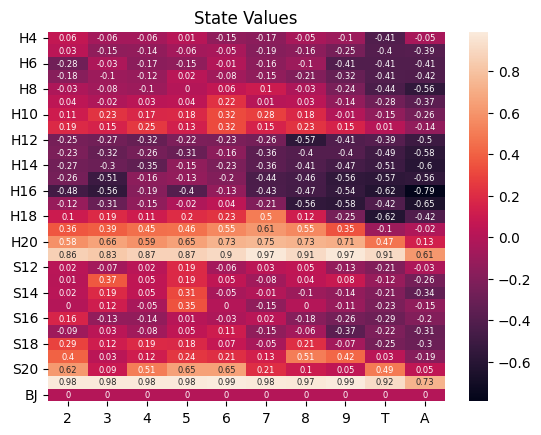

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H13  stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H14  stick  stick    hit  stick    hit    hit    hit    hit    hit    hit
H15  stick    hit  stick  stick  stick    hit    hit  stick    hit    hit
H16    hit    hit  stick    hit  stick

runtime = 11.80 seconds


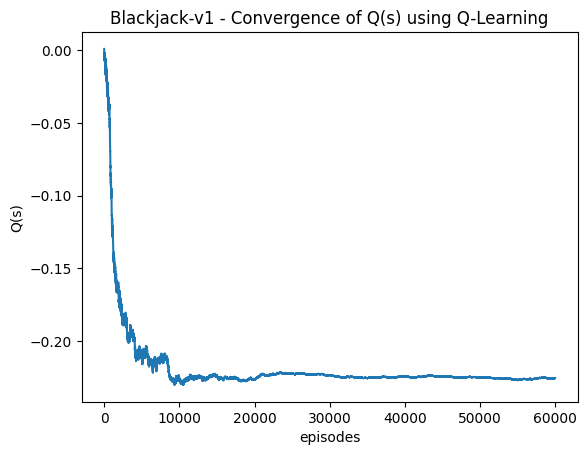

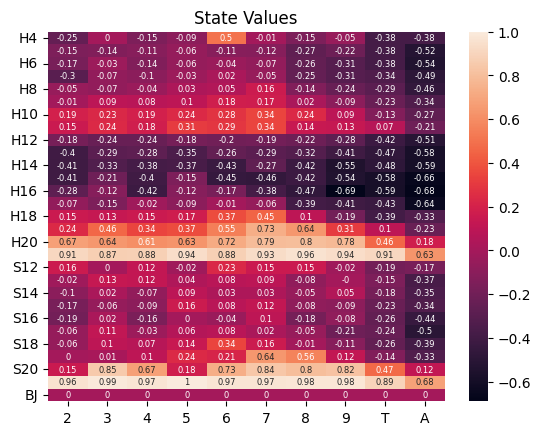

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H15    hit  stick    hit  stick    hit    hit    hit  stick  stick    hit
H16  stick  stick    hit  stick  stick

runtime = 17.42 seconds


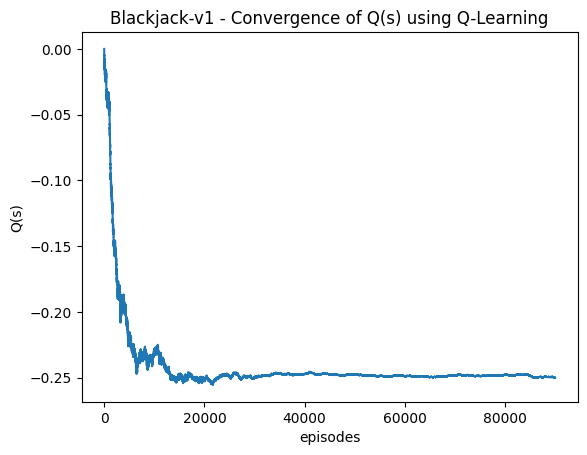

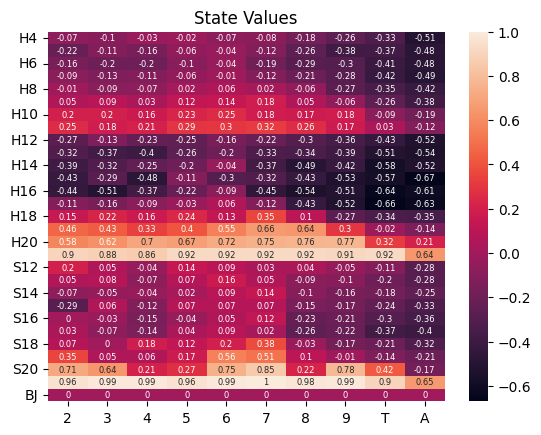

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H15    hit  stick    hit  stick  stick    hit  stick    hit    hit    hit
H16  stick    hit    hit  stick  stick

runtime = 0.10 seconds


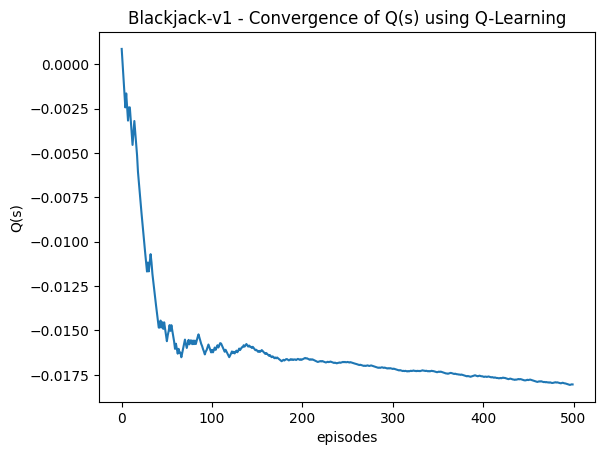

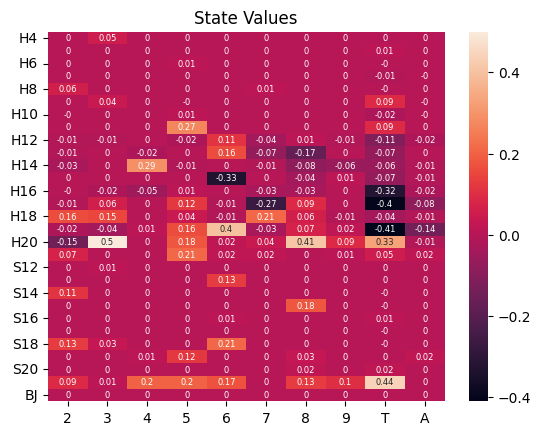

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick  stick    hit    hit  stick    hit  stick
H5   stick    hit  stick  stick  stick  stick  stick    hit  stick  stick
H6   stick  stick    hit  stick  stick  stick    hit    hit    hit  stick
H7   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H8   stick  stick  stick  stick  stick  stick    hit    hit    hit  stick
H9   stick  stick    hit    hit    hit    hit  stick    hit  stick    hit
H10    hit    hit    hit  stick    hit    hit  stick    hit    hit    hit
H11    hit    hit    hit  stick    hit  stick    hit    hit  stick    hit
H12    hit    hit    hit    hit  stick    hit    hit  stick    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H14    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H15    hit    hit    hit  stick    hit    hit    hit  stick  stick    hit
H16    hit    hit    hit  stick  stick

runtime = 0.20 seconds


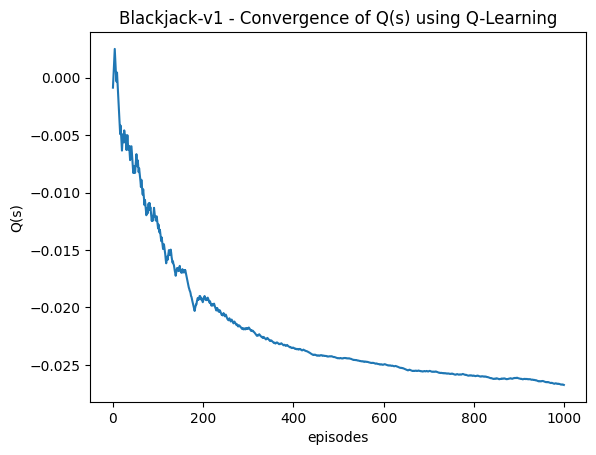

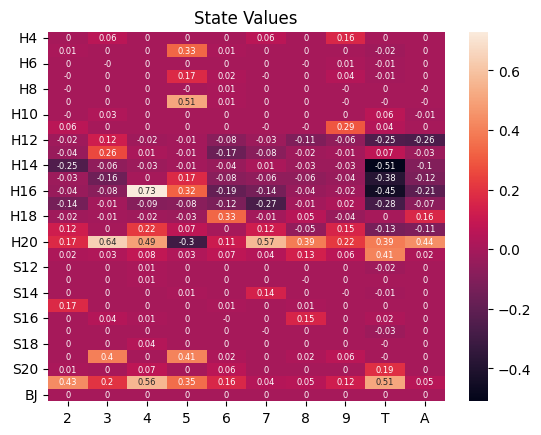

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick    hit    hit  stick    hit  stick    hit  stick
H5   stick  stick  stick  stick  stick  stick  stick    hit    hit  stick
H6   stick    hit  stick  stick  stick  stick    hit    hit    hit    hit
H7     hit    hit    hit  stick  stick    hit  stick  stick    hit  stick
H8     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H9     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit    hit  stick  stick    hit    hit  stick    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit  stick    hit    hit    hit    hit  stick    hit
H14    hit    hit    hit  stick  stick  stick    hit  stick  stick    hit
H15    hit  stick    hit  stick    hit    hit    hit    hit  stick    hit
H16    hit    hit  stick  stick  stick

runtime = 0.42 seconds


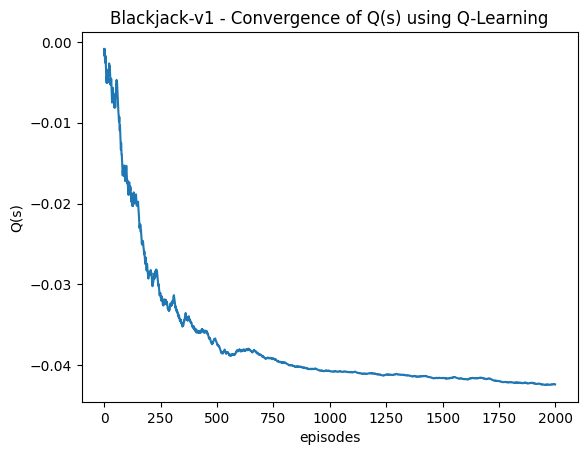

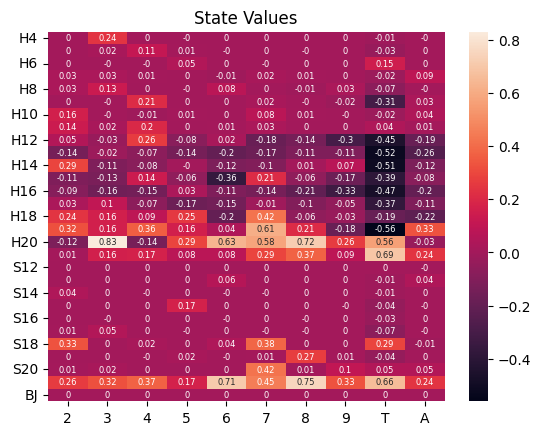

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit  stick    hit    hit  stick  stick  stick  stick
H7     hit  stick    hit    hit    hit    hit  stick    hit    hit    hit
H8     hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H9     hit    hit  stick    hit    hit  stick    hit    hit    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit  stick    hit  stick    hit    hit    hit    hit    hit
H12  stick    hit  stick    hit  stick    hit    hit    hit  stick    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit  stick    hit
H14  stick  stick    hit  stick    hit    hit    hit  stick    hit    hit
H15  stick  stick  stick    hit    hit  stick    hit  stick  stick    hit
H16  stick    hit    hit  stick    hit

runtime = 0.56 seconds


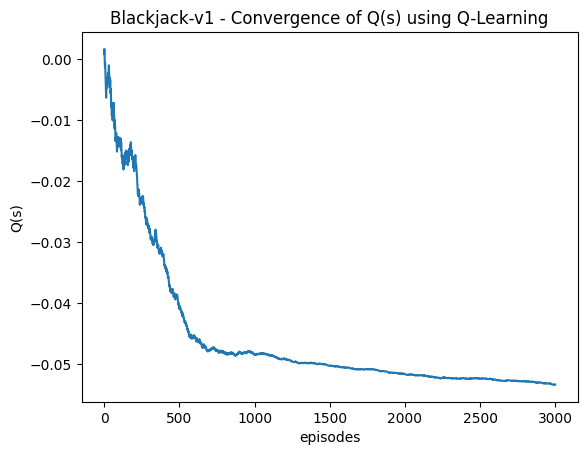

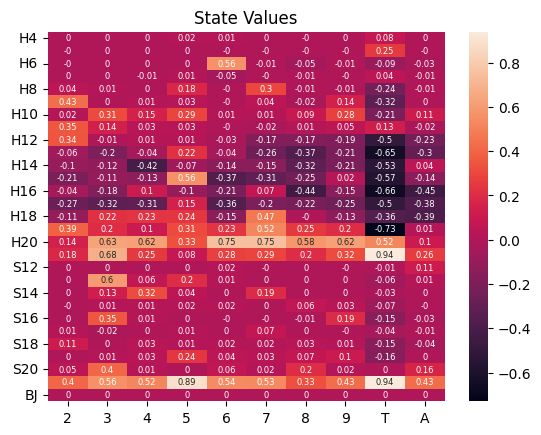

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick  stick  stick    hit    hit    hit  stick  stick
H5     hit    hit    hit    hit    hit    hit    hit    hit  stick    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit  stick    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8   stick    hit  stick  stick    hit  stick    hit    hit    hit    hit
H9   stick    hit    hit  stick    hit    hit    hit  stick    hit    hit
H10    hit  stick  stick    hit    hit    hit    hit    hit    hit  stick
H11  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit  stick    hit  stick    hit    hit  stick    hit
H14  stick    hit    hit    hit  stick    hit    hit    hit    hit  stick
H15  stick    hit    hit  stick    hit    hit    hit  stick    hit    hit
H16  stick  stick  stick  stick  stick

runtime = 0.77 seconds


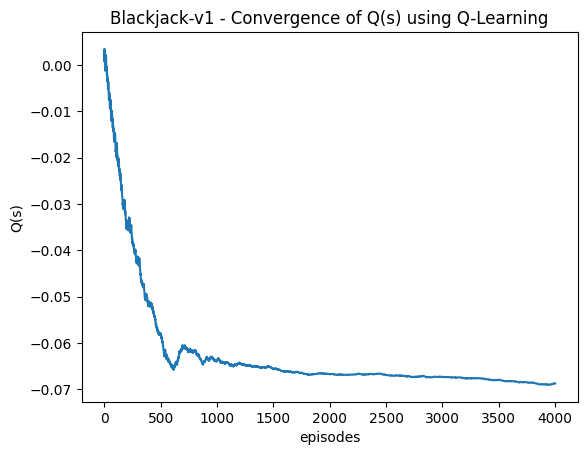

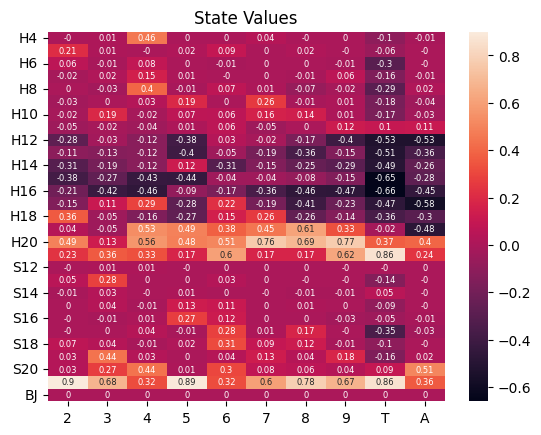

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick    hit  stick    hit  stick    hit    hit
H5   stick  stick    hit    hit  stick    hit  stick    hit    hit    hit
H6   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit  stick  stick    hit    hit    hit    hit  stick    hit
H8     hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H9     hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H10    hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H12    hit    hit  stick  stick    hit  stick    hit    hit  stick    hit
H13    hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H14  stick  stick  stick  stick    hit    hit  stick    hit    hit    hit
H15    hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H16    hit  stick  stick  stick  stick

runtime = 0.90 seconds


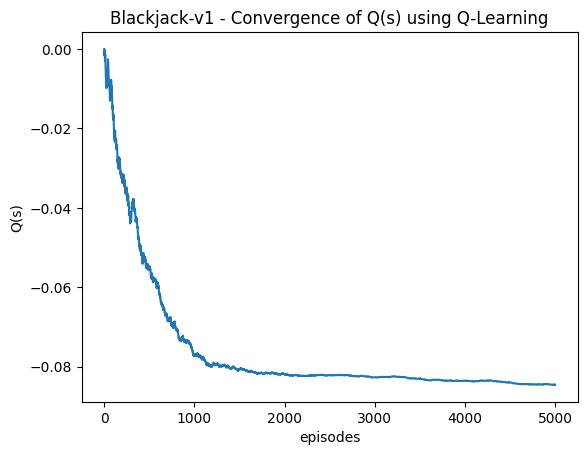

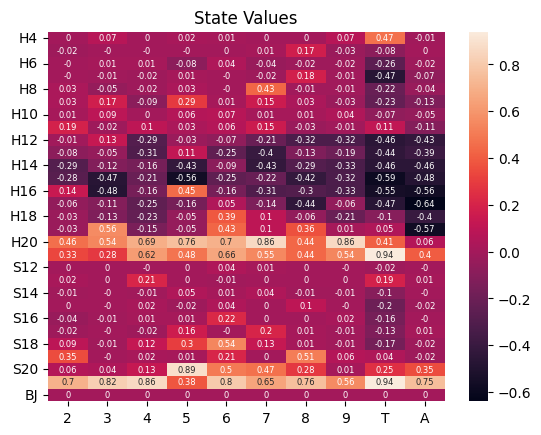

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit  stick  stick    hit    hit  stick  stick    hit
H5     hit  stick    hit    hit    hit    hit  stick    hit  stick  stick
H6     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H8     hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H9     hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit    hit    hit    hit  stick    hit    hit    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit  stick    hit  stick    hit  stick    hit  stick
H14    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H15  stick  stick  stick    hit  stick    hit    hit    hit    hit    hit
H16  stick  stick  stick  stick  stick

runtime = 1.85 seconds


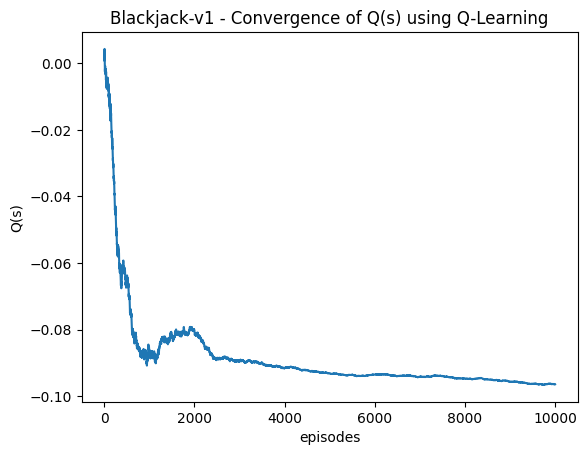

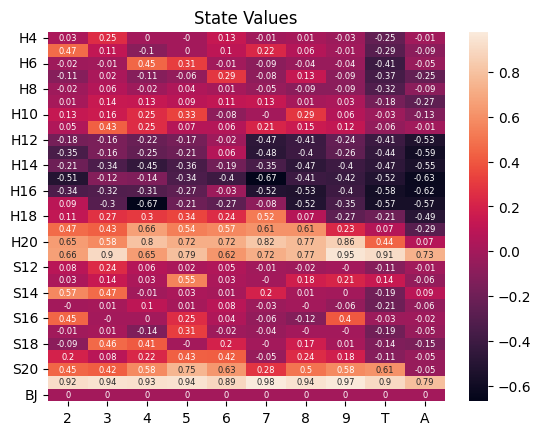

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick    hit  stick    hit  stick    hit    hit    hit
H5   stick  stick    hit    hit  stick  stick  stick    hit    hit    hit
H6     hit    hit  stick  stick    hit    hit    hit    hit    hit  stick
H7     hit    hit    hit    hit  stick    hit  stick  stick    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H13    hit  stick  stick    hit  stick  stick    hit    hit    hit    hit
H14  stick  stick  stick    hit  stick    hit    hit    hit  stick    hit
H15    hit  stick  stick    hit    hit  stick    hit    hit    hit  stick
H16  stick    hit  stick  stick  stick

runtime = 5.87 seconds


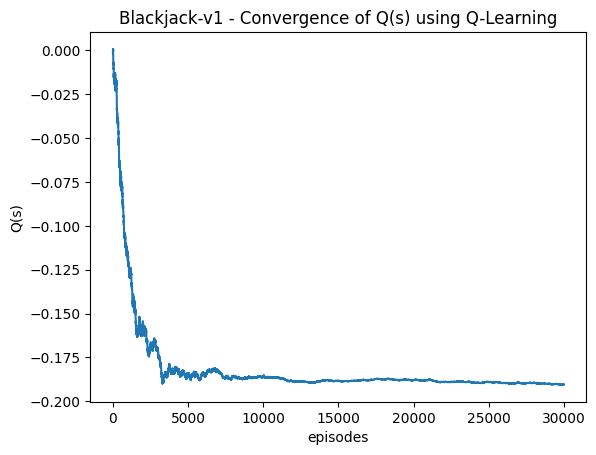

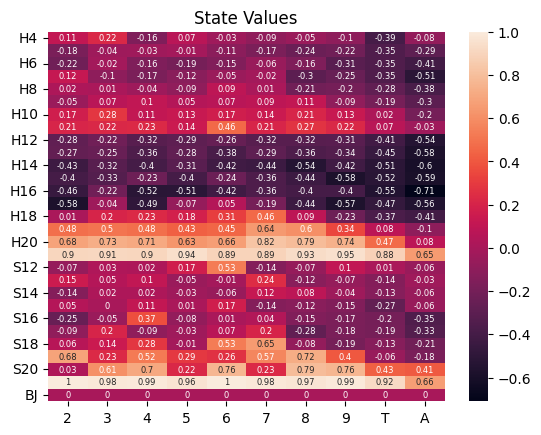

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H7   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit    hit    hit  stick  stick    hit    hit    hit
H15    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H16    hit  stick    hit    hit    hit

runtime = 11.47 seconds


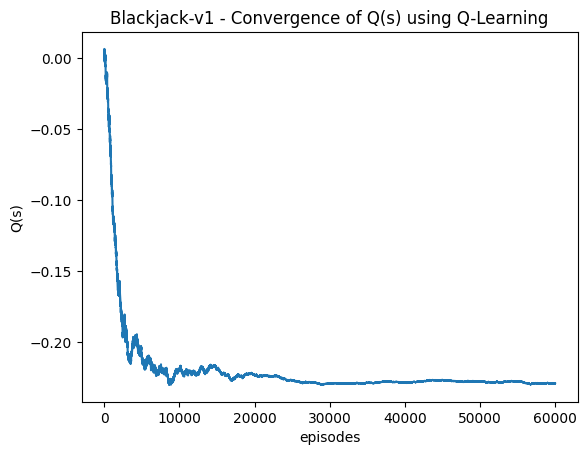

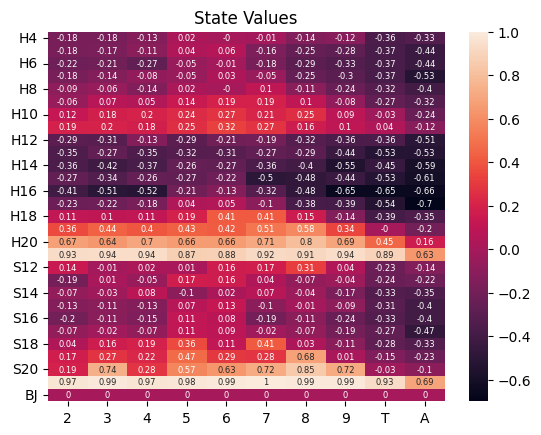

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit  stick    hit    hit    hit  stick    hit    hit
H15  stick    hit    hit  stick  stick  stick    hit  stick    hit    hit
H16    hit    hit    hit  stick  stick

runtime = 17.33 seconds


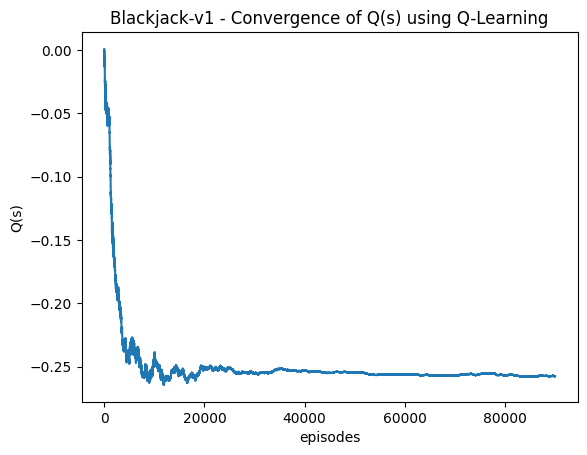

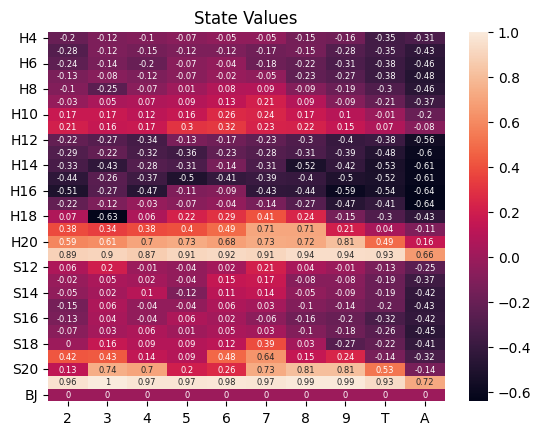

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit  stick    hit    hit    hit    hit    hit
H14    hit    hit  stick    hit  stick    hit  stick    hit    hit    hit
H15    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H16    hit  stick    hit  stick  stick

runtime = 0.10 seconds


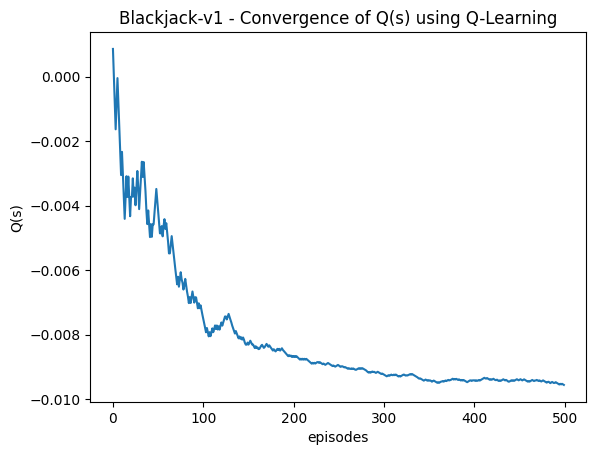

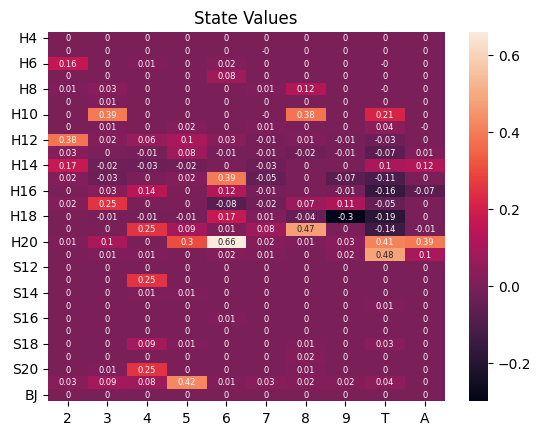

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit  stick  stick  stick  stick  stick    hit
H5     hit  stick  stick    hit    hit    hit  stick  stick    hit    hit
H6   stick  stick  stick    hit  stick  stick  stick    hit    hit  stick
H7     hit  stick    hit    hit  stick    hit  stick  stick    hit    hit
H8   stick  stick    hit  stick    hit  stick  stick    hit    hit    hit
H9     hit  stick  stick  stick    hit    hit    hit  stick    hit    hit
H10    hit  stick  stick    hit  stick    hit  stick    hit  stick    hit
H11    hit  stick    hit  stick    hit  stick    hit    hit    hit    hit
H12  stick  stick  stick  stick  stick    hit  stick    hit    hit    hit
H13  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick    hit  stick    hit    hit    hit  stick  stick  stick  stick
H15  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H16    hit  stick  stick    hit  stick

runtime = 0.19 seconds


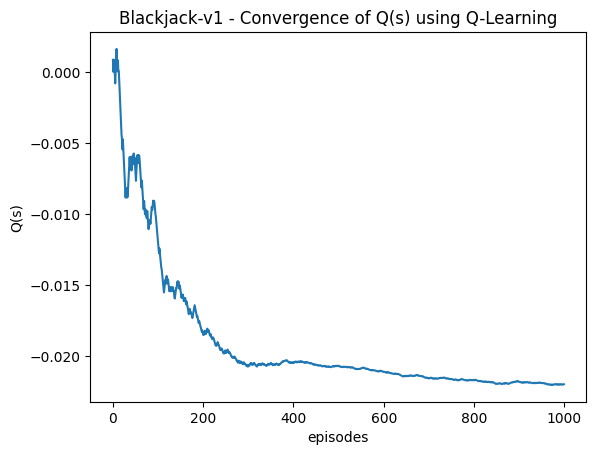

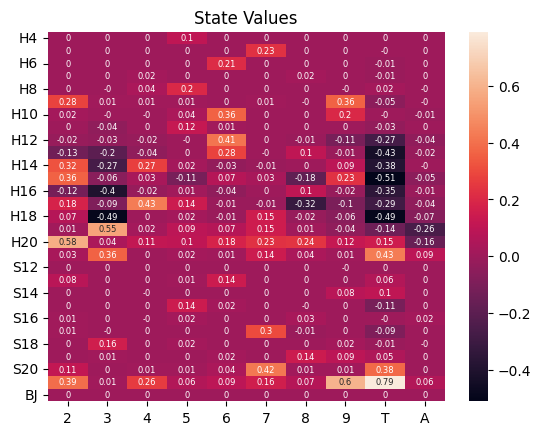

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit  stick  stick  stick    hit  stick    hit    hit
H5     hit    hit    hit    hit  stick  stick  stick    hit    hit  stick
H6   stick  stick    hit  stick  stick    hit    hit  stick    hit  stick
H7     hit  stick  stick    hit    hit    hit    hit  stick    hit    hit
H8   stick    hit  stick  stick    hit  stick    hit    hit  stick    hit
H9   stick    hit  stick    hit    hit  stick    hit  stick    hit    hit
H10    hit    hit    hit  stick  stick  stick    hit  stick    hit    hit
H11    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit  stick    hit    hit    hit    hit  stick
H13    hit    hit    hit    hit  stick    hit  stick    hit  stick    hit
H14  stick    hit  stick  stick    hit    hit    hit  stick  stick    hit
H15  stick  stick  stick  stick  stick  stick    hit  stick  stick    hit
H16    hit    hit  stick  stick    hit

runtime = 0.42 seconds


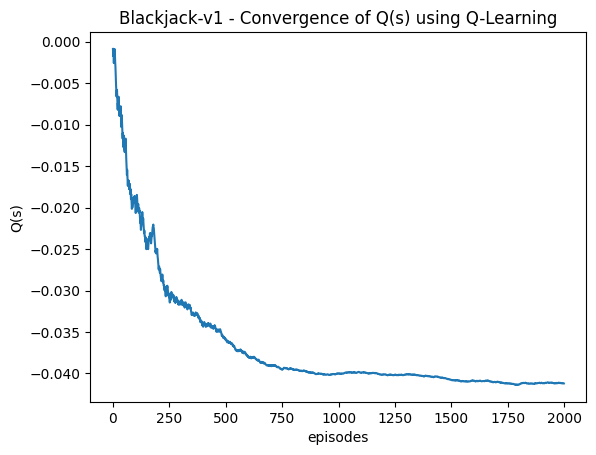

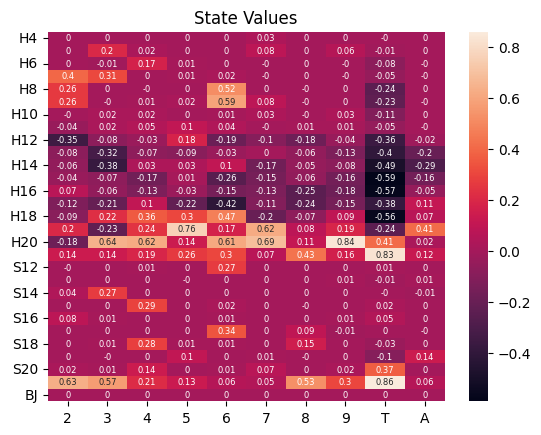

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick  stick  stick  stick  stick
H5   stick  stick  stick    hit    hit    hit    hit  stick    hit    hit
H6     hit    hit  stick    hit    hit    hit  stick    hit    hit    hit
H7   stick  stick  stick  stick  stick    hit    hit    hit    hit    hit
H8   stick    hit    hit    hit  stick  stick    hit    hit    hit    hit
H9   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H12    hit    hit  stick  stick    hit    hit  stick    hit    hit    hit
H13    hit  stick    hit    hit    hit  stick    hit  stick    hit  stick
H14  stick    hit  stick  stick  stick    hit    hit    hit    hit  stick
H15  stick    hit  stick  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick    hit    hit    hit

runtime = 0.54 seconds


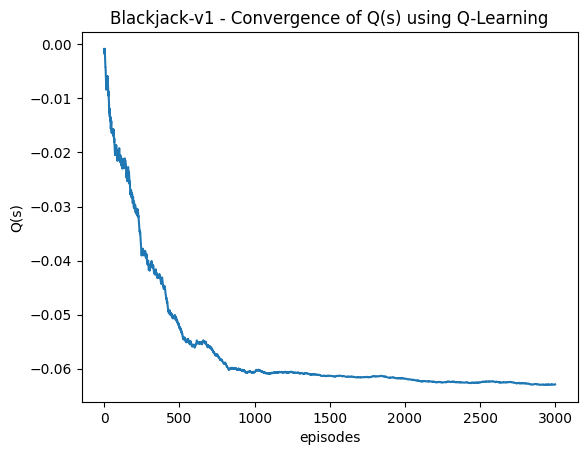

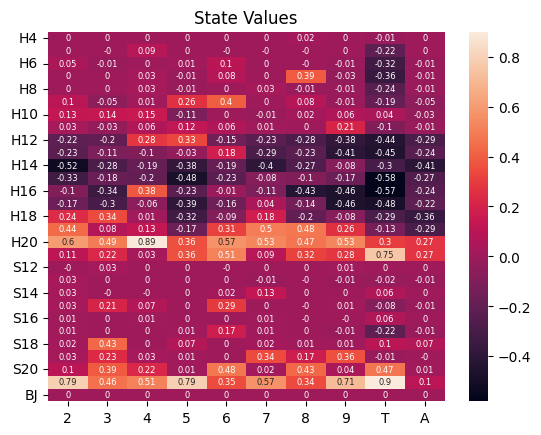

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit  stick  stick    hit    hit
H5     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit  stick    hit  stick    hit    hit    hit
H8     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H9     hit    hit    hit  stick  stick    hit  stick    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H14    hit    hit  stick    hit  stick    hit    hit    hit  stick    hit
H15  stick  stick    hit    hit    hit  stick    hit    hit    hit    hit
H16  stick  stick  stick    hit  stick

runtime = 0.70 seconds


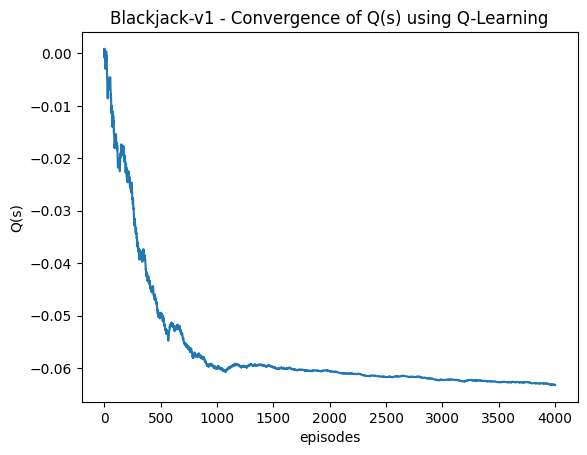

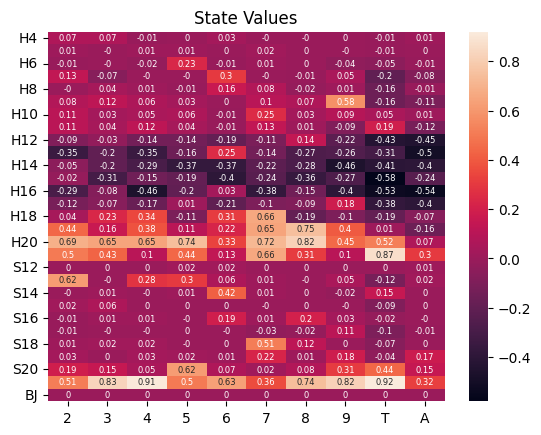

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick    hit    hit  stick    hit    hit  stick    hit  stick
H5     hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H6     hit  stick    hit  stick    hit  stick    hit    hit    hit    hit
H7   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H9     hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H10    hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit  stick  stick    hit    hit
H13    hit    hit  stick    hit  stick    hit    hit  stick    hit  stick
H14  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H15  stick  stick    hit    hit  stick    hit    hit  stick  stick  stick
H16  stick  stick  stick    hit  stick

runtime = 0.90 seconds


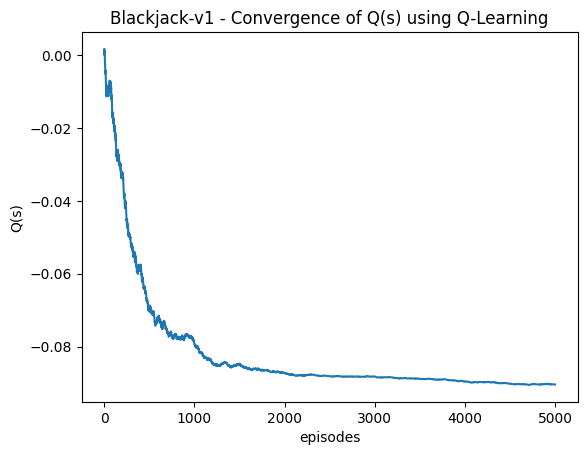

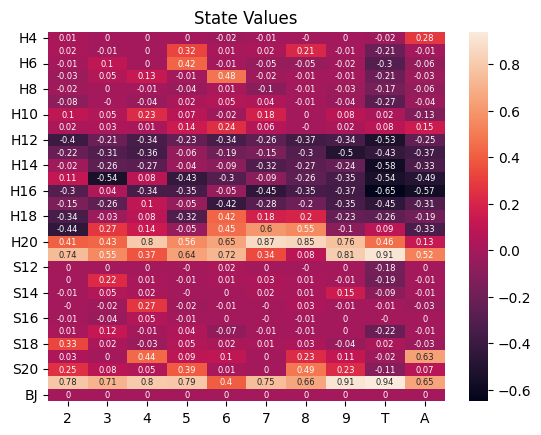

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit    hit    hit    hit    hit    hit    hit  stick
H5     hit    hit    hit  stick    hit    hit  stick    hit    hit    hit
H6     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H7     hit  stick  stick    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit  stick    hit    hit
H11    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick  stick    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick    hit    hit  stick  stick  stick  stick    hit  stick    hit
H15  stick    hit  stick  stick    hit    hit  stick    hit    hit  stick
H16    hit  stick  stick  stick  stick

runtime = 1.87 seconds


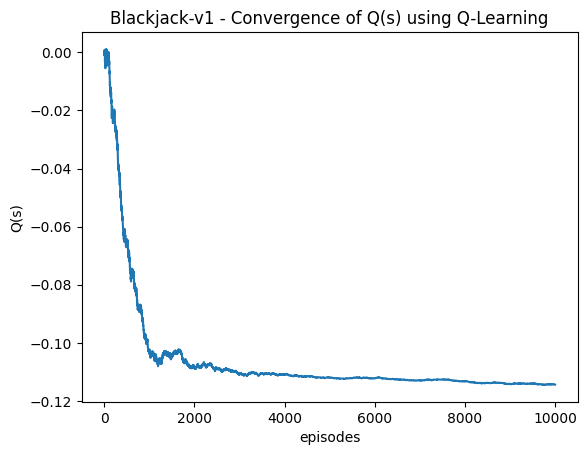

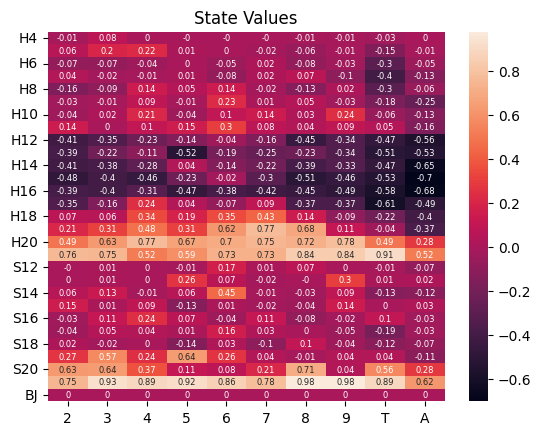

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H5   stick  stick  stick  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H8     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit    hit  stick
H13  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H15    hit  stick  stick  stick  stick    hit    hit  stick    hit    hit
H16  stick  stick    hit  stick  stick

runtime = 6.08 seconds


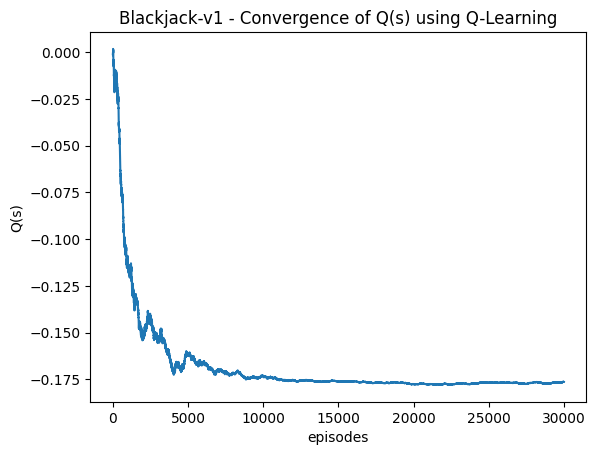

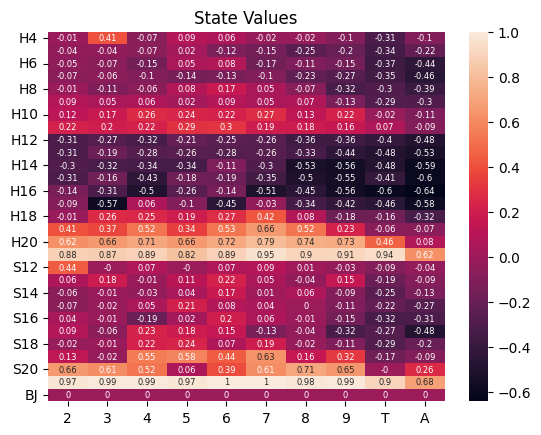

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H7     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14  stick    hit    hit    hit  stick    hit  stick  stick    hit    hit
H15  stick  stick    hit  stick  stick    hit  stick    hit    hit    hit
H16  stick  stick    hit  stick  stick

runtime = 11.48 seconds


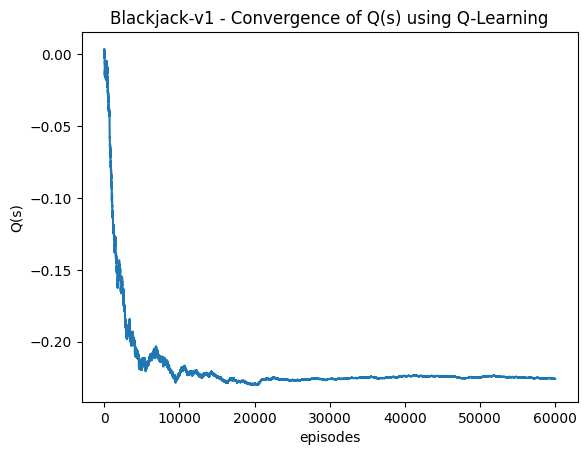

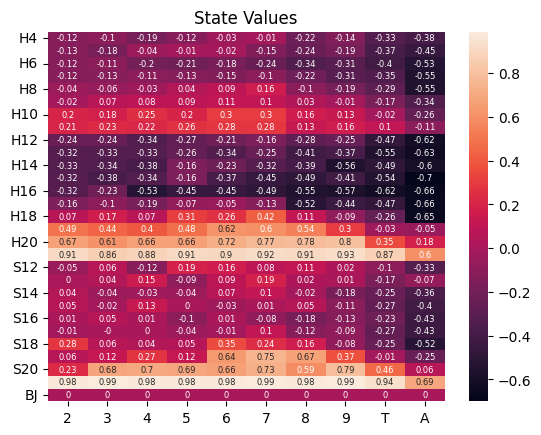

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit  stick  stick    hit    hit  stick    hit    hit
H15  stick  stick  stick  stick    hit  stick    hit    hit    hit    hit
H16  stick  stick    hit    hit    hit

runtime = 18.08 seconds


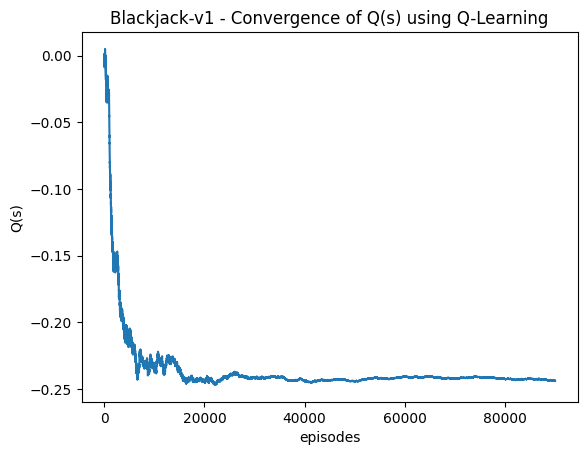

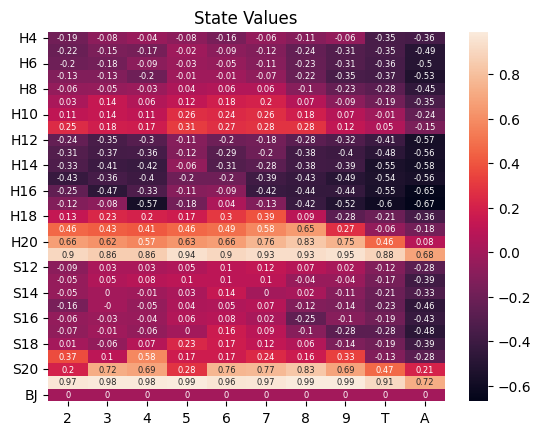

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H15    hit  stick    hit  stick  stick    hit    hit    hit    hit    hit
H16  stick    hit  stick  stick  stick

runtime = 0.11 seconds


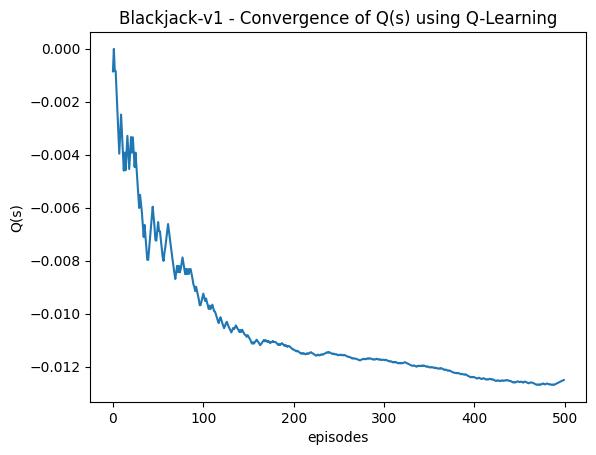

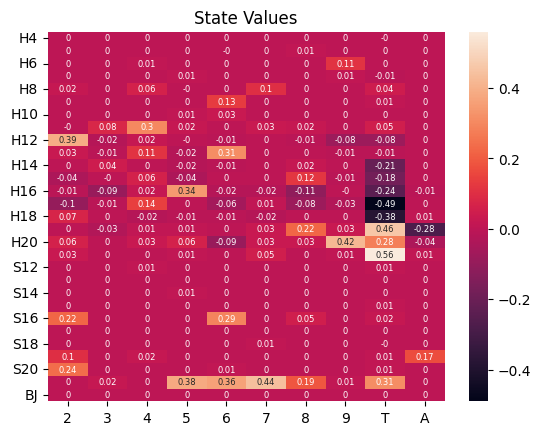

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit  stick  stick  stick  stick    hit  stick
H5   stick  stick  stick  stick    hit  stick  stick  stick  stick  stick
H6   stick    hit  stick    hit    hit  stick  stick  stick    hit  stick
H7   stick  stick  stick  stick    hit    hit  stick  stick    hit    hit
H8   stick  stick  stick    hit  stick  stick  stick  stick  stick  stick
H9   stick    hit    hit    hit  stick    hit    hit    hit  stick  stick
H10    hit    hit    hit  stick    hit  stick  stick    hit    hit    hit
H11    hit  stick  stick  stick  stick  stick  stick    hit    hit  stick
H12  stick    hit  stick    hit    hit    hit  stick    hit    hit  stick
H13  stick    hit  stick  stick  stick    hit    hit    hit    hit    hit
H14    hit  stick    hit    hit  stick    hit  stick  stick    hit  stick
H15    hit    hit  stick    hit  stick    hit  stick  stick  stick    hit
H16    hit    hit  stick  stick    hit

runtime = 0.20 seconds


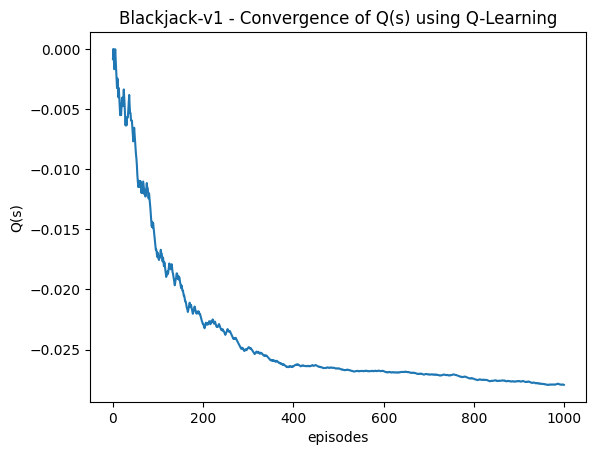

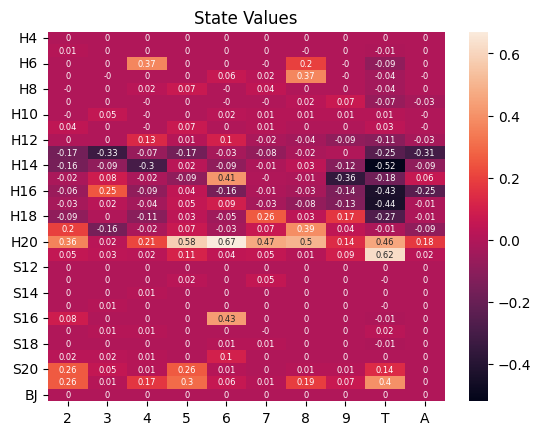

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick    hit  stick  stick  stick  stick    hit
H5   stick    hit  stick  stick    hit    hit    hit    hit    hit  stick
H6     hit    hit  stick    hit  stick    hit  stick    hit    hit    hit
H7     hit    hit    hit    hit  stick  stick  stick    hit    hit    hit
H8     hit    hit  stick  stick    hit  stick  stick    hit    hit    hit
H9   stick    hit    hit    hit    hit    hit    hit  stick    hit    hit
H10    hit  stick    hit    hit  stick  stick    hit  stick    hit    hit
H11  stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H13    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick  stick    hit    hit  stick    hit    hit    hit
H15  stick  stick    hit    hit  stick    hit    hit    hit    hit  stick
H16    hit  stick    hit  stick    hit

runtime = 0.37 seconds


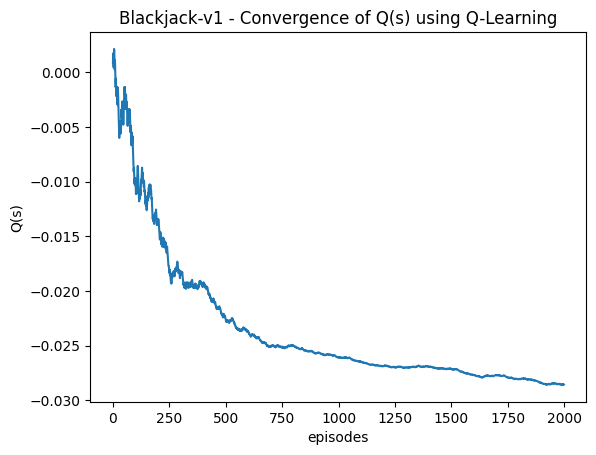

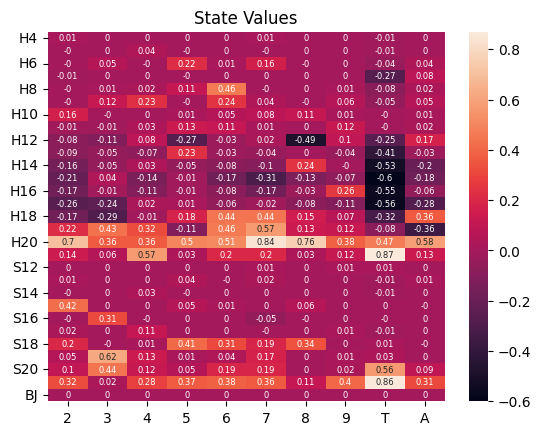

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick    hit  stick  stick  stick    hit    hit    hit
H5     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H6     hit  stick    hit  stick  stick  stick    hit    hit    hit  stick
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H8     hit    hit  stick  stick  stick    hit  stick    hit    hit    hit
H9     hit    hit  stick    hit  stick  stick    hit  stick    hit  stick
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick  stick  stick    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14    hit  stick  stick    hit    hit    hit  stick    hit    hit    hit
H15  stick  stick    hit  stick    hit  stick    hit    hit    hit    hit
H16    hit    hit    hit  stick    hit

runtime = 0.55 seconds


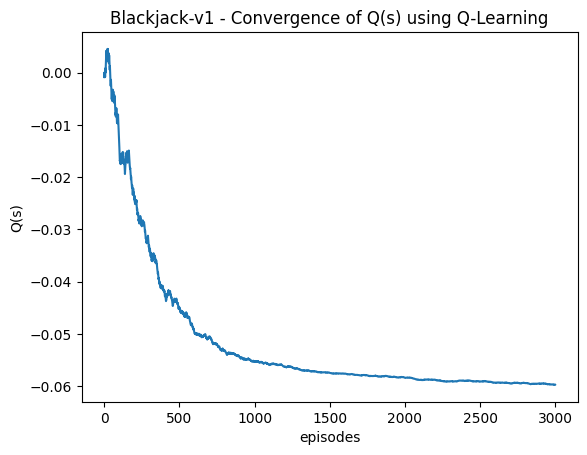

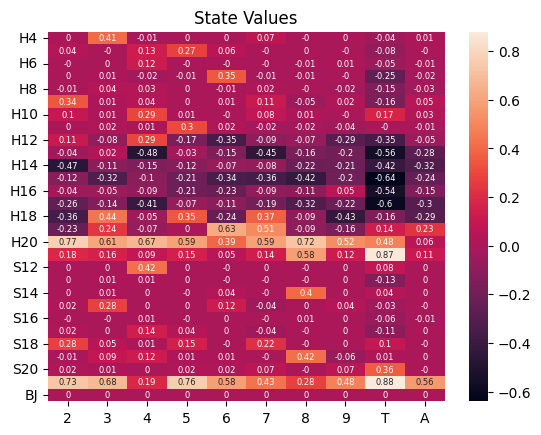

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit    hit  stick    hit  stick    hit  stick
H5     hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H6     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H7     hit  stick    hit    hit  stick    hit    hit    hit  stick    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H10  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H12  stick    hit  stick    hit    hit    hit    hit  stick  stick    hit
H13  stick  stick  stick  stick  stick  stick    hit    hit  stick    hit
H14    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H15    hit  stick    hit  stick    hit    hit    hit    hit    hit  stick
H16    hit  stick  stick  stick    hit

runtime = 0.74 seconds


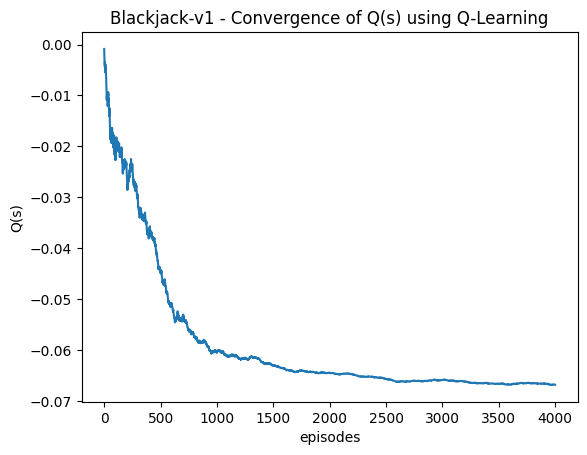

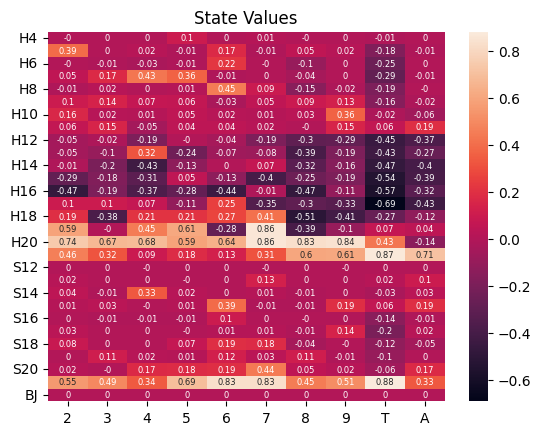

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick  stick  stick  stick    hit    hit    hit    hit
H5   stick    hit  stick    hit  stick    hit  stick  stick    hit    hit
H6     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H7   stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit  stick  stick    hit    hit    hit    hit
H9     hit  stick    hit    hit    hit    hit  stick    hit    hit    hit
H10  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick  stick    hit    hit    hit    hit    hit  stick    hit    hit
H13    hit    hit  stick  stick  stick    hit    hit    hit    hit    hit
H14  stick  stick    hit    hit  stick    hit    hit    hit    hit    hit
H15    hit  stick    hit  stick  stick  stick  stick  stick    hit    hit
H16    hit  stick  stick  stick    hit

runtime = 0.90 seconds


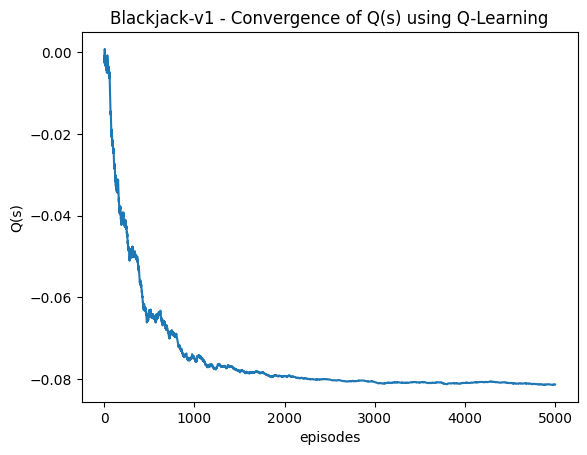

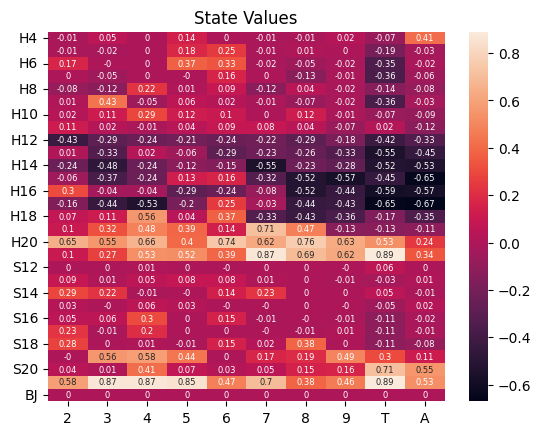

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick  stick    hit    hit  stick    hit  stick
H5     hit    hit    hit  stick  stick    hit    hit  stick    hit    hit
H6   stick    hit    hit  stick  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H9     hit  stick    hit  stick  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H11    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit  stick  stick    hit    hit    hit    hit  stick    hit
H14    hit  stick    hit  stick    hit  stick    hit  stick    hit    hit
H15  stick    hit    hit  stick  stick    hit  stick    hit  stick    hit
H16  stick  stick  stick  stick    hit

runtime = 1.86 seconds


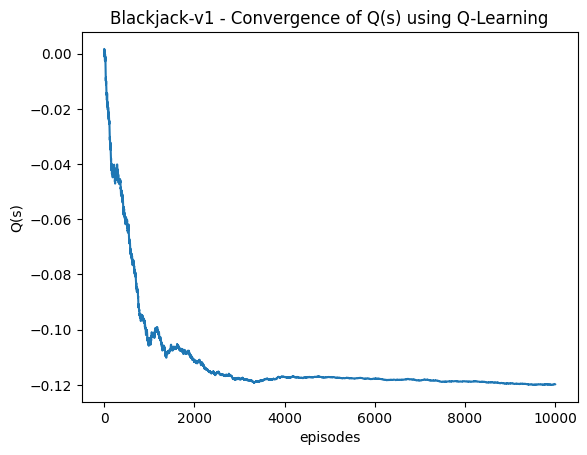

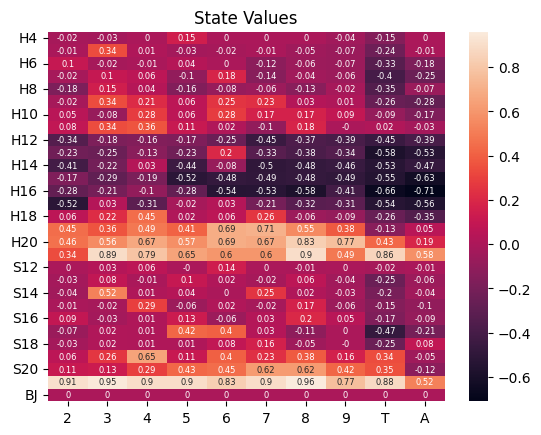

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H5     hit  stick    hit    hit    hit    hit    hit    hit  stick    hit
H6   stick    hit    hit  stick    hit    hit    hit    hit    hit    hit
H7   stick    hit    hit    hit  stick    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H13    hit    hit    hit  stick  stick  stick    hit  stick    hit    hit
H14    hit  stick  stick    hit  stick    hit    hit  stick    hit    hit
H15  stick    hit  stick    hit    hit    hit    hit  stick    hit    hit
H16  stick  stick  stick  stick    hit

runtime = 5.96 seconds


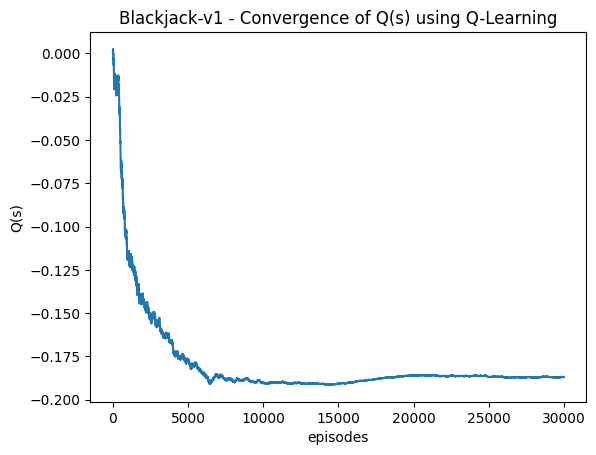

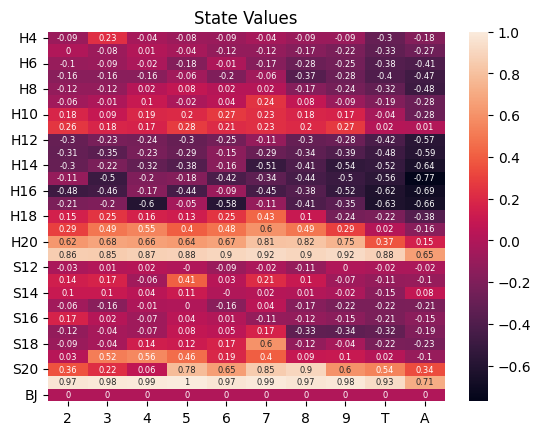

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H5   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H14  stick  stick    hit    hit  stick  stick    hit  stick    hit    hit
H15  stick    hit  stick  stick    hit    hit    hit    hit    hit  stick
H16    hit    hit  stick    hit  stick

runtime = 12.03 seconds


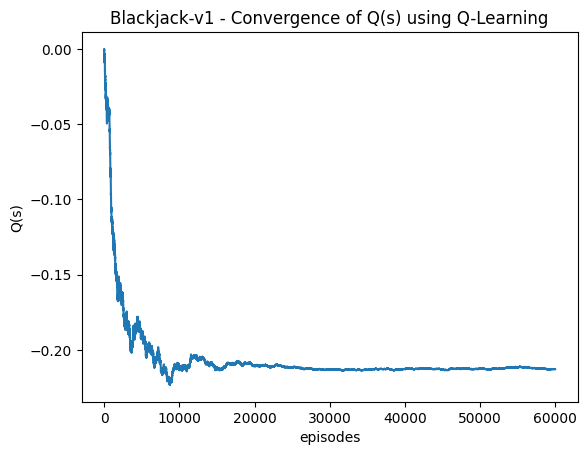

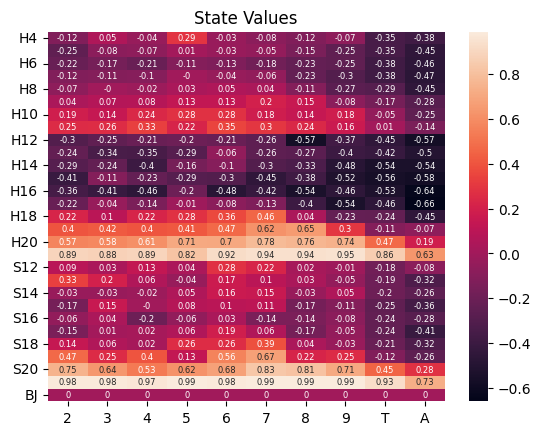

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H13    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H14    hit  stick    hit  stick  stick    hit    hit    hit    hit    hit
H15    hit  stick  stick  stick  stick    hit    hit    hit    hit    hit
H16  stick    hit    hit  stick    hit

runtime = 17.74 seconds


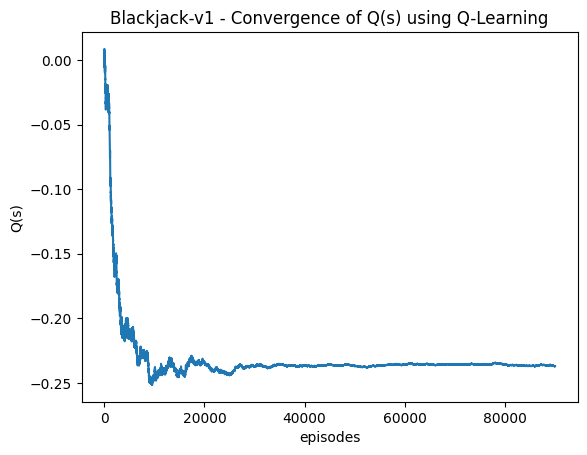

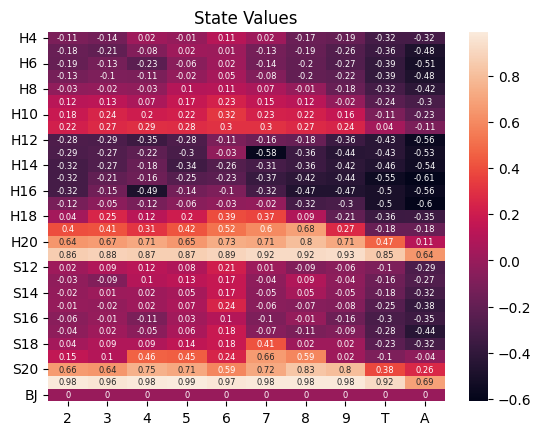

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit  stick    hit  stick  stick    hit    hit    hit    hit
H14    hit  stick  stick    hit  stick    hit    hit    hit    hit    hit
H15    hit  stick  stick  stick  stick    hit    hit    hit    hit    hit
H16  stick  stick    hit  stick  stick

runtime = 0.09 seconds


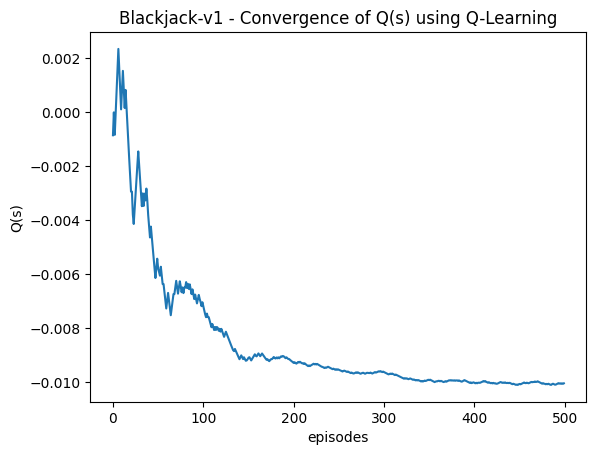

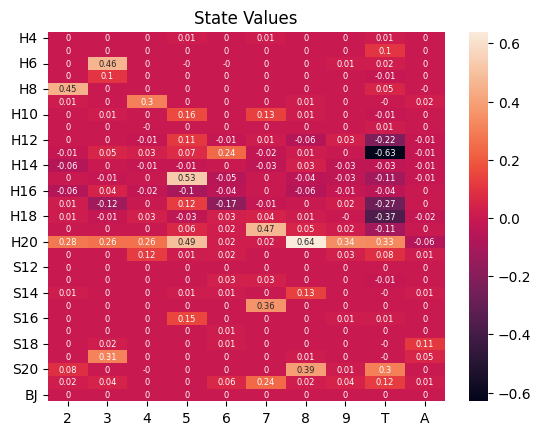

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick  stick  stick  stick    hit
H5   stick  stick  stick  stick  stick  stick    hit  stick  stick  stick
H6     hit  stick  stick    hit    hit  stick  stick  stick  stick    hit
H7     hit  stick  stick  stick  stick  stick    hit    hit  stick  stick
H8   stick    hit  stick  stick    hit    hit  stick    hit  stick    hit
H9   stick    hit  stick    hit    hit    hit  stick    hit    hit  stick
H10    hit  stick    hit  stick    hit  stick    hit    hit    hit    hit
H11    hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H12    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit  stick  stick  stick  stick    hit    hit    hit  stick  stick
H14    hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H15    hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H16    hit  stick    hit    hit    hit

runtime = 0.19 seconds


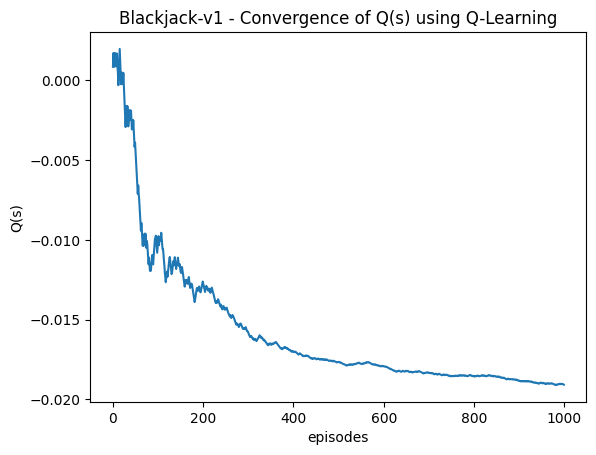

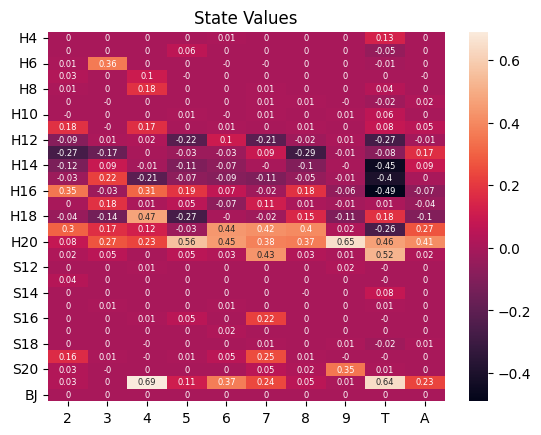

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick  stick  stick  stick  stick    hit  stick    hit
H5     hit    hit    hit  stick    hit  stick    hit  stick    hit    hit
H6   stick  stick    hit  stick    hit    hit  stick    hit    hit    hit
H7   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H8   stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit  stick    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11  stick    hit  stick    hit  stick    hit  stick    hit    hit  stick
H12    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick  stick  stick    hit  stick    hit  stick
H14    hit  stick    hit    hit    hit    hit    hit    hit    hit  stick
H15  stick  stick    hit    hit    hit    hit    hit    hit    hit    hit
H16  stick    hit  stick  stick  stick

runtime = 0.35 seconds


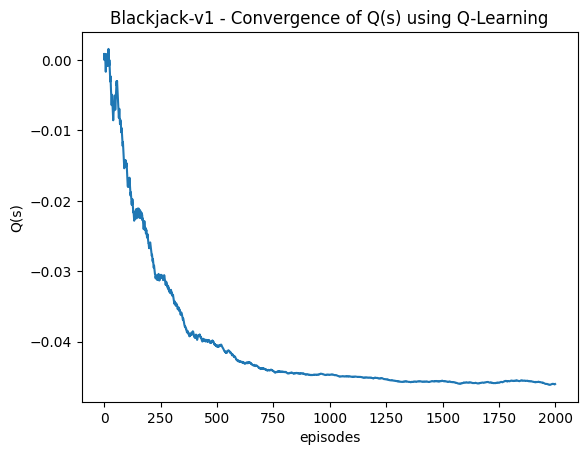

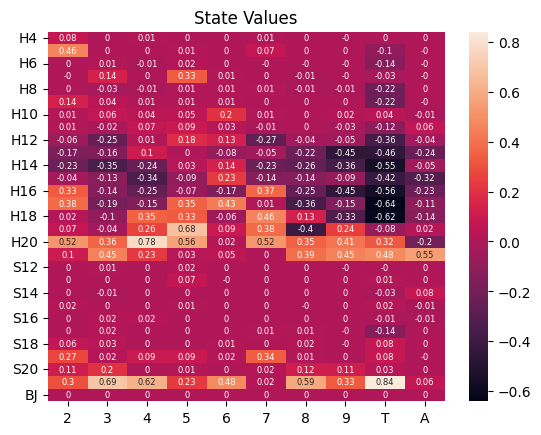

         2      3      4      5      6      7      8      9      T      A
H4   stick  stick  stick    hit  stick  stick  stick    hit    hit  stick
H5   stick  stick  stick  stick  stick  stick  stick    hit    hit    hit
H6     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H7     hit  stick    hit  stick    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9   stick  stick    hit  stick  stick    hit    hit    hit    hit    hit
H10    hit  stick  stick    hit  stick    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H12    hit    hit    hit  stick  stick    hit    hit    hit  stick    hit
H13    hit    hit  stick    hit    hit    hit    hit    hit  stick    hit
H14    hit  stick    hit    hit  stick    hit    hit    hit  stick    hit
H15    hit    hit    hit  stick  stick  stick  stick    hit  stick    hit
H16  stick  stick  stick    hit    hit

runtime = 0.54 seconds


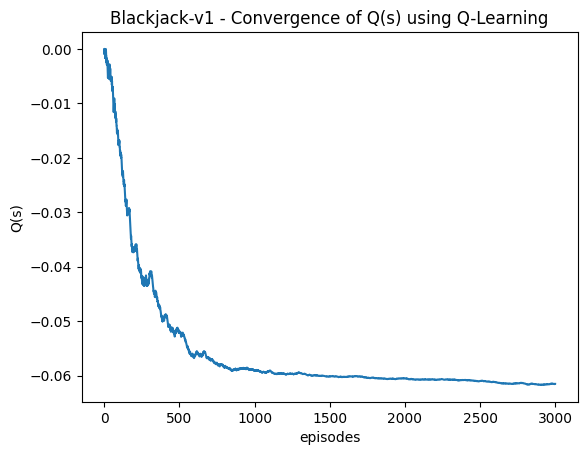

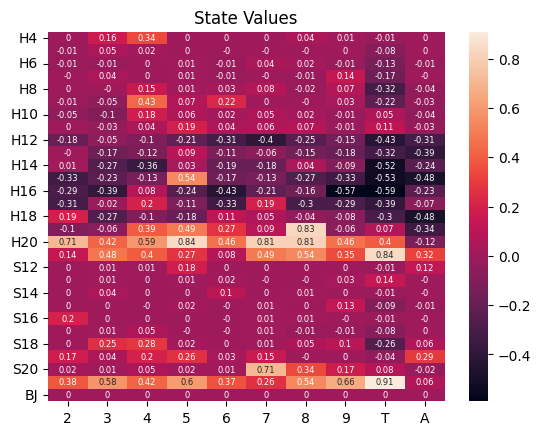

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick  stick  stick  stick    hit  stick  stick    hit    hit
H5     hit  stick  stick  stick    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit  stick    hit  stick  stick    hit    hit    hit
H7     hit  stick    hit    hit    hit    hit    hit  stick    hit    hit
H8     hit    hit  stick    hit  stick    hit    hit  stick    hit    hit
H9     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit  stick  stick    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit  stick    hit    hit
H13    hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H14  stick    hit    hit    hit    hit    hit    hit    hit    hit  stick
H15  stick    hit    hit  stick    hit    hit    hit  stick    hit    hit
H16    hit  stick  stick  stick    hit

runtime = 0.72 seconds


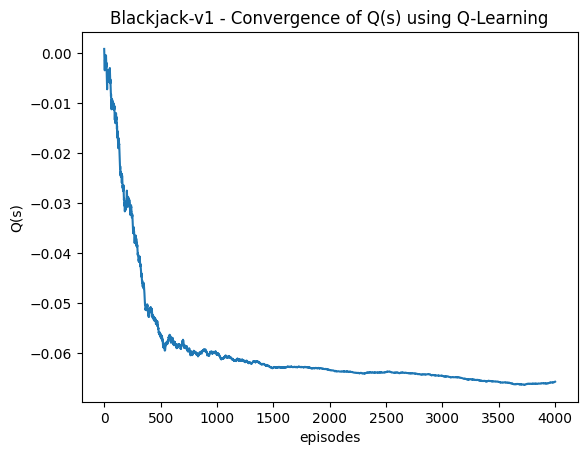

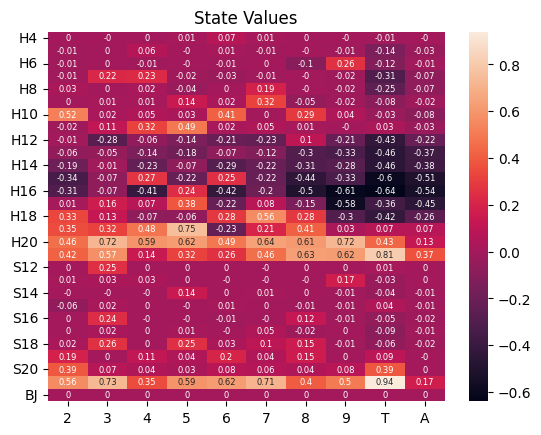

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit    hit  stick  stick    hit  stick    hit    hit    hit
H5     hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H7     hit  stick  stick    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit  stick  stick    hit    hit    hit
H9     hit    hit    hit  stick    hit  stick    hit    hit    hit    hit
H10  stick    hit    hit    hit  stick    hit    hit  stick    hit    hit
H11    hit    hit  stick  stick    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit  stick  stick    hit    hit    hit    hit
H13  stick    hit    hit    hit  stick  stick    hit    hit    hit    hit
H14  stick  stick    hit  stick    hit    hit    hit  stick    hit    hit
H15    hit    hit  stick    hit  stick  stick    hit    hit    hit    hit
H16  stick  stick    hit  stick  stick

runtime = 0.93 seconds


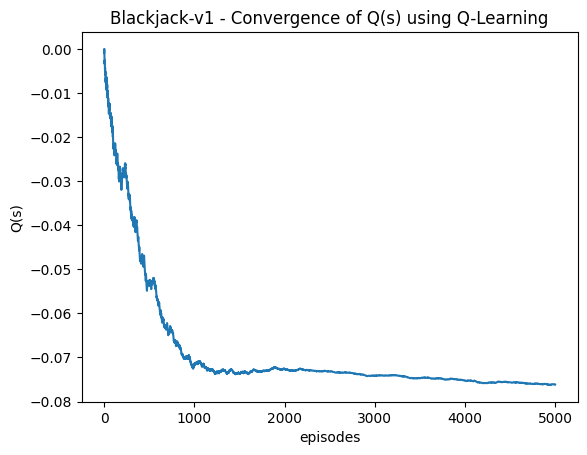

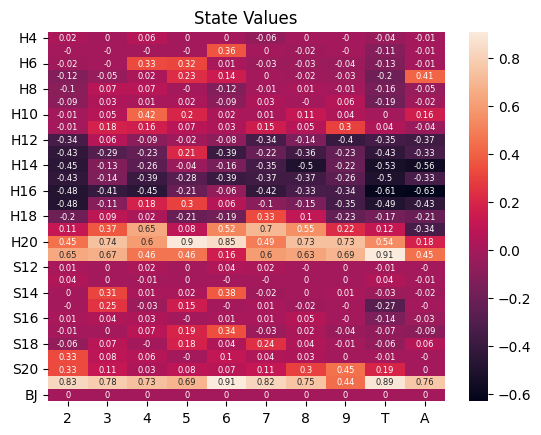

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick  stick    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit  stick    hit    hit    hit    hit    hit
H6   stick    hit  stick  stick  stick    hit    hit    hit    hit    hit
H7     hit    hit    hit  stick  stick    hit    hit    hit    hit  stick
H8     hit  stick  stick    hit    hit    hit    hit    hit    hit    hit
H9     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit  stick    hit    hit    hit  stick    hit    hit  stick
H11    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H12  stick  stick    hit  stick    hit    hit    hit    hit    hit    hit
H13    hit    hit    hit  stick  stick    hit    hit  stick    hit  stick
H14    hit  stick    hit    hit    hit    hit  stick    hit    hit    hit
H15    hit    hit    hit    hit    hit  stick    hit    hit    hit    hit
H16    hit    hit    hit  stick  stick

runtime = 1.78 seconds


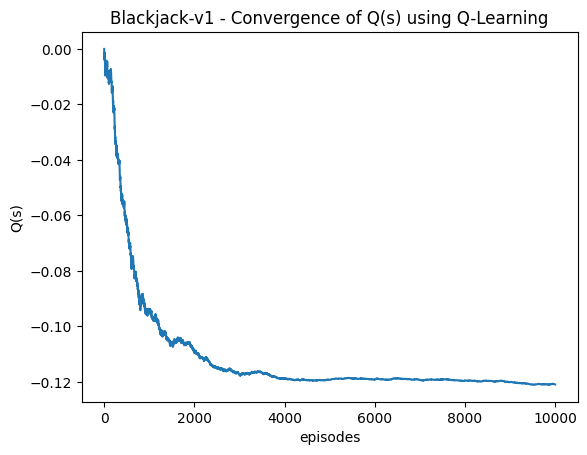

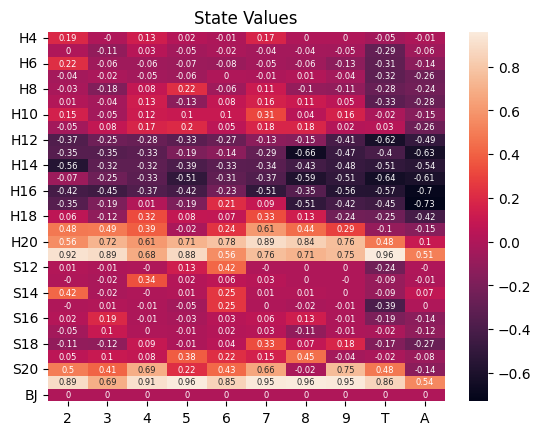

         2      3      4      5      6      7      8      9      T      A
H4   stick    hit  stick    hit    hit  stick    hit    hit    hit    hit
H5     hit    hit  stick    hit    hit    hit    hit    hit    hit  stick
H6   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit  stick    hit  stick    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit    hit    hit    hit    hit  stick    hit
H13    hit    hit    hit  stick  stick  stick  stick    hit    hit    hit
H14    hit  stick    hit    hit    hit    hit  stick  stick    hit    hit
H15  stick  stick    hit    hit  stick    hit  stick    hit  stick    hit
H16  stick    hit    hit  stick  stick

runtime = 5.50 seconds


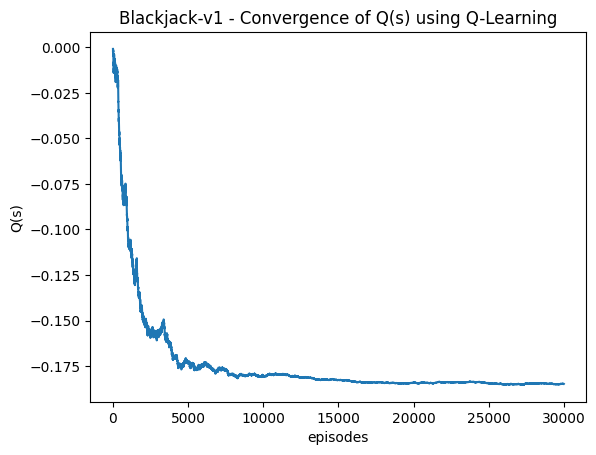

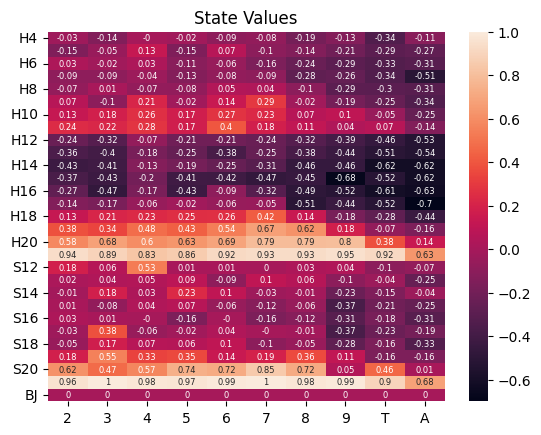

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit  stick    hit  stick    hit  stick    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit  stick
H7   stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12    hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit  stick    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick  stick    hit    hit    hit    hit  stick    hit
H15    hit    hit  stick    hit    hit  stick    hit  stick    hit    hit
H16  stick    hit  stick    hit  stick

runtime = 11.19 seconds


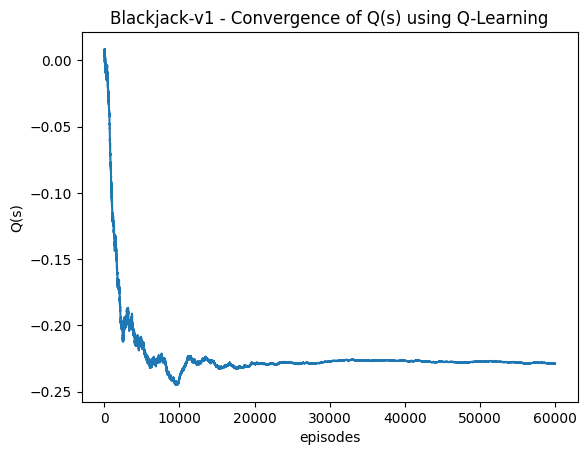

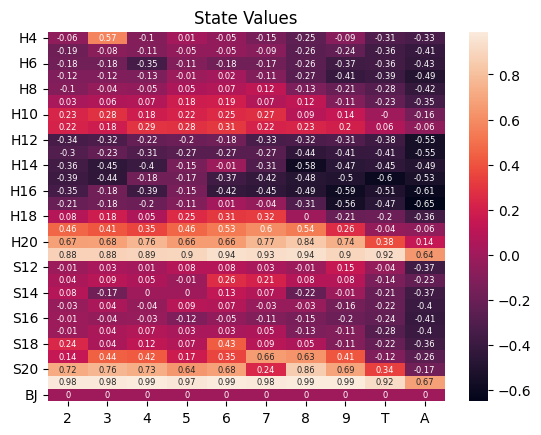

         2      3      4      5      6      7      8      9      T      A
H4     hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit  stick    hit    hit
H6     hit    hit  stick    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13    hit  stick    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit    hit  stick  stick    hit  stick    hit    hit    hit
H15    hit    hit  stick  stick    hit    hit  stick    hit    hit    hit
H16  stick  stick    hit  stick    hit

runtime = 16.94 seconds


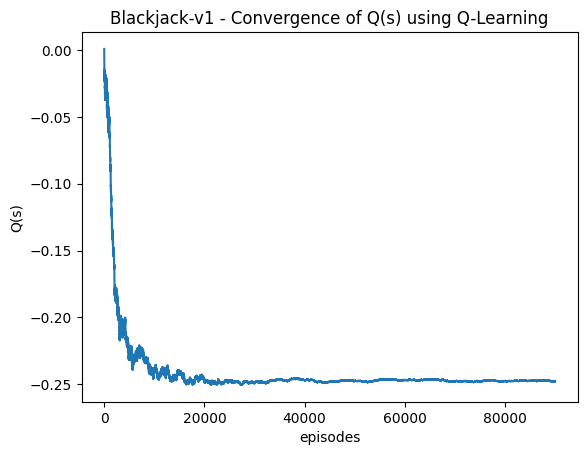

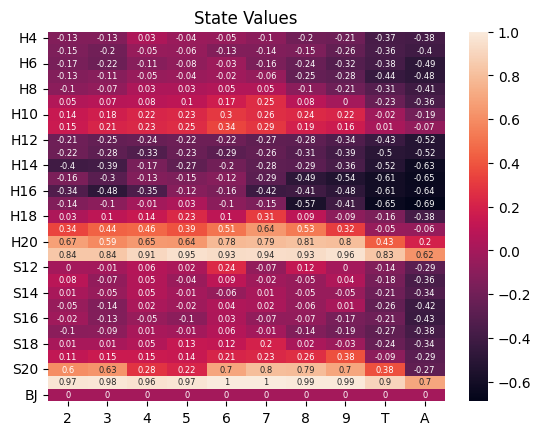

         2      3      4      5      6      7      8      9      T      A
H4     hit    hit    hit  stick    hit    hit    hit    hit    hit    hit
H5     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H6     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H7     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H8     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H9     hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H10    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H11    hit    hit    hit    hit    hit    hit    hit    hit    hit    hit
H12  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H13  stick    hit    hit    hit    hit    hit    hit    hit    hit    hit
H14    hit    hit  stick    hit  stick    hit    hit    hit    hit    hit
H15  stick  stick  stick  stick  stick    hit    hit  stick    hit    hit
H16  stick    hit  stick  stick  stick

In [6]:
EPSILON_DECAY = [.4, .7, .9]
ITERS = [500, 1000, 2000, 3000, 4000, 5000, 10000, 30000, 60000, 90000,
        500, 1000, 2000, 3000, 4000, 5000, 10000, 30000, 60000, 90000,
        500, 1000, 2000, 3000, 4000, 5000, 10000, 30000, 60000, 90000,
        500, 1000, 2000, 3000, 4000, 5000, 10000, 30000, 60000, 90000,
        500, 1000, 2000, 3000, 4000, 5000, 10000, 30000, 60000, 90000]
# ITERS = [30000, 30000, 30000, 30000, 30000]
result_df = grid_search_q_learn(problem_name=PROBLEM_NAME, 
                                epsilons = EPSILON_DECAY, 
                                n_episodes = ITERS, 
                                simulations = SIMULATIONS, 
                                algorithm = 'Q-Learning')

In [7]:
print(result_df)
result_df.to_csv('result_blackjack.csv')

     epsilon  n_episodes  total_reward  simulations  performance_score   
0        0.4       500.0         -34.0        200.0             -0.170  \
1        0.4      1000.0         -51.0        200.0             -0.255   
2        0.4      2000.0         -25.0        200.0             -0.125   
3        0.4      3000.0         -31.0        200.0             -0.155   
4        0.4      4000.0           5.0        200.0              0.025   
..       ...         ...           ...          ...                ...   
145      0.9      5000.0         -30.0        200.0             -0.150   
146      0.9     10000.0          -7.0        200.0             -0.035   
147      0.9     30000.0         -15.0        200.0             -0.075   
148      0.9     60000.0         -47.0        200.0             -0.235   
149      0.9     90000.0         -38.0        200.0             -0.190   

      run_time  
0     0.090201  
1     0.219510  
2     0.371209  
3     0.566608  
4     0.742732  
..       